# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
asdp_1 = adata.X.sum()

In [7]:
ratio_true=0.91

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [8]:
asdp_2 = adata.X.sum()

In [9]:
mask.sum()/adata.shape[1],  1-asdp_2/asdp_1

(0.9102, 0.9030218869447708)

In [10]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [11]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [12]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: 392ntbrh
Name: solar-spaceship-123
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/392ntbrh
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_120414-392ntbrh/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2580,3292,9371
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2580,2515,1664,3467,1634,3383
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4487,10756
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 625,817,2368
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 625,687,444,823,415,816
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1097,2713
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:18<3:07:04, 18.74s/it]

Epoch 1/600:   0%|▎                                                                                                                                                            | 1/600 [00:18<3:07:04, 18.74s/it, v_num=rh_1, total_loss_train=554, kl_local_train=38.4]

Epoch 2/600:   0%|▎                                                                                                                                                            | 1/600 [00:18<3:07:04, 18.74s/it, v_num=rh_1, total_loss_train=554, kl_local_train=38.4]

Epoch 2/600:   0%|▌                                                                                                                                                            | 2/600 [00:31<2:31:02, 15.15s/it, v_num=rh_1, total_loss_train=554, kl_local_train=38.4]

Epoch 2/600:   0%|▌                                                                                                                                                            | 2/600 [00:31<2:31:02, 15.15s/it, v_num=rh_1, total_loss_train=333, kl_local_train=56.1]

Epoch 3/600:   0%|▌                                                                                                                                                            | 2/600 [00:31<2:31:02, 15.15s/it, v_num=rh_1, total_loss_train=333, kl_local_train=56.1]

Epoch 3/600:   0%|▊                                                                                                                                                            | 3/600 [00:43<2:18:39, 13.94s/it, v_num=rh_1, total_loss_train=333, kl_local_train=56.1]

Epoch 3/600:   0%|▊                                                                                                                                                            | 3/600 [00:43<2:18:39, 13.94s/it, v_num=rh_1, total_loss_train=314, kl_local_train=53.4]

Epoch 4/600:   0%|▊                                                                                                                                                            | 3/600 [00:43<2:18:39, 13.94s/it, v_num=rh_1, total_loss_train=314, kl_local_train=53.4]

Epoch 4/600:   1%|█                                                                                                                                                            | 4/600 [00:56<2:12:54, 13.38s/it, v_num=rh_1, total_loss_train=314, kl_local_train=53.4]

Epoch 4/600:   1%|█                                                                                                                                                            | 4/600 [00:56<2:12:54, 13.38s/it, v_num=rh_1, total_loss_train=309, kl_local_train=45.8]

Epoch 5/600:   1%|█                                                                                                                                                            | 4/600 [00:56<2:12:54, 13.38s/it, v_num=rh_1, total_loss_train=309, kl_local_train=45.8]

Epoch 5/600:   1%|█▎                                                                                                                                                           | 5/600 [01:09<2:10:00, 13.11s/it, v_num=rh_1, total_loss_train=309, kl_local_train=45.8]

Epoch 5/600:   1%|█▎                                                                                                                                                           | 5/600 [01:09<2:10:00, 13.11s/it, v_num=rh_1, total_loss_train=307, kl_local_train=36.4]

Epoch 6/600:   1%|█▎                                                                                                                                                           | 5/600 [01:10<2:10:00, 13.11s/it, v_num=rh_1, total_loss_train=307, kl_local_train=36.4]

Epoch 6/600:   1%|█▌                                                                                                                                                           | 6/600 [01:22<2:10:58, 13.23s/it, v_num=rh_1, total_loss_train=307, kl_local_train=36.4]

Epoch 6/600:   1%|▎                          | 6/600 [01:22<2:10:58, 13.23s/it, v_num=rh_1, total_loss_train=306, kl_local_train=27, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▎                          | 6/600 [01:22<2:10:58, 13.23s/it, v_num=rh_1, total_loss_train=306, kl_local_train=27, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▎                          | 7/600 [01:35<2:08:49, 13.03s/it, v_num=rh_1, total_loss_train=306, kl_local_train=27, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▎                        | 7/600 [01:35<2:08:49, 13.03s/it, v_num=rh_1, total_loss_train=305, kl_local_train=19.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                        | 7/600 [01:35<2:08:49, 13.03s/it, v_num=rh_1, total_loss_train=305, kl_local_train=19.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                        | 8/600 [01:47<2:06:06, 12.78s/it, v_num=rh_1, total_loss_train=305, kl_local_train=19.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                        | 8/600 [01:47<2:06:06, 12.78s/it, v_num=rh_1, total_loss_train=312, kl_local_train=13.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▎                        | 8/600 [01:47<2:06:06, 12.78s/it, v_num=rh_1, total_loss_train=312, kl_local_train=13.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▍                        | 9/600 [01:59<2:03:40, 12.56s/it, v_num=rh_1, total_loss_train=312, kl_local_train=13.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▍                        | 9/600 [01:59<2:03:40, 12.56s/it, v_num=rh_1, total_loss_train=319, kl_local_train=12.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                       | 9/600 [01:59<2:03:40, 12.56s/it, v_num=rh_1, total_loss_train=319, kl_local_train=12.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▍                      | 10/600 [02:12<2:05:08, 12.73s/it, v_num=rh_1, total_loss_train=319, kl_local_train=12.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▍                      | 10/600 [02:12<2:05:08, 12.73s/it, v_num=rh_1, total_loss_train=326, kl_local_train=28.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▍                      | 10/600 [02:13<2:05:08, 12.73s/it, v_num=rh_1, total_loss_train=326, kl_local_train=28.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▍                      | 11/600 [02:26<2:07:20, 12.97s/it, v_num=rh_1, total_loss_train=326, kl_local_train=28.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00718, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▍                       | 11/600 [02:26<2:07:20, 12.97s/it, v_num=rh_1, total_loss_train=330, kl_local_train=70.8, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 12/600:   2%|▍                       | 11/600 [02:26<2:07:20, 12.97s/it, v_num=rh_1, total_loss_train=330, kl_local_train=70.8, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 12/600:   2%|▍                       | 12/600 [02:38<2:04:41, 12.72s/it, v_num=rh_1, total_loss_train=330, kl_local_train=70.8, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 12/600:   2%|▍                       | 12/600 [02:38<2:04:41, 12.72s/it, v_num=rh_1, total_loss_train=335, kl_local_train=76.5, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 13/600:   2%|▍                       | 12/600 [02:38<2:04:41, 12.72s/it, v_num=rh_1, total_loss_train=335, kl_local_train=76.5, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 13/600:   2%|▌                       | 13/600 [02:50<2:02:38, 12.54s/it, v_num=rh_1, total_loss_train=335, kl_local_train=76.5, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 13/600:   2%|▌                        | 13/600 [02:50<2:02:38, 12.54s/it, v_num=rh_1, total_loss_train=337, kl_local_train=111, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 14/600:   2%|▌                        | 13/600 [02:50<2:02:38, 12.54s/it, v_num=rh_1, total_loss_train=337, kl_local_train=111, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 14/600:   2%|▌                        | 14/600 [03:02<2:01:11, 12.41s/it, v_num=rh_1, total_loss_train=337, kl_local_train=111, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 14/600:   2%|▌                        | 14/600 [03:02<2:01:11, 12.41s/it, v_num=rh_1, total_loss_train=340, kl_local_train=107, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 15/600:   2%|▌                        | 14/600 [03:02<2:01:11, 12.41s/it, v_num=rh_1, total_loss_train=340, kl_local_train=107, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 15/600:   2%|▋                        | 15/600 [03:14<2:01:02, 12.41s/it, v_num=rh_1, total_loss_train=340, kl_local_train=107, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 15/600:   2%|▋                        | 15/600 [03:14<2:01:02, 12.41s/it, v_num=rh_1, total_loss_train=344, kl_local_train=113, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 16/600:   2%|▋                        | 15/600 [03:16<2:01:02, 12.41s/it, v_num=rh_1, total_loss_train=344, kl_local_train=113, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 16/600:   3%|▋                        | 16/600 [03:28<2:03:50, 12.72s/it, v_num=rh_1, total_loss_train=344, kl_local_train=113, metric_mi|status_control_train=0.0219, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0148, metric_mi|mouse_train=0.0374]

Epoch 16/600:   3%|▋                          | 16/600 [03:28<2:03:50, 12.72s/it, v_num=rh_1, total_loss_train=348, kl_local_train=113, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 17/600:   3%|▋                          | 16/600 [03:28<2:03:50, 12.72s/it, v_num=rh_1, total_loss_train=348, kl_local_train=113, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 17/600:   3%|▊                          | 17/600 [03:40<2:02:04, 12.56s/it, v_num=rh_1, total_loss_train=348, kl_local_train=113, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 17/600:   3%|▊                          | 17/600 [03:40<2:02:04, 12.56s/it, v_num=rh_1, total_loss_train=351, kl_local_train=126, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 18/600:   3%|▊                          | 17/600 [03:40<2:02:04, 12.56s/it, v_num=rh_1, total_loss_train=351, kl_local_train=126, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 18/600:   3%|▊                          | 18/600 [03:52<2:00:28, 12.42s/it, v_num=rh_1, total_loss_train=351, kl_local_train=126, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 18/600:   3%|▊                          | 18/600 [03:52<2:00:28, 12.42s/it, v_num=rh_1, total_loss_train=354, kl_local_train=130, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 19/600:   3%|▊                          | 18/600 [03:52<2:00:28, 12.42s/it, v_num=rh_1, total_loss_train=354, kl_local_train=130, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 19/600:   3%|▊                          | 19/600 [04:04<1:59:18, 12.32s/it, v_num=rh_1, total_loss_train=354, kl_local_train=130, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 19/600:   3%|▊                          | 19/600 [04:04<1:59:18, 12.32s/it, v_num=rh_1, total_loss_train=356, kl_local_train=135, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 20/600:   3%|▊                          | 19/600 [04:04<1:59:18, 12.32s/it, v_num=rh_1, total_loss_train=356, kl_local_train=135, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 20/600:   3%|▉                          | 20/600 [04:17<1:59:24, 12.35s/it, v_num=rh_1, total_loss_train=356, kl_local_train=135, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 20/600:   3%|▉                          | 20/600 [04:17<1:59:24, 12.35s/it, v_num=rh_1, total_loss_train=359, kl_local_train=139, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 21/600:   3%|▉                          | 20/600 [04:18<1:59:24, 12.35s/it, v_num=rh_1, total_loss_train=359, kl_local_train=139, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 21/600:   4%|▉                          | 21/600 [04:30<2:02:24, 12.68s/it, v_num=rh_1, total_loss_train=359, kl_local_train=139, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0796]

Epoch 21/600:   4%|█                             | 21/600 [04:30<2:02:24, 12.68s/it, v_num=rh_1, total_loss_train=363, kl_local_train=141, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 22/600:   4%|█                             | 21/600 [04:30<2:02:24, 12.68s/it, v_num=rh_1, total_loss_train=363, kl_local_train=141, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 22/600:   4%|█                             | 22/600 [04:42<2:00:34, 12.52s/it, v_num=rh_1, total_loss_train=363, kl_local_train=141, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 22/600:   4%|█                             | 22/600 [04:42<2:00:34, 12.52s/it, v_num=rh_1, total_loss_train=367, kl_local_train=148, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 23/600:   4%|█                             | 22/600 [04:42<2:00:34, 12.52s/it, v_num=rh_1, total_loss_train=367, kl_local_train=148, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 23/600:   4%|█▏                            | 23/600 [04:54<1:59:14, 12.40s/it, v_num=rh_1, total_loss_train=367, kl_local_train=148, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 23/600:   4%|█▏                            | 23/600 [04:54<1:59:14, 12.40s/it, v_num=rh_1, total_loss_train=370, kl_local_train=150, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 24/600:   4%|█▏                            | 23/600 [04:54<1:59:14, 12.40s/it, v_num=rh_1, total_loss_train=370, kl_local_train=150, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 24/600:   4%|█▏                            | 24/600 [05:07<1:58:34, 12.35s/it, v_num=rh_1, total_loss_train=370, kl_local_train=150, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 24/600:   4%|█▏                            | 24/600 [05:07<1:58:34, 12.35s/it, v_num=rh_1, total_loss_train=374, kl_local_train=154, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 25/600:   4%|█▏                            | 24/600 [05:07<1:58:34, 12.35s/it, v_num=rh_1, total_loss_train=374, kl_local_train=154, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 25/600:   4%|█▎                            | 25/600 [05:19<1:58:21, 12.35s/it, v_num=rh_1, total_loss_train=374, kl_local_train=154, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 25/600:   4%|█▎                            | 25/600 [05:19<1:58:21, 12.35s/it, v_num=rh_1, total_loss_train=378, kl_local_train=157, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 26/600:   4%|█▎                            | 25/600 [05:20<1:58:21, 12.35s/it, v_num=rh_1, total_loss_train=378, kl_local_train=157, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 26/600:   4%|█▎                            | 26/600 [05:32<2:01:24, 12.69s/it, v_num=rh_1, total_loss_train=378, kl_local_train=157, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.122]

Epoch 26/600:   4%|█▎                            | 26/600 [05:32<2:01:24, 12.69s/it, v_num=rh_1, total_loss_train=382, kl_local_train=158, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 27/600:   4%|█▎                            | 26/600 [05:32<2:01:24, 12.69s/it, v_num=rh_1, total_loss_train=382, kl_local_train=158, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 27/600:   4%|█▎                            | 27/600 [05:44<1:59:31, 12.52s/it, v_num=rh_1, total_loss_train=382, kl_local_train=158, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 27/600:   4%|█▎                            | 27/600 [05:44<1:59:31, 12.52s/it, v_num=rh_1, total_loss_train=386, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 28/600:   4%|█▎                            | 27/600 [05:45<1:59:31, 12.52s/it, v_num=rh_1, total_loss_train=386, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 28/600:   5%|█▍                            | 28/600 [05:57<1:58:52, 12.47s/it, v_num=rh_1, total_loss_train=386, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 28/600:   5%|█▍                            | 28/600 [05:57<1:58:52, 12.47s/it, v_num=rh_1, total_loss_train=390, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 29/600:   5%|█▍                            | 28/600 [05:57<1:58:52, 12.47s/it, v_num=rh_1, total_loss_train=390, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 29/600:   5%|█▍                            | 29/600 [06:09<1:57:33, 12.35s/it, v_num=rh_1, total_loss_train=390, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 29/600:   5%|█▍                            | 29/600 [06:09<1:57:33, 12.35s/it, v_num=rh_1, total_loss_train=394, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 30/600:   5%|█▍                            | 29/600 [06:09<1:57:33, 12.35s/it, v_num=rh_1, total_loss_train=394, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 30/600:   5%|█▌                            | 30/600 [06:21<1:57:16, 12.34s/it, v_num=rh_1, total_loss_train=394, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 30/600:   5%|█▌                            | 30/600 [06:21<1:57:16, 12.34s/it, v_num=rh_1, total_loss_train=398, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 31/600:   5%|█▌                            | 30/600 [06:23<1:57:16, 12.34s/it, v_num=rh_1, total_loss_train=398, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 31/600:   5%|█▌                            | 31/600 [06:35<2:00:02, 12.66s/it, v_num=rh_1, total_loss_train=398, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 31/600:   5%|█▍                           | 31/600 [06:35<2:00:02, 12.66s/it, v_num=rh_1, total_loss_train=402, kl_local_train=162, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 32/600:   5%|█▍                           | 31/600 [06:35<2:00:02, 12.66s/it, v_num=rh_1, total_loss_train=402, kl_local_train=162, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 32/600:   5%|█▌                           | 32/600 [06:47<1:58:23, 12.51s/it, v_num=rh_1, total_loss_train=402, kl_local_train=162, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 32/600:   5%|█▌                           | 32/600 [06:47<1:58:23, 12.51s/it, v_num=rh_1, total_loss_train=406, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 33/600:   5%|█▌                           | 32/600 [06:47<1:58:23, 12.51s/it, v_num=rh_1, total_loss_train=406, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 33/600:   6%|█▌                           | 33/600 [06:59<1:56:54, 12.37s/it, v_num=rh_1, total_loss_train=406, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 33/600:   6%|█▌                           | 33/600 [06:59<1:56:54, 12.37s/it, v_num=rh_1, total_loss_train=410, kl_local_train=165, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 34/600:   6%|█▌                           | 33/600 [06:59<1:56:54, 12.37s/it, v_num=rh_1, total_loss_train=410, kl_local_train=165, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 34/600:   6%|█▋                           | 34/600 [07:11<1:55:16, 12.22s/it, v_num=rh_1, total_loss_train=410, kl_local_train=165, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 34/600:   6%|█▋                           | 34/600 [07:11<1:55:16, 12.22s/it, v_num=rh_1, total_loss_train=415, kl_local_train=165, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 35/600:   6%|█▋                           | 34/600 [07:11<1:55:16, 12.22s/it, v_num=rh_1, total_loss_train=415, kl_local_train=165, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 35/600:   6%|█▋                           | 35/600 [07:23<1:54:46, 12.19s/it, v_num=rh_1, total_loss_train=415, kl_local_train=165, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 35/600:   6%|█▋                           | 35/600 [07:23<1:54:46, 12.19s/it, v_num=rh_1, total_loss_train=418, kl_local_train=164, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 36/600:   6%|█▋                           | 35/600 [07:24<1:54:46, 12.19s/it, v_num=rh_1, total_loss_train=418, kl_local_train=164, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 36/600:   6%|█▋                           | 36/600 [07:36<1:58:05, 12.56s/it, v_num=rh_1, total_loss_train=418, kl_local_train=164, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 36/600:   6%|█▊                             | 36/600 [07:36<1:58:05, 12.56s/it, v_num=rh_1, total_loss_train=423, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 37/600:   6%|█▊                             | 36/600 [07:36<1:58:05, 12.56s/it, v_num=rh_1, total_loss_train=423, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 37/600:   6%|█▉                             | 37/600 [07:49<1:56:58, 12.47s/it, v_num=rh_1, total_loss_train=423, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 37/600:   6%|█▉                             | 37/600 [07:49<1:56:58, 12.47s/it, v_num=rh_1, total_loss_train=427, kl_local_train=163, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 38/600:   6%|█▉                             | 37/600 [07:49<1:56:58, 12.47s/it, v_num=rh_1, total_loss_train=427, kl_local_train=163, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 38/600:   6%|█▉                             | 38/600 [08:01<1:55:51, 12.37s/it, v_num=rh_1, total_loss_train=427, kl_local_train=163, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 38/600:   6%|█▉                             | 38/600 [08:01<1:55:51, 12.37s/it, v_num=rh_1, total_loss_train=431, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 39/600:   6%|█▉                             | 38/600 [08:01<1:55:51, 12.37s/it, v_num=rh_1, total_loss_train=431, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 39/600:   6%|██                             | 39/600 [08:13<1:54:54, 12.29s/it, v_num=rh_1, total_loss_train=431, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 39/600:   6%|██                             | 39/600 [08:13<1:54:54, 12.29s/it, v_num=rh_1, total_loss_train=435, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 40/600:   6%|██                             | 39/600 [08:13<1:54:54, 12.29s/it, v_num=rh_1, total_loss_train=435, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 40/600:   7%|██                             | 40/600 [08:25<1:54:31, 12.27s/it, v_num=rh_1, total_loss_train=435, kl_local_train=165, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 40/600:   7%|██                             | 40/600 [08:25<1:54:31, 12.27s/it, v_num=rh_1, total_loss_train=439, kl_local_train=161, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 41/600:   7%|██                             | 40/600 [08:26<1:54:31, 12.27s/it, v_num=rh_1, total_loss_train=439, kl_local_train=161, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 41/600:   7%|██                             | 41/600 [08:38<1:57:29, 12.61s/it, v_num=rh_1, total_loss_train=439, kl_local_train=161, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.138]

Epoch 41/600:   7%|█▉                           | 41/600 [08:38<1:57:29, 12.61s/it, v_num=rh_1, total_loss_train=443, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 42/600:   7%|█▉                           | 41/600 [08:38<1:57:29, 12.61s/it, v_num=rh_1, total_loss_train=443, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 42/600:   7%|██                           | 42/600 [08:52<1:59:26, 12.84s/it, v_num=rh_1, total_loss_train=443, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 42/600:   7%|██                           | 42/600 [08:52<1:59:26, 12.84s/it, v_num=rh_1, total_loss_train=447, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 43/600:   7%|██                           | 42/600 [08:52<1:59:26, 12.84s/it, v_num=rh_1, total_loss_train=447, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 43/600:   7%|██                           | 43/600 [09:06<2:01:42, 13.11s/it, v_num=rh_1, total_loss_train=447, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 43/600:   7%|██                           | 43/600 [09:06<2:01:42, 13.11s/it, v_num=rh_1, total_loss_train=452, kl_local_train=165, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 44/600:   7%|██                           | 43/600 [09:06<2:01:42, 13.11s/it, v_num=rh_1, total_loss_train=452, kl_local_train=165, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 44/600:   7%|██▏                          | 44/600 [09:18<2:00:48, 13.04s/it, v_num=rh_1, total_loss_train=452, kl_local_train=165, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 44/600:   7%|██▏                          | 44/600 [09:18<2:00:48, 13.04s/it, v_num=rh_1, total_loss_train=456, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 45/600:   7%|██▏                          | 44/600 [09:18<2:00:48, 13.04s/it, v_num=rh_1, total_loss_train=456, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 45/600:   8%|██▏                          | 45/600 [09:33<2:06:06, 13.63s/it, v_num=rh_1, total_loss_train=456, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 45/600:   8%|██▏                          | 45/600 [09:33<2:06:06, 13.63s/it, v_num=rh_1, total_loss_train=460, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 46/600:   8%|██▏                          | 45/600 [09:35<2:06:06, 13.63s/it, v_num=rh_1, total_loss_train=460, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 46/600:   8%|██▏                          | 46/600 [09:49<2:12:18, 14.33s/it, v_num=rh_1, total_loss_train=460, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 46/600:   8%|██▍                             | 46/600 [09:49<2:12:18, 14.33s/it, v_num=rh_1, total_loss_train=464, kl_local_train=167, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 47/600:   8%|██▍                             | 46/600 [09:49<2:12:18, 14.33s/it, v_num=rh_1, total_loss_train=464, kl_local_train=167, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 47/600:   8%|██▌                             | 47/600 [10:02<2:07:11, 13.80s/it, v_num=rh_1, total_loss_train=464, kl_local_train=167, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 47/600:   8%|██▌                             | 47/600 [10:02<2:07:11, 13.80s/it, v_num=rh_1, total_loss_train=468, kl_local_train=168, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 48/600:   8%|██▌                             | 47/600 [10:02<2:07:11, 13.80s/it, v_num=rh_1, total_loss_train=468, kl_local_train=168, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 48/600:   8%|██▌                             | 48/600 [10:14<2:03:07, 13.38s/it, v_num=rh_1, total_loss_train=468, kl_local_train=168, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 48/600:   8%|██▌                             | 48/600 [10:14<2:03:07, 13.38s/it, v_num=rh_1, total_loss_train=472, kl_local_train=164, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 49/600:   8%|██▌                             | 48/600 [10:14<2:03:07, 13.38s/it, v_num=rh_1, total_loss_train=472, kl_local_train=164, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 49/600:   8%|██▌                             | 49/600 [10:27<1:59:56, 13.06s/it, v_num=rh_1, total_loss_train=472, kl_local_train=164, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 49/600:   8%|██▌                             | 49/600 [10:27<1:59:56, 13.06s/it, v_num=rh_1, total_loss_train=476, kl_local_train=165, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 50/600:   8%|██▌                             | 49/600 [10:27<1:59:56, 13.06s/it, v_num=rh_1, total_loss_train=476, kl_local_train=165, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 50/600:   8%|██▋                             | 50/600 [10:39<1:57:25, 12.81s/it, v_num=rh_1, total_loss_train=476, kl_local_train=165, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 50/600:   8%|██▋                             | 50/600 [10:39<1:57:25, 12.81s/it, v_num=rh_1, total_loss_train=481, kl_local_train=167, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 51/600:   8%|██▋                             | 50/600 [10:40<1:57:25, 12.81s/it, v_num=rh_1, total_loss_train=481, kl_local_train=167, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 51/600:   8%|██▋                             | 51/600 [10:52<1:58:37, 12.97s/it, v_num=rh_1, total_loss_train=481, kl_local_train=167, metric_mi|status_control_train=0.25, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.148]

Epoch 51/600:   8%|██▍                          | 51/600 [10:52<1:58:37, 12.97s/it, v_num=rh_1, total_loss_train=480, kl_local_train=166, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 52/600:   8%|██▍                          | 51/600 [10:52<1:58:37, 12.97s/it, v_num=rh_1, total_loss_train=480, kl_local_train=166, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 52/600:   9%|██▌                          | 52/600 [11:04<1:55:57, 12.70s/it, v_num=rh_1, total_loss_train=480, kl_local_train=166, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 52/600:   9%|██▌                          | 52/600 [11:04<1:55:57, 12.70s/it, v_num=rh_1, total_loss_train=480, kl_local_train=164, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 53/600:   9%|██▌                          | 52/600 [11:04<1:55:57, 12.70s/it, v_num=rh_1, total_loss_train=480, kl_local_train=164, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 53/600:   9%|██▌                          | 53/600 [11:16<1:54:03, 12.51s/it, v_num=rh_1, total_loss_train=480, kl_local_train=164, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 53/600:   9%|██▌                          | 53/600 [11:16<1:54:03, 12.51s/it, v_num=rh_1, total_loss_train=480, kl_local_train=162, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 54/600:   9%|██▌                          | 53/600 [11:16<1:54:03, 12.51s/it, v_num=rh_1, total_loss_train=480, kl_local_train=162, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 54/600:   9%|██▌                          | 54/600 [11:28<1:52:33, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=162, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 54/600:   9%|██▌                          | 54/600 [11:28<1:52:33, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=160, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 55/600:   9%|██▌                          | 54/600 [11:28<1:52:33, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=160, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 55/600:   9%|██▋                          | 55/600 [11:41<1:51:46, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=160, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 55/600:   9%|██▋                          | 55/600 [11:41<1:51:46, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=158, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 56/600:   9%|██▋                          | 55/600 [11:42<1:51:46, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=158, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 56/600:   9%|██▋                          | 56/600 [11:54<1:54:35, 12.64s/it, v_num=rh_1, total_loss_train=480, kl_local_train=158, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.148]

Epoch 56/600:   9%|██▊                           | 56/600 [11:54<1:54:35, 12.64s/it, v_num=rh_1, total_loss_train=480, kl_local_train=158, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 57/600:   9%|██▊                           | 56/600 [11:54<1:54:35, 12.64s/it, v_num=rh_1, total_loss_train=480, kl_local_train=158, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 57/600:  10%|██▊                           | 57/600 [12:06<1:52:55, 12.48s/it, v_num=rh_1, total_loss_train=480, kl_local_train=158, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 57/600:  10%|██▊                           | 57/600 [12:06<1:52:55, 12.48s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 58/600:  10%|██▊                           | 57/600 [12:06<1:52:55, 12.48s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 58/600:  10%|██▉                           | 58/600 [12:18<1:51:53, 12.39s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 58/600:  10%|██▉                           | 58/600 [12:18<1:51:53, 12.39s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 59/600:  10%|██▉                           | 58/600 [12:18<1:51:53, 12.39s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 59/600:  10%|██▉                           | 59/600 [12:30<1:51:09, 12.33s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 59/600:  10%|██▉                           | 59/600 [12:30<1:51:09, 12.33s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 60/600:  10%|██▉                           | 59/600 [12:30<1:51:09, 12.33s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 60/600:  10%|███                           | 60/600 [12:43<1:50:35, 12.29s/it, v_num=rh_1, total_loss_train=480, kl_local_train=156, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 60/600:  10%|███                           | 60/600 [12:43<1:50:35, 12.29s/it, v_num=rh_1, total_loss_train=480, kl_local_train=153, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 61/600:  10%|███                           | 60/600 [12:44<1:50:35, 12.29s/it, v_num=rh_1, total_loss_train=480, kl_local_train=153, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 61/600:  10%|███                           | 61/600 [12:56<1:53:31, 12.64s/it, v_num=rh_1, total_loss_train=480, kl_local_train=153, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 61/600:  10%|███                           | 61/600 [12:56<1:53:31, 12.64s/it, v_num=rh_1, total_loss_train=480, kl_local_train=155, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 62/600:  10%|███                           | 61/600 [12:56<1:53:31, 12.64s/it, v_num=rh_1, total_loss_train=480, kl_local_train=155, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 62/600:  10%|███                           | 62/600 [13:08<1:51:57, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=155, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 62/600:  10%|███                           | 62/600 [13:08<1:51:57, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=152, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 63/600:  10%|███                           | 62/600 [13:08<1:51:57, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=152, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 63/600:  10%|███▏                          | 63/600 [13:20<1:50:49, 12.38s/it, v_num=rh_1, total_loss_train=480, kl_local_train=152, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 63/600:  10%|███▏                          | 63/600 [13:20<1:50:49, 12.38s/it, v_num=rh_1, total_loss_train=480, kl_local_train=150, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 64/600:  10%|███▏                          | 63/600 [13:20<1:50:49, 12.38s/it, v_num=rh_1, total_loss_train=480, kl_local_train=150, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 64/600:  11%|███▏                          | 64/600 [13:33<1:50:06, 12.32s/it, v_num=rh_1, total_loss_train=480, kl_local_train=150, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 64/600:  11%|███▏                          | 64/600 [13:33<1:50:06, 12.32s/it, v_num=rh_1, total_loss_train=480, kl_local_train=150, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 65/600:  11%|███▏                          | 64/600 [13:33<1:50:06, 12.32s/it, v_num=rh_1, total_loss_train=480, kl_local_train=150, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 65/600:  11%|███▎                          | 65/600 [13:45<1:49:38, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=150, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 65/600:  11%|███▎                          | 65/600 [13:45<1:49:38, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=149, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 66/600:  11%|███▎                          | 65/600 [13:46<1:49:38, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=149, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 66/600:  11%|███▎                          | 66/600 [13:58<1:52:25, 12.63s/it, v_num=rh_1, total_loss_train=480, kl_local_train=149, metric_mi|status_control_train=0.252, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.148]

Epoch 66/600:  11%|███▎                          | 66/600 [13:58<1:52:25, 12.63s/it, v_num=rh_1, total_loss_train=480, kl_local_train=148, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|███▎                          | 66/600 [13:58<1:52:25, 12.63s/it, v_num=rh_1, total_loss_train=480, kl_local_train=148, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|███▎                          | 67/600 [14:10<1:50:55, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=148, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|███▎                          | 67/600 [14:10<1:50:55, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=147, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|███▎                          | 67/600 [14:10<1:50:55, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=147, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|███▍                          | 68/600 [14:23<1:49:58, 12.40s/it, v_num=rh_1, total_loss_train=480, kl_local_train=147, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|███▍                          | 68/600 [14:23<1:49:58, 12.40s/it, v_num=rh_1, total_loss_train=479, kl_local_train=148, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 69/600:  11%|███▍                          | 68/600 [14:23<1:49:58, 12.40s/it, v_num=rh_1, total_loss_train=479, kl_local_train=148, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|███▍                          | 69/600 [14:35<1:49:06, 12.33s/it, v_num=rh_1, total_loss_train=479, kl_local_train=148, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|███▍                          | 69/600 [14:35<1:49:06, 12.33s/it, v_num=rh_1, total_loss_train=479, kl_local_train=146, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|███▍                          | 69/600 [14:35<1:49:06, 12.33s/it, v_num=rh_1, total_loss_train=479, kl_local_train=146, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|███▌                          | 70/600 [14:47<1:49:12, 12.36s/it, v_num=rh_1, total_loss_train=479, kl_local_train=146, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|███▌                          | 70/600 [14:47<1:49:12, 12.36s/it, v_num=rh_1, total_loss_train=480, kl_local_train=142, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|███▌                          | 70/600 [14:48<1:49:12, 12.36s/it, v_num=rh_1, total_loss_train=480, kl_local_train=142, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|███▌                          | 71/600 [15:01<1:51:50, 12.68s/it, v_num=rh_1, total_loss_train=480, kl_local_train=142, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|███▍                         | 71/600 [15:01<1:51:50, 12.68s/it, v_num=rh_1, total_loss_train=480, kl_local_train=144, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 72/600:  12%|███▍                         | 71/600 [15:01<1:51:50, 12.68s/it, v_num=rh_1, total_loss_train=480, kl_local_train=144, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 72/600:  12%|███▍                         | 72/600 [15:13<1:50:13, 12.53s/it, v_num=rh_1, total_loss_train=480, kl_local_train=144, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 72/600:  12%|███▍                         | 72/600 [15:13<1:50:13, 12.53s/it, v_num=rh_1, total_loss_train=480, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 73/600:  12%|███▍                         | 72/600 [15:13<1:50:13, 12.53s/it, v_num=rh_1, total_loss_train=480, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 73/600:  12%|███▌                         | 73/600 [15:25<1:49:02, 12.41s/it, v_num=rh_1, total_loss_train=480, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 73/600:  12%|███▌                         | 73/600 [15:25<1:49:02, 12.41s/it, v_num=rh_1, total_loss_train=480, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 74/600:  12%|███▌                         | 73/600 [15:25<1:49:02, 12.41s/it, v_num=rh_1, total_loss_train=480, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 74/600:  12%|███▌                         | 74/600 [15:37<1:48:31, 12.38s/it, v_num=rh_1, total_loss_train=480, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 74/600:  12%|███▌                         | 74/600 [15:37<1:48:31, 12.38s/it, v_num=rh_1, total_loss_train=480, kl_local_train=142, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 75/600:  12%|███▌                         | 74/600 [15:37<1:48:31, 12.38s/it, v_num=rh_1, total_loss_train=480, kl_local_train=142, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 75/600:  12%|███▋                         | 75/600 [15:49<1:47:39, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=142, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 75/600:  12%|███▋                         | 75/600 [15:49<1:47:39, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 76/600:  12%|███▋                         | 75/600 [15:51<1:47:39, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 76/600:  13%|███▋                         | 76/600 [16:03<1:50:00, 12.60s/it, v_num=rh_1, total_loss_train=480, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 76/600:  13%|███▋                         | 76/600 [16:03<1:50:00, 12.60s/it, v_num=rh_1, total_loss_train=480, kl_local_train=138, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 77/600:  13%|███▋                         | 76/600 [16:03<1:50:00, 12.60s/it, v_num=rh_1, total_loss_train=480, kl_local_train=138, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 77/600:  13%|███▋                         | 77/600 [16:15<1:50:16, 12.65s/it, v_num=rh_1, total_loss_train=480, kl_local_train=138, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 77/600:  13%|███▋                         | 77/600 [16:15<1:50:16, 12.65s/it, v_num=rh_1, total_loss_train=480, kl_local_train=137, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 78/600:  13%|███▋                         | 77/600 [16:15<1:50:16, 12.65s/it, v_num=rh_1, total_loss_train=480, kl_local_train=137, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 78/600:  13%|███▊                         | 78/600 [16:27<1:48:37, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=137, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 78/600:  13%|███▊                         | 78/600 [16:27<1:48:37, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=137, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 79/600:  13%|███▊                         | 78/600 [16:27<1:48:37, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=137, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 79/600:  13%|███▊                         | 79/600 [16:40<1:47:24, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=137, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 79/600:  13%|███▊                         | 79/600 [16:40<1:47:24, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=135, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 80/600:  13%|███▊                         | 79/600 [16:40<1:47:24, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=135, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 80/600:  13%|███▊                         | 80/600 [16:52<1:46:39, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=135, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 80/600:  13%|███▊                         | 80/600 [16:52<1:46:39, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=134, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 81/600:  13%|███▊                         | 80/600 [16:53<1:46:39, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=134, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 81/600:  14%|███▉                         | 81/600 [17:05<1:49:34, 12.67s/it, v_num=rh_1, total_loss_train=480, kl_local_train=134, metric_mi|status_control_train=0.258, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.149]

Epoch 81/600:  14%|███▉                         | 81/600 [17:05<1:49:34, 12.67s/it, v_num=rh_1, total_loss_train=480, kl_local_train=133, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|███▉                         | 81/600 [17:05<1:49:34, 12.67s/it, v_num=rh_1, total_loss_train=480, kl_local_train=133, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|███▉                         | 82/600 [17:18<1:48:19, 12.55s/it, v_num=rh_1, total_loss_train=480, kl_local_train=133, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|███▉                         | 82/600 [17:18<1:48:19, 12.55s/it, v_num=rh_1, total_loss_train=480, kl_local_train=133, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|███▉                         | 82/600 [17:18<1:48:19, 12.55s/it, v_num=rh_1, total_loss_train=480, kl_local_train=133, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|████                         | 83/600 [17:30<1:47:09, 12.44s/it, v_num=rh_1, total_loss_train=480, kl_local_train=133, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|████                         | 83/600 [17:30<1:47:09, 12.44s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|████                         | 83/600 [17:30<1:47:09, 12.44s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|████                         | 84/600 [17:42<1:46:13, 12.35s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|████                         | 84/600 [17:42<1:46:13, 12.35s/it, v_num=rh_1, total_loss_train=480, kl_local_train=130, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|████                         | 84/600 [17:42<1:46:13, 12.35s/it, v_num=rh_1, total_loss_train=480, kl_local_train=130, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|████                         | 85/600 [17:54<1:45:42, 12.32s/it, v_num=rh_1, total_loss_train=480, kl_local_train=130, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|████                         | 85/600 [17:54<1:45:42, 12.32s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|████                         | 85/600 [17:55<1:45:42, 12.32s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|████▏                        | 86/600 [18:08<1:48:39, 12.68s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.253, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|████▏                        | 86/600 [18:08<1:48:39, 12.68s/it, v_num=rh_1, total_loss_train=480, kl_local_train=132, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 87/600:  14%|████▏                        | 86/600 [18:08<1:48:39, 12.68s/it, v_num=rh_1, total_loss_train=480, kl_local_train=132, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 87/600:  14%|████▏                        | 87/600 [18:20<1:47:13, 12.54s/it, v_num=rh_1, total_loss_train=480, kl_local_train=132, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 87/600:  14%|████▏                        | 87/600 [18:20<1:47:13, 12.54s/it, v_num=rh_1, total_loss_train=480, kl_local_train=130, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 88/600:  14%|████▏                        | 87/600 [18:20<1:47:13, 12.54s/it, v_num=rh_1, total_loss_train=480, kl_local_train=130, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 88/600:  15%|████▎                        | 88/600 [18:32<1:46:08, 12.44s/it, v_num=rh_1, total_loss_train=480, kl_local_train=130, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 88/600:  15%|████▎                        | 88/600 [18:32<1:46:08, 12.44s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 89/600:  15%|████▎                        | 88/600 [18:32<1:46:08, 12.44s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 89/600:  15%|████▎                        | 89/600 [18:44<1:45:20, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=131, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 89/600:  15%|████▎                        | 89/600 [18:44<1:45:20, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=128, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 90/600:  15%|████▎                        | 89/600 [18:44<1:45:20, 12.37s/it, v_num=rh_1, total_loss_train=480, kl_local_train=128, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 90/600:  15%|████▎                        | 90/600 [18:57<1:46:38, 12.55s/it, v_num=rh_1, total_loss_train=480, kl_local_train=128, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 90/600:  15%|████▎                        | 90/600 [18:57<1:46:38, 12.55s/it, v_num=rh_1, total_loss_train=480, kl_local_train=129, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 91/600:  15%|████▎                        | 90/600 [18:58<1:46:38, 12.55s/it, v_num=rh_1, total_loss_train=480, kl_local_train=129, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 91/600:  15%|████▍                        | 91/600 [19:11<1:48:55, 12.84s/it, v_num=rh_1, total_loss_train=480, kl_local_train=129, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.142]

Epoch 91/600:  15%|████▌                         | 91/600 [19:11<1:48:55, 12.84s/it, v_num=rh_1, total_loss_train=480, kl_local_train=128, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 92/600:  15%|████▌                         | 91/600 [19:11<1:48:55, 12.84s/it, v_num=rh_1, total_loss_train=480, kl_local_train=128, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 92/600:  15%|████▌                         | 92/600 [19:23<1:47:05, 12.65s/it, v_num=rh_1, total_loss_train=480, kl_local_train=128, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 92/600:  15%|████▌                         | 92/600 [19:23<1:47:05, 12.65s/it, v_num=rh_1, total_loss_train=480, kl_local_train=127, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 93/600:  15%|████▌                         | 92/600 [19:23<1:47:05, 12.65s/it, v_num=rh_1, total_loss_train=480, kl_local_train=127, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 93/600:  16%|████▋                         | 93/600 [19:35<1:45:34, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=127, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 93/600:  16%|████▋                         | 93/600 [19:35<1:45:34, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=125, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 94/600:  16%|████▋                         | 93/600 [19:35<1:45:34, 12.49s/it, v_num=rh_1, total_loss_train=480, kl_local_train=125, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 94/600:  16%|████▋                         | 94/600 [19:47<1:44:51, 12.43s/it, v_num=rh_1, total_loss_train=480, kl_local_train=125, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 94/600:  16%|████▋                         | 94/600 [19:47<1:44:51, 12.43s/it, v_num=rh_1, total_loss_train=480, kl_local_train=125, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 95/600:  16%|████▋                         | 94/600 [19:47<1:44:51, 12.43s/it, v_num=rh_1, total_loss_train=480, kl_local_train=125, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 95/600:  16%|████▊                         | 95/600 [20:02<1:49:23, 13.00s/it, v_num=rh_1, total_loss_train=480, kl_local_train=125, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 95/600:  16%|████▊                         | 95/600 [20:02<1:49:23, 13.00s/it, v_num=rh_1, total_loss_train=480, kl_local_train=124, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 96/600:  16%|████▊                         | 95/600 [20:03<1:49:23, 13.00s/it, v_num=rh_1, total_loss_train=480, kl_local_train=124, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 96/600:  16%|████▊                         | 96/600 [20:16<1:53:36, 13.52s/it, v_num=rh_1, total_loss_train=480, kl_local_train=124, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 96/600:  16%|████▋                        | 96/600 [20:16<1:53:36, 13.52s/it, v_num=rh_1, total_loss_train=481, kl_local_train=125, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 97/600:  16%|████▋                        | 96/600 [20:16<1:53:36, 13.52s/it, v_num=rh_1, total_loss_train=481, kl_local_train=125, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 97/600:  16%|████▋                        | 97/600 [20:30<1:52:35, 13.43s/it, v_num=rh_1, total_loss_train=481, kl_local_train=125, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 97/600:  16%|████▋                        | 97/600 [20:30<1:52:35, 13.43s/it, v_num=rh_1, total_loss_train=480, kl_local_train=122, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 98/600:  16%|████▋                        | 97/600 [20:30<1:52:35, 13.43s/it, v_num=rh_1, total_loss_train=480, kl_local_train=122, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 98/600:  16%|████▋                        | 98/600 [20:42<1:48:59, 13.03s/it, v_num=rh_1, total_loss_train=480, kl_local_train=122, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 98/600:  16%|████▋                        | 98/600 [20:42<1:48:59, 13.03s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 99/600:  16%|████▋                        | 98/600 [20:42<1:48:59, 13.03s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 99/600:  16%|████▊                        | 99/600 [20:54<1:46:18, 12.73s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 99/600:  16%|████▊                        | 99/600 [20:54<1:46:18, 12.73s/it, v_num=rh_1, total_loss_train=480, kl_local_train=122, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 100/600:  16%|████▌                       | 99/600 [20:54<1:46:18, 12.73s/it, v_num=rh_1, total_loss_train=480, kl_local_train=122, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 100/600:  17%|████▌                      | 100/600 [21:06<1:44:44, 12.57s/it, v_num=rh_1, total_loss_train=480, kl_local_train=122, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 100/600:  17%|████▌                      | 100/600 [21:06<1:44:44, 12.57s/it, v_num=rh_1, total_loss_train=481, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 101/600:  17%|████▌                      | 100/600 [21:07<1:44:44, 12.57s/it, v_num=rh_1, total_loss_train=481, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 101/600:  17%|████▌                      | 101/600 [21:19<1:46:24, 12.79s/it, v_num=rh_1, total_loss_train=481, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 101/600:  17%|████▌                      | 101/600 [21:19<1:46:24, 12.79s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 102/600:  17%|████▌                      | 101/600 [21:19<1:46:24, 12.79s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 102/600:  17%|████▌                      | 102/600 [21:31<1:44:17, 12.57s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 102/600:  17%|████▌                      | 102/600 [21:31<1:44:17, 12.57s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 103/600:  17%|████▌                      | 102/600 [21:31<1:44:17, 12.57s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 103/600:  17%|████▋                      | 103/600 [21:43<1:42:51, 12.42s/it, v_num=rh_1, total_loss_train=480, kl_local_train=121, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 103/600:  17%|████▋                      | 103/600 [21:43<1:42:51, 12.42s/it, v_num=rh_1, total_loss_train=480, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 104/600:  17%|████▋                      | 103/600 [21:43<1:42:51, 12.42s/it, v_num=rh_1, total_loss_train=480, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 104/600:  17%|████▋                      | 104/600 [21:55<1:41:45, 12.31s/it, v_num=rh_1, total_loss_train=480, kl_local_train=119, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 104/600:  17%|████▋                      | 104/600 [21:55<1:41:45, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 105/600:  17%|████▋                      | 104/600 [21:55<1:41:45, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 105/600:  18%|████▋                      | 105/600 [22:07<1:40:52, 12.23s/it, v_num=rh_1, total_loss_train=481, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 105/600:  18%|████▋                      | 105/600 [22:07<1:40:52, 12.23s/it, v_num=rh_1, total_loss_train=480, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 106/600:  18%|████▋                      | 105/600 [22:09<1:40:52, 12.23s/it, v_num=rh_1, total_loss_train=480, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 106/600:  18%|████▊                      | 106/600 [22:21<1:43:35, 12.58s/it, v_num=rh_1, total_loss_train=480, kl_local_train=118, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 106/600:  18%|████▉                       | 106/600 [22:21<1:43:35, 12.58s/it, v_num=rh_1, total_loss_train=480, kl_local_train=116, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 107/600:  18%|████▉                       | 106/600 [22:21<1:43:35, 12.58s/it, v_num=rh_1, total_loss_train=480, kl_local_train=116, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 107/600:  18%|████▉                       | 107/600 [22:33<1:42:17, 12.45s/it, v_num=rh_1, total_loss_train=480, kl_local_train=116, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 107/600:  18%|████▉                       | 107/600 [22:33<1:42:17, 12.45s/it, v_num=rh_1, total_loss_train=480, kl_local_train=117, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 108/600:  18%|████▉                       | 107/600 [22:33<1:42:17, 12.45s/it, v_num=rh_1, total_loss_train=480, kl_local_train=117, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 108/600:  18%|█████                       | 108/600 [22:45<1:41:16, 12.35s/it, v_num=rh_1, total_loss_train=480, kl_local_train=117, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 108/600:  18%|█████                       | 108/600 [22:45<1:41:16, 12.35s/it, v_num=rh_1, total_loss_train=480, kl_local_train=116, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 109/600:  18%|█████                       | 108/600 [22:45<1:41:16, 12.35s/it, v_num=rh_1, total_loss_train=480, kl_local_train=116, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 109/600:  18%|█████                       | 109/600 [22:57<1:40:37, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=116, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 109/600:  18%|█████                       | 109/600 [22:57<1:40:37, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=117, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 110/600:  18%|█████                       | 109/600 [22:57<1:40:37, 12.30s/it, v_num=rh_1, total_loss_train=480, kl_local_train=117, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 110/600:  18%|█████▏                      | 110/600 [23:09<1:40:04, 12.25s/it, v_num=rh_1, total_loss_train=480, kl_local_train=117, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 110/600:  18%|█████▏                      | 110/600 [23:09<1:40:04, 12.25s/it, v_num=rh_1, total_loss_train=480, kl_local_train=114, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 111/600:  18%|█████▏                      | 110/600 [23:11<1:40:04, 12.25s/it, v_num=rh_1, total_loss_train=480, kl_local_train=114, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 111/600:  18%|█████▏                      | 111/600 [23:23<1:42:44, 12.61s/it, v_num=rh_1, total_loss_train=480, kl_local_train=114, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.145]

Epoch 111/600:  18%|█████▏                      | 111/600 [23:23<1:42:44, 12.61s/it, v_num=rh_1, total_loss_train=480, kl_local_train=115, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 112/600:  18%|█████▏                      | 111/600 [23:23<1:42:44, 12.61s/it, v_num=rh_1, total_loss_train=480, kl_local_train=115, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 112/600:  19%|█████▏                      | 112/600 [23:35<1:41:21, 12.46s/it, v_num=rh_1, total_loss_train=480, kl_local_train=115, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 112/600:  19%|█████▏                      | 112/600 [23:35<1:41:21, 12.46s/it, v_num=rh_1, total_loss_train=481, kl_local_train=114, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 113/600:  19%|█████▏                      | 112/600 [23:35<1:41:21, 12.46s/it, v_num=rh_1, total_loss_train=481, kl_local_train=114, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 113/600:  19%|█████▎                      | 113/600 [23:47<1:40:23, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=114, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 113/600:  19%|█████▎                      | 113/600 [23:47<1:40:23, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 114/600:  19%|█████▎                      | 113/600 [23:47<1:40:23, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 114/600:  19%|█████▎                      | 114/600 [23:59<1:39:43, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 114/600:  19%|█████▎                      | 114/600 [23:59<1:39:43, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 115/600:  19%|█████▎                      | 114/600 [23:59<1:39:43, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 115/600:  19%|█████▎                      | 115/600 [24:11<1:39:07, 12.26s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 115/600:  19%|█████▎                      | 115/600 [24:11<1:39:07, 12.26s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 116/600:  19%|█████▎                      | 115/600 [24:13<1:39:07, 12.26s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 116/600:  19%|█████▍                      | 116/600 [24:25<1:41:20, 12.56s/it, v_num=rh_1, total_loss_train=481, kl_local_train=113, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.15]

Epoch 116/600:  19%|█████▌                       | 116/600 [24:25<1:41:20, 12.56s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 117/600:  19%|█████▌                       | 116/600 [24:25<1:41:20, 12.56s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 117/600:  20%|█████▋                       | 117/600 [24:37<1:39:35, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 117/600:  20%|█████▋                       | 117/600 [24:37<1:39:35, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 118/600:  20%|█████▋                       | 117/600 [24:37<1:39:35, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 118/600:  20%|█████▋                       | 118/600 [24:49<1:38:52, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 118/600:  20%|█████▋                       | 118/600 [24:49<1:38:52, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 119/600:  20%|█████▋                       | 118/600 [24:49<1:38:52, 12.31s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 119/600:  20%|█████▊                       | 119/600 [25:01<1:38:50, 12.33s/it, v_num=rh_1, total_loss_train=481, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 119/600:  20%|█████▊                       | 119/600 [25:01<1:38:50, 12.33s/it, v_num=rh_1, total_loss_train=481, kl_local_train=111, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 120/600:  20%|█████▊                       | 119/600 [25:01<1:38:50, 12.33s/it, v_num=rh_1, total_loss_train=481, kl_local_train=111, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 120/600:  20%|█████▊                       | 120/600 [25:13<1:38:08, 12.27s/it, v_num=rh_1, total_loss_train=481, kl_local_train=111, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 120/600:  20%|█████▊                       | 120/600 [25:13<1:38:08, 12.27s/it, v_num=rh_1, total_loss_train=481, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 121/600:  20%|█████▊                       | 120/600 [25:15<1:38:08, 12.27s/it, v_num=rh_1, total_loss_train=481, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 121/600:  20%|█████▊                       | 121/600 [25:27<1:40:47, 12.63s/it, v_num=rh_1, total_loss_train=481, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.149]

Epoch 121/600:  20%|█████▍                     | 121/600 [25:27<1:40:47, 12.63s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 122/600:  20%|█████▍                     | 121/600 [25:27<1:40:47, 12.63s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 122/600:  20%|█████▍                     | 122/600 [25:39<1:39:43, 12.52s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 122/600:  20%|█████▍                     | 122/600 [25:39<1:39:43, 12.52s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 123/600:  20%|█████▍                     | 122/600 [25:39<1:39:43, 12.52s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 123/600:  20%|█████▌                     | 123/600 [25:51<1:38:48, 12.43s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 123/600:  20%|█████▌                     | 123/600 [25:51<1:38:48, 12.43s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 124/600:  20%|█████▌                     | 123/600 [25:51<1:38:48, 12.43s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 124/600:  21%|█████▌                     | 124/600 [26:03<1:37:58, 12.35s/it, v_num=rh_1, total_loss_train=481, kl_local_train=109, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 124/600:  21%|█████▌                     | 124/600 [26:03<1:37:58, 12.35s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 125/600:  21%|█████▌                     | 124/600 [26:03<1:37:58, 12.35s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 125/600:  21%|█████▋                     | 125/600 [26:16<1:37:57, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 125/600:  21%|█████▋                     | 125/600 [26:16<1:37:57, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 126/600:  21%|█████▋                     | 125/600 [26:17<1:37:57, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 126/600:  21%|█████▋                     | 126/600 [26:29<1:40:31, 12.72s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 126/600:  21%|█████▉                      | 126/600 [26:29<1:40:31, 12.72s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 127/600:  21%|█████▉                      | 126/600 [26:29<1:40:31, 12.72s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 127/600:  21%|█████▉                      | 127/600 [26:42<1:39:02, 12.56s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 127/600:  21%|█████▉                      | 127/600 [26:42<1:39:02, 12.56s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 128/600:  21%|█████▉                      | 127/600 [26:42<1:39:02, 12.56s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 128/600:  21%|█████▉                      | 128/600 [26:54<1:37:57, 12.45s/it, v_num=rh_1, total_loss_train=481, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 128/600:  21%|█████▉                      | 128/600 [26:54<1:37:57, 12.45s/it, v_num=rh_1, total_loss_train=482, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 129/600:  21%|█████▉                      | 128/600 [26:54<1:37:57, 12.45s/it, v_num=rh_1, total_loss_train=482, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 129/600:  22%|██████                      | 129/600 [27:06<1:37:08, 12.37s/it, v_num=rh_1, total_loss_train=482, kl_local_train=107, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 129/600:  22%|██████                      | 129/600 [27:06<1:37:08, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 130/600:  22%|██████                      | 129/600 [27:06<1:37:08, 12.37s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 130/600:  22%|██████                      | 130/600 [27:18<1:36:19, 12.30s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 130/600:  22%|██████                      | 130/600 [27:18<1:36:19, 12.30s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 131/600:  22%|██████                      | 130/600 [27:19<1:36:19, 12.30s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 131/600:  22%|██████                      | 131/600 [27:32<1:38:54, 12.65s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 131/600:  22%|█████▉                     | 131/600 [27:32<1:38:54, 12.65s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 132/600:  22%|█████▉                     | 131/600 [27:32<1:38:54, 12.65s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 132/600:  22%|█████▉                     | 132/600 [27:44<1:37:36, 12.51s/it, v_num=rh_1, total_loss_train=481, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 132/600:  22%|█████▉                     | 132/600 [27:44<1:37:36, 12.51s/it, v_num=rh_1, total_loss_train=482, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 133/600:  22%|█████▉                     | 132/600 [27:44<1:37:36, 12.51s/it, v_num=rh_1, total_loss_train=482, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 133/600:  22%|█████▉                     | 133/600 [27:56<1:36:35, 12.41s/it, v_num=rh_1, total_loss_train=482, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 133/600:  22%|█████▉                     | 133/600 [27:56<1:36:35, 12.41s/it, v_num=rh_1, total_loss_train=482, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 134/600:  22%|█████▉                     | 133/600 [27:56<1:36:35, 12.41s/it, v_num=rh_1, total_loss_train=482, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 134/600:  22%|██████                     | 134/600 [28:08<1:35:45, 12.33s/it, v_num=rh_1, total_loss_train=482, kl_local_train=105, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 134/600:  22%|██████                     | 134/600 [28:08<1:35:45, 12.33s/it, v_num=rh_1, total_loss_train=482, kl_local_train=104, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 135/600:  22%|██████                     | 134/600 [28:08<1:35:45, 12.33s/it, v_num=rh_1, total_loss_train=482, kl_local_train=104, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 135/600:  22%|██████                     | 135/600 [28:20<1:35:09, 12.28s/it, v_num=rh_1, total_loss_train=482, kl_local_train=104, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 135/600:  22%|██████                     | 135/600 [28:20<1:35:09, 12.28s/it, v_num=rh_1, total_loss_train=482, kl_local_train=103, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 136/600:  22%|██████                     | 135/600 [28:22<1:35:09, 12.28s/it, v_num=rh_1, total_loss_train=482, kl_local_train=103, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 136/600:  23%|██████                     | 136/600 [28:34<1:37:36, 12.62s/it, v_num=rh_1, total_loss_train=482, kl_local_train=103, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 136/600:  23%|██████▎                     | 136/600 [28:34<1:37:36, 12.62s/it, v_num=rh_1, total_loss_train=482, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██████▎                     | 136/600 [28:34<1:37:36, 12.62s/it, v_num=rh_1, total_loss_train=482, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██████▍                     | 137/600 [28:46<1:36:14, 12.47s/it, v_num=rh_1, total_loss_train=482, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 137/600:  23%|██████▍                     | 137/600 [28:46<1:36:14, 12.47s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██████▍                     | 137/600 [28:46<1:36:14, 12.47s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██████▍                     | 138/600 [29:00<1:39:50, 12.97s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 138/600:  23%|██████▍                     | 138/600 [29:00<1:39:50, 12.97s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██████▍                     | 138/600 [29:00<1:39:50, 12.97s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██████▍                     | 139/600 [29:12<1:38:26, 12.81s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 139/600:  23%|██████▍                     | 139/600 [29:12<1:38:26, 12.81s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██████▍                     | 139/600 [29:12<1:38:26, 12.81s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██████▌                     | 140/600 [29:24<1:36:33, 12.59s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 140/600:  23%|██████▌                     | 140/600 [29:24<1:36:33, 12.59s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 141/600:  23%|██████▌                     | 140/600 [29:26<1:36:33, 12.59s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 141/600:  24%|██████▌                     | 141/600 [29:38<1:38:14, 12.84s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 141/600:  24%|██████▎                    | 141/600 [29:38<1:38:14, 12.84s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██████▎                    | 141/600 [29:38<1:38:14, 12.84s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██████▍                    | 142/600 [29:50<1:36:30, 12.64s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██████▍                    | 142/600 [29:50<1:36:30, 12.64s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██████▍                    | 142/600 [29:50<1:36:30, 12.64s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██████▍                    | 143/600 [30:02<1:35:15, 12.51s/it, v_num=rh_1, total_loss_train=482, kl_local_train=102, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██████▍                    | 143/600 [30:02<1:35:15, 12.51s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██████▍                    | 143/600 [30:02<1:35:15, 12.51s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██████▍                    | 144/600 [30:14<1:34:18, 12.41s/it, v_num=rh_1, total_loss_train=482, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██████▍                    | 144/600 [30:14<1:34:18, 12.41s/it, v_num=rh_1, total_loss_train=483, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██████▍                    | 144/600 [30:14<1:34:18, 12.41s/it, v_num=rh_1, total_loss_train=483, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██████▌                    | 145/600 [30:29<1:38:09, 12.94s/it, v_num=rh_1, total_loss_train=483, kl_local_train=101, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██████▌                    | 145/600 [30:29<1:38:09, 12.94s/it, v_num=rh_1, total_loss_train=483, kl_local_train=100, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██████▌                    | 145/600 [30:30<1:38:09, 12.94s/it, v_num=rh_1, total_loss_train=483, kl_local_train=100, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██████▌                    | 146/600 [30:43<1:41:03, 13.36s/it, v_num=rh_1, total_loss_train=483, kl_local_train=100, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██████▌                    | 146/600 [30:43<1:41:03, 13.36s/it, v_num=rh_1, total_loss_train=483, kl_local_train=99.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 147/600:  24%|██████▌                    | 146/600 [30:43<1:41:03, 13.36s/it, v_num=rh_1, total_loss_train=483, kl_local_train=99.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 147/600:  24%|██████▌                    | 147/600 [30:56<1:40:47, 13.35s/it, v_num=rh_1, total_loss_train=483, kl_local_train=99.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 147/600:  24%|██████▌                    | 147/600 [30:56<1:40:47, 13.35s/it, v_num=rh_1, total_loss_train=483, kl_local_train=99.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 148/600:  24%|██████▌                    | 147/600 [30:56<1:40:47, 13.35s/it, v_num=rh_1, total_loss_train=483, kl_local_train=99.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 148/600:  25%|██████▋                    | 148/600 [31:08<1:37:37, 12.96s/it, v_num=rh_1, total_loss_train=483, kl_local_train=99.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 148/600:  25%|██████▋                    | 148/600 [31:08<1:37:37, 12.96s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 149/600:  25%|██████▋                    | 148/600 [31:08<1:37:37, 12.96s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 149/600:  25%|██████▋                    | 149/600 [31:21<1:35:46, 12.74s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 149/600:  25%|██████▋                    | 149/600 [31:21<1:35:46, 12.74s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 150/600:  25%|██████▋                    | 149/600 [31:21<1:35:46, 12.74s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 150/600:  25%|██████▊                    | 150/600 [31:33<1:34:14, 12.57s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 150/600:  25%|██████▊                    | 150/600 [31:33<1:34:14, 12.57s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 151/600:  25%|██████▊                    | 150/600 [31:34<1:34:14, 12.57s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 151/600:  25%|██████▊                    | 151/600 [31:46<1:36:21, 12.88s/it, v_num=rh_1, total_loss_train=483, kl_local_train=98.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 151/600:  25%|██████▊                    | 151/600 [31:46<1:36:21, 12.88s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 152/600:  25%|██████▊                    | 151/600 [31:46<1:36:21, 12.88s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 152/600:  25%|██████▊                    | 152/600 [31:59<1:34:50, 12.70s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 152/600:  25%|██████▊                    | 152/600 [31:59<1:34:50, 12.70s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 153/600:  25%|██████▊                    | 152/600 [31:59<1:34:50, 12.70s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 153/600:  26%|██████▉                    | 153/600 [32:11<1:33:43, 12.58s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 153/600:  26%|██████▉                    | 153/600 [32:11<1:33:43, 12.58s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.3, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 154/600:  26%|██████▉                    | 153/600 [32:11<1:33:43, 12.58s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.3, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 154/600:  26%|██████▉                    | 154/600 [32:23<1:32:56, 12.50s/it, v_num=rh_1, total_loss_train=483, kl_local_train=97.3, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 154/600:  26%|██████▉                    | 154/600 [32:23<1:32:56, 12.50s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.7, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 155/600:  26%|██████▉                    | 154/600 [32:23<1:32:56, 12.50s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.7, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 155/600:  26%|██████▉                    | 155/600 [32:36<1:32:24, 12.46s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.7, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 155/600:  26%|██████▉                    | 155/600 [32:36<1:32:24, 12.46s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.7, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 156/600:  26%|██████▉                    | 155/600 [32:37<1:32:24, 12.46s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.7, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 156/600:  26%|███████                    | 156/600 [32:49<1:34:32, 12.78s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.7, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 156/600:  26%|██████▊                   | 156/600 [32:49<1:34:32, 12.78s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 157/600:  26%|██████▊                   | 156/600 [32:49<1:34:32, 12.78s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 157/600:  26%|██████▊                   | 157/600 [33:01<1:33:05, 12.61s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 157/600:  26%|██████▊                   | 157/600 [33:01<1:33:05, 12.61s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 158/600:  26%|██████▊                   | 157/600 [33:01<1:33:05, 12.61s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 158/600:  26%|██████▊                   | 158/600 [33:13<1:31:52, 12.47s/it, v_num=rh_1, total_loss_train=483, kl_local_train=96.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 158/600:  26%|██████▊                   | 158/600 [33:13<1:31:52, 12.47s/it, v_num=rh_1, total_loss_train=483, kl_local_train=95.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 159/600:  26%|██████▊                   | 158/600 [33:13<1:31:52, 12.47s/it, v_num=rh_1, total_loss_train=483, kl_local_train=95.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 159/600:  26%|██████▉                   | 159/600 [33:26<1:30:58, 12.38s/it, v_num=rh_1, total_loss_train=483, kl_local_train=95.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 159/600:  26%|██████▉                   | 159/600 [33:26<1:30:58, 12.38s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 160/600:  26%|██████▉                   | 159/600 [33:26<1:30:58, 12.38s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 160/600:  27%|██████▉                   | 160/600 [33:38<1:30:32, 12.35s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 160/600:  27%|██████▉                   | 160/600 [33:38<1:30:32, 12.35s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 161/600:  27%|██████▉                   | 160/600 [33:39<1:30:32, 12.35s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 161/600:  27%|██████▉                   | 161/600 [33:52<1:35:12, 13.01s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 161/600:  27%|██████▉                   | 161/600 [33:52<1:35:12, 13.01s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 162/600:  27%|██████▉                   | 161/600 [33:52<1:35:12, 13.01s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 162/600:  27%|███████                   | 162/600 [34:05<1:33:27, 12.80s/it, v_num=rh_1, total_loss_train=483, kl_local_train=94.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 162/600:  27%|███████                   | 162/600 [34:05<1:33:27, 12.80s/it, v_num=rh_1, total_loss_train=484, kl_local_train=93.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 163/600:  27%|███████                   | 162/600 [34:05<1:33:27, 12.80s/it, v_num=rh_1, total_loss_train=484, kl_local_train=93.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 163/600:  27%|███████                   | 163/600 [34:17<1:32:10, 12.66s/it, v_num=rh_1, total_loss_train=484, kl_local_train=93.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 163/600:  27%|███████                   | 163/600 [34:17<1:32:10, 12.66s/it, v_num=rh_1, total_loss_train=483, kl_local_train=93.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 164/600:  27%|███████                   | 163/600 [34:17<1:32:10, 12.66s/it, v_num=rh_1, total_loss_train=483, kl_local_train=93.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 164/600:  27%|███████                   | 164/600 [34:29<1:31:09, 12.55s/it, v_num=rh_1, total_loss_train=483, kl_local_train=93.3, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 164/600:  27%|███████                   | 164/600 [34:29<1:31:09, 12.55s/it, v_num=rh_1, total_loss_train=484, kl_local_train=93.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 165/600:  27%|███████                   | 164/600 [34:29<1:31:09, 12.55s/it, v_num=rh_1, total_loss_train=484, kl_local_train=93.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 165/600:  28%|███████▏                  | 165/600 [34:42<1:30:40, 12.51s/it, v_num=rh_1, total_loss_train=484, kl_local_train=93.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 165/600:  28%|███████▏                  | 165/600 [34:42<1:30:40, 12.51s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 166/600:  28%|███████▏                  | 165/600 [34:43<1:30:40, 12.51s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 166/600:  28%|███████▏                  | 166/600 [34:55<1:32:48, 12.83s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 166/600:  28%|███████▏                  | 166/600 [34:55<1:32:48, 12.83s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 167/600:  28%|███████▏                  | 166/600 [34:55<1:32:48, 12.83s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 167/600:  28%|███████▏                  | 167/600 [35:08<1:31:21, 12.66s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 167/600:  28%|███████▏                  | 167/600 [35:08<1:31:21, 12.66s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 168/600:  28%|███████▏                  | 167/600 [35:08<1:31:21, 12.66s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 168/600:  28%|███████▎                  | 168/600 [35:21<1:32:29, 12.85s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 168/600:  28%|███████▎                  | 168/600 [35:21<1:32:29, 12.85s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 169/600:  28%|███████▎                  | 168/600 [35:21<1:32:29, 12.85s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 169/600:  28%|███████▎                  | 169/600 [35:33<1:31:11, 12.69s/it, v_num=rh_1, total_loss_train=484, kl_local_train=92.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 169/600:  28%|███████▎                  | 169/600 [35:33<1:31:11, 12.69s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 170/600:  28%|███████▎                  | 169/600 [35:33<1:31:11, 12.69s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 170/600:  28%|███████▎                  | 170/600 [35:46<1:30:10, 12.58s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 170/600:  28%|███████▎                  | 170/600 [35:46<1:30:10, 12.58s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 171/600:  28%|███████▎                  | 170/600 [35:47<1:30:10, 12.58s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 171/600:  28%|███████▍                  | 171/600 [35:59<1:32:10, 12.89s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.142]

Epoch 171/600:  28%|███████▍                  | 171/600 [35:59<1:32:10, 12.89s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 172/600:  28%|███████▍                  | 171/600 [35:59<1:32:10, 12.89s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 172/600:  29%|███████▍                  | 172/600 [36:11<1:30:44, 12.72s/it, v_num=rh_1, total_loss_train=484, kl_local_train=91.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 172/600:  29%|███████▍                  | 172/600 [36:11<1:30:44, 12.72s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.7, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 173/600:  29%|███████▍                  | 172/600 [36:12<1:30:44, 12.72s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.7, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 173/600:  29%|███████▍                  | 173/600 [36:24<1:29:40, 12.60s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.7, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 173/600:  29%|███████▍                  | 173/600 [36:24<1:29:40, 12.60s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.7, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 174/600:  29%|███████▍                  | 173/600 [36:24<1:29:40, 12.60s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.7, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 174/600:  29%|███████▌                  | 174/600 [36:36<1:28:53, 12.52s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.7, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 174/600:  29%|███████▌                  | 174/600 [36:36<1:28:53, 12.52s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 175/600:  29%|███████▌                  | 174/600 [36:36<1:28:53, 12.52s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 175/600:  29%|███████▌                  | 175/600 [36:49<1:28:20, 12.47s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 175/600:  29%|███████▌                  | 175/600 [36:49<1:28:20, 12.47s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 176/600:  29%|███████▌                  | 175/600 [36:50<1:28:20, 12.47s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 176/600:  29%|███████▋                  | 176/600 [37:02<1:30:00, 12.74s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.4, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.145]

Epoch 176/600:  29%|███████▉                   | 176/600 [37:02<1:30:00, 12.74s/it, v_num=rh_1, total_loss_train=484, kl_local_train=89.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 177/600:  29%|███████▉                   | 176/600 [37:02<1:30:00, 12.74s/it, v_num=rh_1, total_loss_train=484, kl_local_train=89.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 177/600:  30%|███████▉                   | 177/600 [37:14<1:28:22, 12.54s/it, v_num=rh_1, total_loss_train=484, kl_local_train=89.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 177/600:  30%|███████▉                   | 177/600 [37:14<1:28:22, 12.54s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 178/600:  30%|███████▉                   | 177/600 [37:14<1:28:22, 12.54s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 178/600:  30%|████████                   | 178/600 [37:26<1:27:11, 12.40s/it, v_num=rh_1, total_loss_train=484, kl_local_train=90.1, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 178/600:  30%|████████                   | 178/600 [37:26<1:27:11, 12.40s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 179/600:  30%|████████                   | 178/600 [37:26<1:27:11, 12.40s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 179/600:  30%|████████                   | 179/600 [37:38<1:26:15, 12.29s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 179/600:  30%|████████▋                    | 179/600 [37:38<1:26:15, 12.29s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 180/600:  30%|████████▋                    | 179/600 [37:38<1:26:15, 12.29s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 180/600:  30%|████████▋                    | 180/600 [37:50<1:25:38, 12.23s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 180/600:  30%|████████                   | 180/600 [37:50<1:25:38, 12.23s/it, v_num=rh_1, total_loss_train=484, kl_local_train=88.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 181/600:  30%|████████                   | 180/600 [37:51<1:25:38, 12.23s/it, v_num=rh_1, total_loss_train=484, kl_local_train=88.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 181/600:  30%|████████▏                  | 181/600 [38:04<1:27:50, 12.58s/it, v_num=rh_1, total_loss_train=484, kl_local_train=88.7, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 181/600:  30%|████████▍                   | 181/600 [38:04<1:27:50, 12.58s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 182/600:  30%|████████▍                   | 181/600 [38:04<1:27:50, 12.58s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 182/600:  30%|████████▍                   | 182/600 [38:16<1:26:40, 12.44s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 182/600:  30%|████████▍                   | 182/600 [38:16<1:26:40, 12.44s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 183/600:  30%|████████▍                   | 182/600 [38:16<1:26:40, 12.44s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 183/600:  30%|████████▌                   | 183/600 [38:28<1:25:47, 12.34s/it, v_num=rh_1, total_loss_train=485, kl_local_train=89, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 183/600:  30%|███████▉                  | 183/600 [38:28<1:25:47, 12.34s/it, v_num=rh_1, total_loss_train=485, kl_local_train=88.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 184/600:  30%|███████▉                  | 183/600 [38:28<1:25:47, 12.34s/it, v_num=rh_1, total_loss_train=485, kl_local_train=88.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 184/600:  31%|███████▉                  | 184/600 [38:40<1:25:04, 12.27s/it, v_num=rh_1, total_loss_train=485, kl_local_train=88.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 184/600:  31%|███████▉                  | 184/600 [38:40<1:25:04, 12.27s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 185/600:  31%|███████▉                  | 184/600 [38:40<1:25:04, 12.27s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 185/600:  31%|████████                  | 185/600 [38:52<1:24:30, 12.22s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 185/600:  31%|████████                  | 185/600 [38:52<1:24:30, 12.22s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 186/600:  31%|████████                  | 185/600 [38:53<1:24:30, 12.22s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 186/600:  31%|████████                  | 186/600 [39:05<1:26:44, 12.57s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.141]

Epoch 186/600:  31%|████████▎                  | 186/600 [39:05<1:26:44, 12.57s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.9, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|████████▎                  | 186/600 [39:05<1:26:44, 12.57s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.9, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|████████▍                  | 187/600 [39:17<1:25:34, 12.43s/it, v_num=rh_1, total_loss_train=485, kl_local_train=87.9, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|████████▍                  | 187/600 [39:17<1:25:34, 12.43s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.8, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|████████▍                  | 187/600 [39:17<1:25:34, 12.43s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.8, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|████████▍                  | 188/600 [39:30<1:24:42, 12.34s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.8, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|████████▍                  | 188/600 [39:30<1:24:42, 12.34s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.5, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 189/600:  31%|████████▍                  | 188/600 [39:30<1:24:42, 12.34s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.5, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 189/600:  32%|████████▌                  | 189/600 [39:42<1:24:04, 12.27s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.5, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 189/600:  32%|████████▌                  | 189/600 [39:42<1:24:04, 12.27s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.8, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|████████▌                  | 189/600 [39:42<1:24:04, 12.27s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.8, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|████████▌                  | 190/600 [39:54<1:23:35, 12.23s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.8, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|████████▌                  | 190/600 [39:54<1:23:35, 12.23s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.9, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|████████▌                  | 190/600 [39:55<1:23:35, 12.23s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.9, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|████████▌                  | 191/600 [40:07<1:25:43, 12.58s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.9, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|████████▎                 | 191/600 [40:07<1:25:43, 12.58s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 192/600:  32%|████████▎                 | 191/600 [40:07<1:25:43, 12.58s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 192/600:  32%|████████▎                 | 192/600 [40:20<1:25:07, 12.52s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 192/600:  32%|████████▎                 | 192/600 [40:20<1:25:07, 12.52s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 193/600:  32%|████████▎                 | 192/600 [40:20<1:25:07, 12.52s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 193/600:  32%|████████▎                 | 193/600 [40:32<1:24:13, 12.42s/it, v_num=rh_1, total_loss_train=485, kl_local_train=86.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 193/600:  32%|████████▎                 | 193/600 [40:32<1:24:13, 12.42s/it, v_num=rh_1, total_loss_train=485, kl_local_train=85.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 194/600:  32%|████████▎                 | 193/600 [40:32<1:24:13, 12.42s/it, v_num=rh_1, total_loss_train=485, kl_local_train=85.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 194/600:  32%|████████▍                 | 194/600 [40:44<1:23:23, 12.32s/it, v_num=rh_1, total_loss_train=485, kl_local_train=85.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 194/600:  32%|████████▍                 | 194/600 [40:44<1:23:23, 12.32s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 195/600:  32%|████████▍                 | 194/600 [40:44<1:23:23, 12.32s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 195/600:  32%|████████▍                 | 195/600 [40:57<1:25:27, 12.66s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85.4, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 195/600:  32%|█████████                   | 195/600 [40:57<1:25:27, 12.66s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 196/600:  32%|█████████                   | 195/600 [40:59<1:25:27, 12.66s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 196/600:  33%|█████████▏                  | 196/600 [41:13<1:30:26, 13.43s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 196/600:  33%|█████████▏                  | 196/600 [41:13<1:30:26, 13.43s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 197/600:  33%|█████████▏                  | 196/600 [41:13<1:30:26, 13.43s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 197/600:  33%|█████████▏                  | 197/600 [41:26<1:30:36, 13.49s/it, v_num=rh_1, total_loss_train=486, kl_local_train=85, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 197/600:  33%|████████▌                 | 197/600 [41:26<1:30:36, 13.49s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 198/600:  33%|████████▌                 | 197/600 [41:26<1:30:36, 13.49s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 198/600:  33%|████████▌                 | 198/600 [41:38<1:27:30, 13.06s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 198/600:  33%|████████▌                 | 198/600 [41:38<1:27:30, 13.06s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 199/600:  33%|████████▌                 | 198/600 [41:38<1:27:30, 13.06s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 199/600:  33%|████████▌                 | 199/600 [41:50<1:24:55, 12.71s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 199/600:  33%|████████▌                 | 199/600 [41:50<1:24:55, 12.71s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 200/600:  33%|████████▌                 | 199/600 [41:50<1:24:55, 12.71s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 200/600:  33%|████████▋                 | 200/600 [42:02<1:23:04, 12.46s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 200/600:  33%|████████▋                 | 200/600 [42:02<1:23:04, 12.46s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 201/600:  33%|████████▋                 | 200/600 [42:03<1:23:04, 12.46s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 201/600:  34%|████████▋                 | 201/600 [42:15<1:24:26, 12.70s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.144]

Epoch 201/600:  34%|█████████                  | 201/600 [42:15<1:24:26, 12.70s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.6, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|█████████                  | 201/600 [42:15<1:24:26, 12.70s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.6, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|█████████                  | 202/600 [42:27<1:22:54, 12.50s/it, v_num=rh_1, total_loss_train=486, kl_local_train=84.6, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 202/600:  34%|█████████                  | 202/600 [42:27<1:22:54, 12.50s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.9, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|█████████                  | 202/600 [42:27<1:22:54, 12.50s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.9, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|█████████▏                 | 203/600 [42:39<1:21:47, 12.36s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.9, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 203/600:  34%|█████████▏                 | 203/600 [42:39<1:21:47, 12.36s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|█████████▏                 | 203/600 [42:39<1:21:47, 12.36s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|█████████▏                 | 204/600 [42:51<1:20:58, 12.27s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 204/600:  34%|█████████▏                 | 204/600 [42:51<1:20:58, 12.27s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|█████████▏                 | 204/600 [42:51<1:20:58, 12.27s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|█████████▏                 | 205/600 [43:04<1:20:25, 12.22s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 205/600:  34%|█████████▏                 | 205/600 [43:04<1:20:25, 12.22s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|█████████▏                 | 205/600 [43:05<1:20:25, 12.22s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|█████████▎                 | 206/600 [43:17<1:22:26, 12.56s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 206/600:  34%|████████▉                 | 206/600 [43:17<1:22:26, 12.56s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 207/600:  34%|████████▉                 | 206/600 [43:17<1:22:26, 12.56s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 207/600:  34%|████████▉                 | 207/600 [43:29<1:21:11, 12.40s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 207/600:  34%|█████████▋                  | 207/600 [43:29<1:21:11, 12.40s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 208/600:  34%|█████████▋                  | 207/600 [43:29<1:21:11, 12.40s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 208/600:  35%|█████████▋                  | 208/600 [43:41<1:20:17, 12.29s/it, v_num=rh_1, total_loss_train=486, kl_local_train=83, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 208/600:  35%|█████████                 | 208/600 [43:41<1:20:17, 12.29s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 209/600:  35%|█████████                 | 208/600 [43:41<1:20:17, 12.29s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 209/600:  35%|█████████                 | 209/600 [43:53<1:19:42, 12.23s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 209/600:  35%|█████████                 | 209/600 [43:53<1:19:42, 12.23s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.3, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 210/600:  35%|█████████                 | 209/600 [43:53<1:19:42, 12.23s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.3, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 210/600:  35%|█████████                 | 210/600 [44:05<1:19:00, 12.16s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82.3, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 210/600:  35%|█████████▊                  | 210/600 [44:05<1:19:00, 12.16s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 211/600:  35%|█████████▊                  | 210/600 [44:06<1:19:00, 12.16s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 211/600:  35%|█████████▊                  | 211/600 [44:18<1:21:07, 12.51s/it, v_num=rh_1, total_loss_train=486, kl_local_train=82, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.143]

Epoch 211/600:  35%|█████████▍                 | 211/600 [44:18<1:21:07, 12.51s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 212/600:  35%|█████████▍                 | 211/600 [44:18<1:21:07, 12.51s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 212/600:  35%|█████████▌                 | 212/600 [44:30<1:20:05, 12.39s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 212/600:  35%|█████████▌                 | 212/600 [44:30<1:20:05, 12.39s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 213/600:  35%|█████████▌                 | 212/600 [44:30<1:20:05, 12.39s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 213/600:  36%|█████████▌                 | 213/600 [44:42<1:19:15, 12.29s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 213/600:  36%|█████████▌                 | 213/600 [44:42<1:19:15, 12.29s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 214/600:  36%|█████████▌                 | 213/600 [44:42<1:19:15, 12.29s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 214/600:  36%|█████████▋                 | 214/600 [44:55<1:18:53, 12.26s/it, v_num=rh_1, total_loss_train=486, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 214/600:  36%|█████████▋                 | 214/600 [44:55<1:18:53, 12.26s/it, v_num=rh_1, total_loss_train=487, kl_local_train=81.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 215/600:  36%|█████████▋                 | 214/600 [44:55<1:18:53, 12.26s/it, v_num=rh_1, total_loss_train=487, kl_local_train=81.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 215/600:  36%|█████████▋                 | 215/600 [45:07<1:18:17, 12.20s/it, v_num=rh_1, total_loss_train=487, kl_local_train=81.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 215/600:  36%|█████████▋                 | 215/600 [45:07<1:18:17, 12.20s/it, v_num=rh_1, total_loss_train=487, kl_local_train=81.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 216/600:  36%|█████████▋                 | 215/600 [45:08<1:18:17, 12.20s/it, v_num=rh_1, total_loss_train=487, kl_local_train=81.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 216/600:  36%|█████████▋                 | 216/600 [45:20<1:20:19, 12.55s/it, v_num=rh_1, total_loss_train=487, kl_local_train=81.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 216/600:  36%|█████████▋                 | 216/600 [45:20<1:20:19, 12.55s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 217/600:  36%|█████████▋                 | 216/600 [45:20<1:20:19, 12.55s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 217/600:  36%|█████████▊                 | 217/600 [45:32<1:19:36, 12.47s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 217/600:  36%|█████████▊                 | 217/600 [45:32<1:19:36, 12.47s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 218/600:  36%|█████████▊                 | 217/600 [45:32<1:19:36, 12.47s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 218/600:  36%|█████████▊                 | 218/600 [45:45<1:18:43, 12.36s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 218/600:  36%|█████████▊                 | 218/600 [45:45<1:18:43, 12.36s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 219/600:  36%|█████████▊                 | 218/600 [45:45<1:18:43, 12.36s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 219/600:  36%|█████████▊                 | 219/600 [45:57<1:18:04, 12.30s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 219/600:  36%|█████████▊                 | 219/600 [45:57<1:18:04, 12.30s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 220/600:  36%|█████████▊                 | 219/600 [45:57<1:18:04, 12.30s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 220/600:  37%|█████████▉                 | 220/600 [46:09<1:17:37, 12.26s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 220/600:  37%|█████████▉                 | 220/600 [46:09<1:17:37, 12.26s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 221/600:  37%|█████████▉                 | 220/600 [46:10<1:17:37, 12.26s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 221/600:  37%|█████████▉                 | 221/600 [46:22<1:19:28, 12.58s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.14]

Epoch 221/600:  37%|█████████▌                | 221/600 [46:22<1:19:28, 12.58s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 222/600:  37%|█████████▌                | 221/600 [46:22<1:19:28, 12.58s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 222/600:  37%|█████████▌                | 222/600 [46:34<1:18:15, 12.42s/it, v_num=rh_1, total_loss_train=487, kl_local_train=80.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 222/600:  37%|█████████▌                | 222/600 [46:34<1:18:15, 12.42s/it, v_num=rh_1, total_loss_train=487, kl_local_train=79.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 223/600:  37%|█████████▌                | 222/600 [46:34<1:18:15, 12.42s/it, v_num=rh_1, total_loss_train=487, kl_local_train=79.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 223/600:  37%|█████████▋                | 223/600 [46:46<1:17:21, 12.31s/it, v_num=rh_1, total_loss_train=487, kl_local_train=79.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 223/600:  37%|█████████▋                | 223/600 [46:46<1:17:21, 12.31s/it, v_num=rh_1, total_loss_train=487, kl_local_train=79.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 224/600:  37%|█████████▋                | 223/600 [46:46<1:17:21, 12.31s/it, v_num=rh_1, total_loss_train=487, kl_local_train=79.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 224/600:  37%|█████████▋                | 224/600 [46:58<1:16:37, 12.23s/it, v_num=rh_1, total_loss_train=487, kl_local_train=79.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 224/600:  37%|█████████▋                | 224/600 [46:58<1:16:37, 12.23s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 225/600:  37%|█████████▋                | 224/600 [46:58<1:16:37, 12.23s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 225/600:  38%|█████████▊                | 225/600 [47:12<1:18:55, 12.63s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 225/600:  38%|█████████▊                | 225/600 [47:12<1:18:55, 12.63s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 226/600:  38%|█████████▊                | 225/600 [47:13<1:18:55, 12.63s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 226/600:  38%|█████████▊                | 226/600 [47:25<1:20:22, 12.89s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.139]

Epoch 226/600:  38%|██████████▏                | 226/600 [47:25<1:20:22, 12.89s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 227/600:  38%|██████████▏                | 226/600 [47:25<1:20:22, 12.89s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 227/600:  38%|██████████▏                | 227/600 [47:38<1:18:44, 12.67s/it, v_num=rh_1, total_loss_train=488, kl_local_train=79.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 227/600:  38%|██████████▏                | 227/600 [47:38<1:18:44, 12.67s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 228/600:  38%|██████████▏                | 227/600 [47:38<1:18:44, 12.67s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 228/600:  38%|██████████▎                | 228/600 [47:50<1:17:30, 12.50s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 228/600:  38%|██████████▎                | 228/600 [47:50<1:17:30, 12.50s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 229/600:  38%|██████████▎                | 228/600 [47:50<1:17:30, 12.50s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 229/600:  38%|██████████▎                | 229/600 [48:02<1:16:40, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 229/600:  38%|██████████▎                | 229/600 [48:02<1:16:40, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 230/600:  38%|██████████▎                | 229/600 [48:02<1:16:40, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 230/600:  38%|██████████▎                | 230/600 [48:14<1:16:00, 12.32s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 230/600:  38%|██████████▎                | 230/600 [48:14<1:16:00, 12.32s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 231/600:  38%|██████████▎                | 230/600 [48:15<1:16:00, 12.32s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 231/600:  38%|██████████▍                | 231/600 [48:27<1:17:44, 12.64s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 231/600:  38%|██████████                | 231/600 [48:27<1:17:44, 12.64s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 232/600:  38%|██████████                | 231/600 [48:27<1:17:44, 12.64s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 232/600:  39%|██████████                | 232/600 [48:39<1:16:30, 12.47s/it, v_num=rh_1, total_loss_train=488, kl_local_train=78.3, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 232/600:  39%|██████████                | 232/600 [48:39<1:16:30, 12.47s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|██████████                | 232/600 [48:39<1:16:30, 12.47s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|██████████                | 233/600 [48:52<1:15:49, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.7, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|██████████                | 233/600 [48:52<1:15:49, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|██████████                | 233/600 [48:52<1:15:49, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|██████████▏               | 234/600 [49:04<1:15:05, 12.31s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|██████████▏               | 234/600 [49:04<1:15:05, 12.31s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|██████████▏               | 234/600 [49:04<1:15:05, 12.31s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|██████████▏               | 235/600 [49:16<1:14:36, 12.27s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|██████████▉                 | 235/600 [49:16<1:14:36, 12.27s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|██████████▉                 | 235/600 [49:17<1:14:36, 12.27s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|███████████                 | 236/600 [49:29<1:16:36, 12.63s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|██████████▌                | 236/600 [49:29<1:16:36, 12.63s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 237/600:  39%|██████████▌                | 236/600 [49:29<1:16:36, 12.63s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 237/600:  40%|██████████▋                | 237/600 [49:42<1:15:32, 12.49s/it, v_num=rh_1, total_loss_train=488, kl_local_train=77.4, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 237/600:  40%|██████████▋                | 237/600 [49:42<1:15:32, 12.49s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 238/600:  40%|██████████▋                | 237/600 [49:42<1:15:32, 12.49s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 238/600:  40%|██████████▋                | 238/600 [49:54<1:14:47, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 238/600:  40%|██████████▋                | 238/600 [49:54<1:14:47, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 239/600:  40%|██████████▋                | 238/600 [49:54<1:14:47, 12.40s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 239/600:  40%|██████████▊                | 239/600 [50:06<1:14:12, 12.33s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 239/600:  40%|██████████▊                | 239/600 [50:06<1:14:12, 12.33s/it, v_num=rh_1, total_loss_train=489, kl_local_train=76.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 240/600:  40%|██████████▊                | 239/600 [50:06<1:14:12, 12.33s/it, v_num=rh_1, total_loss_train=489, kl_local_train=76.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 240/600:  40%|██████████▊                | 240/600 [50:18<1:13:49, 12.30s/it, v_num=rh_1, total_loss_train=489, kl_local_train=76.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 240/600:  40%|██████████▊                | 240/600 [50:18<1:13:49, 12.30s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 241/600:  40%|██████████▊                | 240/600 [50:19<1:13:49, 12.30s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 241/600:  40%|██████████▊                | 241/600 [50:31<1:15:31, 12.62s/it, v_num=rh_1, total_loss_train=488, kl_local_train=76.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 241/600:  40%|██████████▍               | 241/600 [50:31<1:15:31, 12.62s/it, v_num=rh_1, total_loss_train=489, kl_local_train=76.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 242/600:  40%|██████████▍               | 241/600 [50:31<1:15:31, 12.62s/it, v_num=rh_1, total_loss_train=489, kl_local_train=76.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 242/600:  40%|██████████▍               | 242/600 [50:43<1:14:13, 12.44s/it, v_num=rh_1, total_loss_train=489, kl_local_train=76.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 242/600:  40%|██████████▍               | 242/600 [50:44<1:14:13, 12.44s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 243/600:  40%|██████████▍               | 242/600 [50:44<1:14:13, 12.44s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 243/600:  40%|██████████▌               | 243/600 [50:56<1:13:36, 12.37s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 243/600:  40%|██████████▌               | 243/600 [50:56<1:13:36, 12.37s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 244/600:  40%|██████████▌               | 243/600 [50:56<1:13:36, 12.37s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 244/600:  41%|██████████▌               | 244/600 [51:08<1:13:04, 12.32s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 244/600:  41%|██████████▌               | 244/600 [51:08<1:13:04, 12.32s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 245/600:  41%|██████████▌               | 244/600 [51:08<1:13:04, 12.32s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 245/600:  41%|██████████▌               | 245/600 [51:20<1:12:29, 12.25s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 245/600:  41%|██████████▌               | 245/600 [51:20<1:12:29, 12.25s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 246/600:  41%|██████████▌               | 245/600 [51:21<1:12:29, 12.25s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 246/600:  41%|██████████▋               | 246/600 [51:36<1:18:37, 13.33s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 246/600:  41%|██████████▋               | 246/600 [51:36<1:18:37, 13.33s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 247/600:  41%|██████████▋               | 246/600 [51:36<1:18:37, 13.33s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 247/600:  41%|██████████▋               | 247/600 [51:49<1:18:30, 13.34s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 247/600:  41%|███████████▌                | 247/600 [51:49<1:18:30, 13.34s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 248/600:  41%|███████████▌                | 247/600 [51:49<1:18:30, 13.34s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 248/600:  41%|███████████▌                | 248/600 [52:03<1:18:56, 13.46s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 248/600:  41%|██████████▋               | 248/600 [52:03<1:18:56, 13.46s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 249/600:  41%|██████████▋               | 248/600 [52:03<1:18:56, 13.46s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 249/600:  42%|██████████▊               | 249/600 [52:15<1:16:45, 13.12s/it, v_num=rh_1, total_loss_train=489, kl_local_train=75.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 249/600:  42%|██████████▊               | 249/600 [52:15<1:16:45, 13.12s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.7, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 250/600:  42%|██████████▊               | 249/600 [52:15<1:16:45, 13.12s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.7, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 250/600:  42%|██████████▊               | 250/600 [52:28<1:15:07, 12.88s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.7, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 250/600:  42%|██████████▊               | 250/600 [52:28<1:15:07, 12.88s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 251/600:  42%|██████████▊               | 250/600 [52:29<1:15:07, 12.88s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 251/600:  42%|██████████▉               | 251/600 [52:41<1:16:05, 13.08s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 251/600:  42%|██████████▉               | 251/600 [52:41<1:16:05, 13.08s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|██████████▉               | 251/600 [52:41<1:16:05, 13.08s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|██████████▉               | 252/600 [52:53<1:14:30, 12.85s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|██████████▉               | 252/600 [52:53<1:14:30, 12.85s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|██████████▉               | 252/600 [52:53<1:14:30, 12.85s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|██████████▉               | 253/600 [53:06<1:13:18, 12.68s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|███████████▊                | 253/600 [53:06<1:13:18, 12.68s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|███████████▊                | 253/600 [53:06<1:13:18, 12.68s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|███████████▊                | 254/600 [53:18<1:12:34, 12.58s/it, v_num=rh_1, total_loss_train=489, kl_local_train=74, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|███████████▊                | 254/600 [53:18<1:12:34, 12.58s/it, v_num=rh_1, total_loss_train=490, kl_local_train=74, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|███████████▊                | 254/600 [53:18<1:12:34, 12.58s/it, v_num=rh_1, total_loss_train=490, kl_local_train=74, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|███████████▉                | 255/600 [53:30<1:11:49, 12.49s/it, v_num=rh_1, total_loss_train=490, kl_local_train=74, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|███████████               | 255/600 [53:30<1:11:49, 12.49s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 256/600:  42%|███████████               | 255/600 [53:32<1:11:49, 12.49s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 256/600:  43%|███████████               | 256/600 [53:44<1:13:33, 12.83s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 256/600:  43%|███████████▌               | 256/600 [53:44<1:13:33, 12.83s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 257/600:  43%|███████████▌               | 256/600 [53:44<1:13:33, 12.83s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 257/600:  43%|███████████▌               | 257/600 [53:57<1:13:18, 12.82s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 257/600:  43%|███████████▌               | 257/600 [53:57<1:13:18, 12.82s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 258/600:  43%|███████████▌               | 257/600 [53:57<1:13:18, 12.82s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 258/600:  43%|███████████▌               | 258/600 [54:09<1:12:20, 12.69s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.8, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 258/600:  43%|███████████▌               | 258/600 [54:09<1:12:20, 12.69s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 259/600:  43%|███████████▌               | 258/600 [54:09<1:12:20, 12.69s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 259/600:  43%|███████████▋               | 259/600 [54:22<1:11:38, 12.60s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.4, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 259/600:  43%|███████████▋               | 259/600 [54:22<1:11:38, 12.60s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 260/600:  43%|███████████▋               | 259/600 [54:22<1:11:38, 12.60s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 260/600:  43%|███████████▋               | 260/600 [54:34<1:11:18, 12.59s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 260/600:  43%|███████████▋               | 260/600 [54:34<1:11:18, 12.59s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.5, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 261/600:  43%|███████████▋               | 260/600 [54:35<1:11:18, 12.59s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.5, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 261/600:  44%|███████████▋               | 261/600 [54:47<1:12:23, 12.81s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.5, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 261/600:  44%|███████████▋               | 261/600 [54:47<1:12:23, 12.81s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 262/600:  44%|███████████▋               | 261/600 [54:47<1:12:23, 12.81s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 262/600:  44%|███████████▊               | 262/600 [55:00<1:10:54, 12.59s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 262/600:  44%|████████████▋                | 262/600 [55:00<1:10:54, 12.59s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 263/600:  44%|████████████▋                | 262/600 [55:00<1:10:54, 12.59s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 263/600:  44%|████████████▋                | 263/600 [55:12<1:09:42, 12.41s/it, v_num=rh_1, total_loss_train=490, kl_local_train=73, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 263/600:  44%|███████████▊               | 263/600 [55:12<1:09:42, 12.41s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 264/600:  44%|███████████▊               | 263/600 [55:12<1:09:42, 12.41s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 264/600:  44%|███████████▉               | 264/600 [55:24<1:08:56, 12.31s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 264/600:  44%|███████████▉               | 264/600 [55:24<1:08:56, 12.31s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 265/600:  44%|███████████▉               | 264/600 [55:24<1:08:56, 12.31s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 265/600:  44%|███████████▉               | 265/600 [55:36<1:08:18, 12.23s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 265/600:  44%|███████████▉               | 265/600 [55:36<1:08:18, 12.23s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 266/600:  44%|███████████▉               | 265/600 [55:37<1:08:18, 12.23s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 266/600:  44%|███████████▉               | 266/600 [55:49<1:10:15, 12.62s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 266/600:  44%|███████████▉               | 266/600 [55:49<1:10:15, 12.62s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 267/600:  44%|███████████▉               | 266/600 [55:49<1:10:15, 12.62s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 267/600:  44%|████████████               | 267/600 [56:01<1:09:10, 12.46s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 267/600:  44%|████████████▉                | 267/600 [56:01<1:09:10, 12.46s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 268/600:  44%|████████████▉                | 267/600 [56:01<1:09:10, 12.46s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 268/600:  45%|████████████▉                | 268/600 [56:13<1:08:17, 12.34s/it, v_num=rh_1, total_loss_train=490, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 268/600:  45%|████████████               | 268/600 [56:13<1:08:17, 12.34s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 269/600:  45%|████████████               | 268/600 [56:13<1:08:17, 12.34s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 269/600:  45%|████████████               | 269/600 [56:25<1:07:38, 12.26s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 269/600:  45%|████████████               | 269/600 [56:25<1:07:38, 12.26s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 270/600:  45%|████████████               | 269/600 [56:25<1:07:38, 12.26s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 270/600:  45%|████████████▏              | 270/600 [56:37<1:07:07, 12.20s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 270/600:  45%|████████████▏              | 270/600 [56:37<1:07:07, 12.20s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 271/600:  45%|████████████▏              | 270/600 [56:39<1:07:07, 12.20s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 271/600:  45%|████████████▏              | 271/600 [56:51<1:08:49, 12.55s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 271/600:  45%|███████████▋              | 271/600 [56:51<1:08:49, 12.55s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 272/600:  45%|███████████▋              | 271/600 [56:51<1:08:49, 12.55s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 272/600:  45%|███████████▊              | 272/600 [57:03<1:07:50, 12.41s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 272/600:  45%|███████████▊              | 272/600 [57:03<1:07:50, 12.41s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 273/600:  45%|███████████▊              | 272/600 [57:03<1:07:50, 12.41s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 273/600:  46%|███████████▊              | 273/600 [57:15<1:07:04, 12.31s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 273/600:  46%|███████████▊              | 273/600 [57:15<1:07:04, 12.31s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 274/600:  46%|███████████▊              | 273/600 [57:15<1:07:04, 12.31s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 274/600:  46%|███████████▊              | 274/600 [57:27<1:06:28, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=71.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 274/600:  46%|███████████▊              | 274/600 [57:27<1:06:28, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 275/600:  46%|███████████▊              | 274/600 [57:27<1:06:28, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 275/600:  46%|███████████▉              | 275/600 [57:39<1:06:01, 12.19s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 275/600:  46%|███████████▉              | 275/600 [57:39<1:06:01, 12.19s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 276/600:  46%|███████████▉              | 275/600 [57:40<1:06:01, 12.19s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 276/600:  46%|███████████▉              | 276/600 [57:53<1:07:44, 12.54s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 276/600:  46%|████████████▍              | 276/600 [57:53<1:07:44, 12.54s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 277/600:  46%|████████████▍              | 276/600 [57:53<1:07:44, 12.54s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 277/600:  46%|████████████▍              | 277/600 [58:05<1:06:50, 12.42s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 277/600:  46%|████████████▍              | 277/600 [58:05<1:06:50, 12.42s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 278/600:  46%|████████████▍              | 277/600 [58:05<1:06:50, 12.42s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 278/600:  46%|████████████▌              | 278/600 [58:17<1:06:03, 12.31s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 278/600:  46%|████████████▌              | 278/600 [58:17<1:06:03, 12.31s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 279/600:  46%|████████████▌              | 278/600 [58:17<1:06:03, 12.31s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 279/600:  46%|████████████▌              | 279/600 [58:29<1:05:30, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.5, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 279/600:  46%|████████████▌              | 279/600 [58:29<1:05:30, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 280/600:  46%|████████████▌              | 279/600 [58:29<1:05:30, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 280/600:  47%|████████████▌              | 280/600 [58:41<1:05:02, 12.20s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 280/600:  47%|█████████████▌               | 280/600 [58:41<1:05:02, 12.20s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 281/600:  47%|█████████████▌               | 280/600 [58:42<1:05:02, 12.20s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 281/600:  47%|█████████████▌               | 281/600 [58:54<1:06:37, 12.53s/it, v_num=rh_1, total_loss_train=491, kl_local_train=70, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 281/600:  47%|█████████████               | 281/600 [58:54<1:06:37, 12.53s/it, v_num=rh_1, total_loss_train=492, kl_local_train=70.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 282/600:  47%|█████████████               | 281/600 [58:54<1:06:37, 12.53s/it, v_num=rh_1, total_loss_train=492, kl_local_train=70.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 282/600:  47%|█████████████▏              | 282/600 [59:06<1:05:29, 12.36s/it, v_num=rh_1, total_loss_train=492, kl_local_train=70.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 282/600:  47%|█████████████▏              | 282/600 [59:06<1:05:29, 12.36s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 283/600:  47%|█████████████▏              | 282/600 [59:06<1:05:29, 12.36s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 283/600:  47%|█████████████▏              | 283/600 [59:18<1:04:40, 12.24s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 283/600:  47%|█████████████▏              | 283/600 [59:18<1:04:40, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=69.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 284/600:  47%|█████████████▏              | 283/600 [59:18<1:04:40, 12.24s/it, v_num=rh_1, total_loss_train=491, kl_local_train=69.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 284/600:  47%|█████████████▎              | 284/600 [59:30<1:04:12, 12.19s/it, v_num=rh_1, total_loss_train=491, kl_local_train=69.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 284/600:  47%|█████████████▎              | 284/600 [59:30<1:04:12, 12.19s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 285/600:  47%|█████████████▎              | 284/600 [59:30<1:04:12, 12.19s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 285/600:  48%|█████████████▎              | 285/600 [59:42<1:03:51, 12.16s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 285/600:  48%|█████████████▎              | 285/600 [59:42<1:03:51, 12.16s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 286/600:  48%|█████████████▎              | 285/600 [59:44<1:03:51, 12.16s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 286/600:  48%|█████████████▎              | 286/600 [59:56<1:05:35, 12.53s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 286/600:  48%|████████████▍             | 286/600 [59:56<1:05:35, 12.53s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 287/600:  48%|████████████▍             | 286/600 [59:56<1:05:35, 12.53s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 287/600:  48%|███████████▍            | 287/600 [1:00:08<1:04:45, 12.42s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 287/600:  48%|███████████▍            | 287/600 [1:00:08<1:04:45, 12.42s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 288/600:  48%|███████████▍            | 287/600 [1:00:08<1:04:45, 12.42s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 288/600:  48%|███████████▌            | 288/600 [1:00:20<1:04:45, 12.45s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 288/600:  48%|████████████▍             | 288/600 [1:00:20<1:04:45, 12.45s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 289/600:  48%|████████████▍             | 288/600 [1:00:20<1:04:45, 12.45s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 289/600:  48%|████████████▌             | 289/600 [1:00:33<1:04:37, 12.47s/it, v_num=rh_1, total_loss_train=492, kl_local_train=69, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 289/600:  48%|███████████▌            | 289/600 [1:00:33<1:04:37, 12.47s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 290/600:  48%|███████████▌            | 289/600 [1:00:33<1:04:37, 12.47s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 290/600:  48%|███████████▌            | 290/600 [1:00:45<1:03:53, 12.37s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 290/600:  48%|███████████▌            | 290/600 [1:00:45<1:03:53, 12.37s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 291/600:  48%|███████████▌            | 290/600 [1:00:46<1:03:53, 12.37s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 291/600:  48%|███████████▋            | 291/600 [1:00:59<1:05:39, 12.75s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 291/600:  48%|███████████▋            | 291/600 [1:00:59<1:05:39, 12.75s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.8, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 292/600:  48%|███████████▋            | 291/600 [1:00:59<1:05:39, 12.75s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.8, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 292/600:  49%|███████████▋            | 292/600 [1:01:11<1:04:33, 12.58s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.8, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 292/600:  49%|███████████▋            | 292/600 [1:01:11<1:04:33, 12.58s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|███████████▋            | 292/600 [1:01:11<1:04:33, 12.58s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|███████████▋            | 293/600 [1:01:23<1:03:43, 12.45s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 293/600:  49%|███████████▋            | 293/600 [1:01:23<1:03:43, 12.45s/it, v_num=rh_1, total_loss_train=493, kl_local_train=68.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|███████████▋            | 293/600 [1:01:23<1:03:43, 12.45s/it, v_num=rh_1, total_loss_train=493, kl_local_train=68.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|███████████▊            | 294/600 [1:01:35<1:03:04, 12.37s/it, v_num=rh_1, total_loss_train=493, kl_local_train=68.3, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 294/600:  49%|███████████▊            | 294/600 [1:01:35<1:03:04, 12.37s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|███████████▊            | 294/600 [1:01:35<1:03:04, 12.37s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|███████████▊            | 295/600 [1:01:47<1:02:38, 12.32s/it, v_num=rh_1, total_loss_train=492, kl_local_train=68.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 295/600:  49%|████████████▊             | 295/600 [1:01:47<1:02:38, 12.32s/it, v_num=rh_1, total_loss_train=493, kl_local_train=68, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|████████████▊             | 295/600 [1:01:49<1:02:38, 12.32s/it, v_num=rh_1, total_loss_train=493, kl_local_train=68, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|████████████▊             | 296/600 [1:02:03<1:07:00, 13.23s/it, v_num=rh_1, total_loss_train=493, kl_local_train=68, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 296/600:  49%|████████████▎            | 296/600 [1:02:03<1:07:00, 13.23s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 297/600:  49%|████████████▎            | 296/600 [1:02:03<1:07:00, 13.23s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 297/600:  50%|████████████▍            | 297/600 [1:02:16<1:06:42, 13.21s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 297/600:  50%|████████████▍            | 297/600 [1:02:16<1:06:42, 13.21s/it, v_num=rh_1, total_loss_train=492, kl_local_train=67.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 298/600:  50%|████████████▍            | 297/600 [1:02:16<1:06:42, 13.21s/it, v_num=rh_1, total_loss_train=492, kl_local_train=67.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 298/600:  50%|████████████▍            | 298/600 [1:02:29<1:06:58, 13.31s/it, v_num=rh_1, total_loss_train=492, kl_local_train=67.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 298/600:  50%|████████████▍            | 298/600 [1:02:29<1:06:58, 13.31s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 299/600:  50%|████████████▍            | 298/600 [1:02:29<1:06:58, 13.31s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 299/600:  50%|████████████▍            | 299/600 [1:02:41<1:04:53, 12.94s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 299/600:  50%|████████████▍            | 299/600 [1:02:41<1:04:53, 12.94s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 300/600:  50%|████████████▍            | 299/600 [1:02:41<1:04:53, 12.94s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 300/600:  50%|████████████▌            | 300/600 [1:02:53<1:03:17, 12.66s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 300/600:  50%|████████████▌            | 300/600 [1:02:53<1:03:17, 12.66s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 301/600:  50%|████████████▌            | 300/600 [1:02:55<1:03:17, 12.66s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 301/600:  50%|████████████▌            | 301/600 [1:03:07<1:04:05, 12.86s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.3, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.13]

Epoch 301/600:  50%|████████████▌            | 301/600 [1:03:07<1:04:05, 12.86s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 302/600:  50%|████████████▌            | 301/600 [1:03:07<1:04:05, 12.86s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 302/600:  50%|████████████▌            | 302/600 [1:03:19<1:02:46, 12.64s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 302/600:  50%|█████████████▌             | 302/600 [1:03:19<1:02:46, 12.64s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 303/600:  50%|█████████████▌             | 302/600 [1:03:19<1:02:46, 12.64s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 303/600:  50%|█████████████▋             | 303/600 [1:03:31<1:01:52, 12.50s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 303/600:  50%|████████████▋            | 303/600 [1:03:31<1:01:52, 12.50s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 304/600:  50%|████████████▋            | 303/600 [1:03:31<1:01:52, 12.50s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 304/600:  51%|████████████▋            | 304/600 [1:03:43<1:01:08, 12.39s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 304/600:  51%|█████████████▋             | 304/600 [1:03:43<1:01:08, 12.39s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 305/600:  51%|█████████████▋             | 304/600 [1:03:43<1:01:08, 12.39s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 305/600:  51%|█████████████▋             | 305/600 [1:03:56<1:00:49, 12.37s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 305/600:  51%|█████████████▋             | 305/600 [1:03:56<1:00:49, 12.37s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 306/600:  51%|█████████████▋             | 305/600 [1:03:57<1:00:49, 12.37s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 306/600:  51%|█████████████▊             | 306/600 [1:04:09<1:02:11, 12.69s/it, v_num=rh_1, total_loss_train=493, kl_local_train=67, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 306/600:  51%|████████████▊            | 306/600 [1:04:09<1:02:11, 12.69s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|████████████▊            | 306/600 [1:04:09<1:02:11, 12.69s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|████████████▊            | 307/600 [1:04:21<1:01:16, 12.55s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|████████████▊            | 307/600 [1:04:21<1:01:16, 12.55s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|████████████▊            | 307/600 [1:04:21<1:01:16, 12.55s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|████████████▊            | 308/600 [1:04:33<1:00:29, 12.43s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|████████████▊            | 308/600 [1:04:33<1:00:29, 12.43s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 309/600:  51%|████████████▊            | 308/600 [1:04:33<1:00:29, 12.43s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 309/600:  52%|█████████████▉             | 309/600 [1:04:46<59:53, 12.35s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 309/600:  52%|█████████████▉             | 309/600 [1:04:46<59:53, 12.35s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████████████▉             | 309/600 [1:04:46<59:53, 12.35s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████████████▉             | 310/600 [1:04:58<59:24, 12.29s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████████████▉             | 310/600 [1:04:58<59:24, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=66.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████████████▉             | 310/600 [1:04:59<59:24, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=66.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|████████████▉            | 311/600 [1:05:11<1:00:58, 12.66s/it, v_num=rh_1, total_loss_train=494, kl_local_train=66.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|████████████▍           | 311/600 [1:05:11<1:00:58, 12.66s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 312/600:  52%|████████████▍           | 311/600 [1:05:11<1:00:58, 12.66s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 312/600:  52%|████████████▍           | 312/600 [1:05:23<1:00:08, 12.53s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 312/600:  52%|████████████▍           | 312/600 [1:05:23<1:00:08, 12.53s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 313/600:  52%|████████████▍           | 312/600 [1:05:23<1:00:08, 12.53s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 313/600:  52%|█████████████▌            | 313/600 [1:05:36<59:25, 12.42s/it, v_num=rh_1, total_loss_train=493, kl_local_train=66.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 313/600:  52%|█████████████▌            | 313/600 [1:05:36<59:25, 12.42s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 314/600:  52%|█████████████▌            | 313/600 [1:05:36<59:25, 12.42s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 314/600:  52%|█████████████▌            | 314/600 [1:05:48<58:51, 12.35s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 314/600:  52%|█████████████▌            | 314/600 [1:05:48<58:51, 12.35s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 315/600:  52%|█████████████▌            | 314/600 [1:05:48<58:51, 12.35s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 315/600:  52%|█████████████▋            | 315/600 [1:06:00<58:23, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 315/600:  52%|█████████████▋            | 315/600 [1:06:00<58:23, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 316/600:  52%|█████████████▋            | 315/600 [1:06:01<58:23, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 316/600:  53%|████████████▋           | 316/600 [1:06:14<1:00:20, 12.75s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.132]

Epoch 316/600:  53%|████████████▋           | 316/600 [1:06:14<1:00:20, 12.75s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 317/600:  53%|████████████▋           | 316/600 [1:06:14<1:00:20, 12.75s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 317/600:  53%|█████████████▋            | 317/600 [1:06:26<59:13, 12.55s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 317/600:  53%|██████████████▊             | 317/600 [1:06:26<59:13, 12.55s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 318/600:  53%|██████████████▊             | 317/600 [1:06:26<59:13, 12.55s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 318/600:  53%|██████████████▊             | 318/600 [1:06:38<58:24, 12.43s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 318/600:  53%|█████████████▊            | 318/600 [1:06:38<58:24, 12.43s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 319/600:  53%|█████████████▊            | 318/600 [1:06:38<58:24, 12.43s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 319/600:  53%|█████████████▊            | 319/600 [1:06:50<57:43, 12.33s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 319/600:  53%|██████████████▉             | 319/600 [1:06:50<57:43, 12.33s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 320/600:  53%|██████████████▉             | 319/600 [1:06:50<57:43, 12.33s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 320/600:  53%|██████████████▉             | 320/600 [1:07:02<57:07, 12.24s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 320/600:  53%|█████████████▊            | 320/600 [1:07:02<57:07, 12.24s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 321/600:  53%|█████████████▊            | 320/600 [1:07:03<57:07, 12.24s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 321/600:  54%|█████████████▉            | 321/600 [1:07:16<58:32, 12.59s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 321/600:  54%|██████████████▍            | 321/600 [1:07:16<58:32, 12.59s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 322/600:  54%|██████████████▍            | 321/600 [1:07:16<58:32, 12.59s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 322/600:  54%|██████████████▍            | 322/600 [1:07:28<57:38, 12.44s/it, v_num=rh_1, total_loss_train=494, kl_local_train=65.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 322/600:  54%|██████████████▍            | 322/600 [1:07:28<57:38, 12.44s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 323/600:  54%|██████████████▍            | 322/600 [1:07:28<57:38, 12.44s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 323/600:  54%|██████████████▌            | 323/600 [1:07:40<56:44, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 323/600:  54%|██████████████▌            | 323/600 [1:07:40<56:44, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 324/600:  54%|██████████████▌            | 323/600 [1:07:40<56:44, 12.29s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 324/600:  54%|██████████████▌            | 324/600 [1:07:51<56:01, 12.18s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 324/600:  54%|██████████████▌            | 324/600 [1:07:51<56:01, 12.18s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 325/600:  54%|██████████████▌            | 324/600 [1:07:51<56:01, 12.18s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 325/600:  54%|██████████████▌            | 325/600 [1:08:04<55:52, 12.19s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 325/600:  54%|██████████████▌            | 325/600 [1:08:04<55:52, 12.19s/it, v_num=rh_1, total_loss_train=495, kl_local_train=64.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 326/600:  54%|██████████████▌            | 325/600 [1:08:05<55:52, 12.19s/it, v_num=rh_1, total_loss_train=495, kl_local_train=64.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 326/600:  54%|██████████████▋            | 326/600 [1:08:17<57:18, 12.55s/it, v_num=rh_1, total_loss_train=495, kl_local_train=64.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 326/600:  54%|██████████████▋            | 326/600 [1:08:17<57:18, 12.55s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 327/600:  54%|██████████████▋            | 326/600 [1:08:17<57:18, 12.55s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 327/600:  55%|██████████████▋            | 327/600 [1:08:29<56:26, 12.41s/it, v_num=rh_1, total_loss_train=494, kl_local_train=64.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 327/600:  55%|██████████████▋            | 327/600 [1:08:29<56:26, 12.41s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 328/600:  55%|██████████████▋            | 327/600 [1:08:29<56:26, 12.41s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 328/600:  55%|██████████████▊            | 328/600 [1:08:41<55:47, 12.31s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 328/600:  55%|██████████████▊            | 328/600 [1:08:41<55:47, 12.31s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 329/600:  55%|██████████████▊            | 328/600 [1:08:41<55:47, 12.31s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 329/600:  55%|██████████████▊            | 329/600 [1:08:53<55:22, 12.26s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 329/600:  55%|██████████████▊            | 329/600 [1:08:53<55:22, 12.26s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 330/600:  55%|██████████████▊            | 329/600 [1:08:53<55:22, 12.26s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 330/600:  55%|██████████████▊            | 330/600 [1:09:06<55:03, 12.23s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 330/600:  55%|██████████████▊            | 330/600 [1:09:06<55:03, 12.23s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 331/600:  55%|██████████████▊            | 330/600 [1:09:07<55:03, 12.23s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 331/600:  55%|██████████████▉            | 331/600 [1:09:20<58:30, 13.05s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.13]

Epoch 331/600:  55%|██████████████▎           | 331/600 [1:09:21<58:30, 13.05s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 332/600:  55%|██████████████▎           | 331/600 [1:09:21<58:30, 13.05s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 332/600:  55%|██████████████▍           | 332/600 [1:09:33<57:08, 12.79s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 332/600:  55%|██████████████▍           | 332/600 [1:09:33<57:08, 12.79s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 333/600:  55%|██████████████▍           | 332/600 [1:09:33<57:08, 12.79s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 333/600:  56%|██████████████▍           | 333/600 [1:09:45<56:05, 12.60s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 333/600:  56%|██████████████▍           | 333/600 [1:09:45<56:05, 12.60s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 334/600:  56%|██████████████▍           | 333/600 [1:09:45<56:05, 12.60s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 334/600:  56%|██████████████▍           | 334/600 [1:09:57<55:16, 12.47s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 334/600:  56%|██████████████▍           | 334/600 [1:09:57<55:16, 12.47s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 335/600:  56%|██████████████▍           | 334/600 [1:09:57<55:16, 12.47s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 335/600:  56%|██████████████▌           | 335/600 [1:10:09<54:44, 12.39s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 335/600:  56%|██████████████▌           | 335/600 [1:10:09<54:44, 12.39s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 336/600:  56%|██████████████▌           | 335/600 [1:10:11<54:44, 12.39s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 336/600:  56%|██████████████▌           | 336/600 [1:10:23<56:32, 12.85s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.131]

Epoch 336/600:  56%|██████████████▌           | 336/600 [1:10:23<56:32, 12.85s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 337/600:  56%|██████████████▌           | 336/600 [1:10:23<56:32, 12.85s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 337/600:  56%|██████████████▌           | 337/600 [1:10:35<55:20, 12.63s/it, v_num=rh_1, total_loss_train=495, kl_local_train=63.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 337/600:  56%|██████████████▌           | 337/600 [1:10:35<55:20, 12.63s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 338/600:  56%|██████████████▌           | 337/600 [1:10:35<55:20, 12.63s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 338/600:  56%|██████████████▋           | 338/600 [1:10:47<54:27, 12.47s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 338/600:  56%|██████████████▋           | 338/600 [1:10:47<54:27, 12.47s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 339/600:  56%|██████████████▋           | 338/600 [1:10:47<54:27, 12.47s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 339/600:  56%|██████████████▋           | 339/600 [1:10:59<53:48, 12.37s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 339/600:  56%|██████████████▋           | 339/600 [1:10:59<53:48, 12.37s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 340/600:  56%|██████████████▋           | 339/600 [1:11:00<53:48, 12.37s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 340/600:  57%|██████████████▋           | 340/600 [1:11:12<53:25, 12.33s/it, v_num=rh_1, total_loss_train=495, kl_local_train=62.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 340/600:  57%|██████████████▋           | 340/600 [1:11:12<53:25, 12.33s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 341/600:  57%|██████████████▋           | 340/600 [1:11:13<53:25, 12.33s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 341/600:  57%|██████████████▊           | 341/600 [1:11:25<54:52, 12.71s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.133]

Epoch 341/600:  57%|██████████████▊           | 341/600 [1:11:25<54:52, 12.71s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 342/600:  57%|██████████████▊           | 341/600 [1:11:25<54:52, 12.71s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 342/600:  57%|██████████████▊           | 342/600 [1:11:37<53:57, 12.55s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 342/600:  57%|██████████████▊           | 342/600 [1:11:37<53:57, 12.55s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 343/600:  57%|██████████████▊           | 342/600 [1:11:38<53:57, 12.55s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 343/600:  57%|██████████████▊           | 343/600 [1:11:50<53:11, 12.42s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 343/600:  57%|██████████████▊           | 343/600 [1:11:50<53:11, 12.42s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 344/600:  57%|██████████████▊           | 343/600 [1:11:50<53:11, 12.42s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 344/600:  57%|██████████████▉           | 344/600 [1:12:02<52:37, 12.33s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 344/600:  57%|██████████████▉           | 344/600 [1:12:02<52:37, 12.33s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 345/600:  57%|██████████████▉           | 344/600 [1:12:02<52:37, 12.33s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 345/600:  57%|██████████████▉           | 345/600 [1:12:14<52:05, 12.26s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 345/600:  57%|██████████████▉           | 345/600 [1:12:14<52:05, 12.26s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 346/600:  57%|██████████████▉           | 345/600 [1:12:15<52:05, 12.26s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 346/600:  58%|██████████████▉           | 346/600 [1:12:29<55:41, 13.16s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 346/600:  58%|████████████████▋            | 346/600 [1:12:29<55:41, 13.16s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 347/600:  58%|████████████████▋            | 346/600 [1:12:29<55:41, 13.16s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 347/600:  58%|████████████████▊            | 347/600 [1:12:42<55:27, 13.15s/it, v_num=rh_1, total_loss_train=496, kl_local_train=62, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 347/600:  58%|███████████████▌           | 347/600 [1:12:42<55:27, 13.15s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 348/600:  58%|███████████████▌           | 347/600 [1:12:42<55:27, 13.15s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 348/600:  58%|███████████████▋           | 348/600 [1:12:56<55:43, 13.27s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 348/600:  58%|███████████████▋           | 348/600 [1:12:56<55:43, 13.27s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 349/600:  58%|███████████████▋           | 348/600 [1:12:56<55:43, 13.27s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 349/600:  58%|███████████████▋           | 349/600 [1:13:08<54:00, 12.91s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 349/600:  58%|███████████████▋           | 349/600 [1:13:08<54:00, 12.91s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 350/600:  58%|███████████████▋           | 349/600 [1:13:08<54:00, 12.91s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 350/600:  58%|███████████████▊           | 350/600 [1:13:20<52:43, 12.66s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 350/600:  58%|███████████████▊           | 350/600 [1:13:20<52:43, 12.66s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 351/600:  58%|███████████████▊           | 350/600 [1:13:21<52:43, 12.66s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 351/600:  58%|███████████████▊           | 351/600 [1:13:33<53:25, 12.87s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 351/600:  58%|████████████████▍           | 351/600 [1:13:33<53:25, 12.87s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 352/600:  58%|████████████████▍           | 351/600 [1:13:33<53:25, 12.87s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 352/600:  59%|████████████████▍           | 352/600 [1:13:45<52:17, 12.65s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 352/600:  59%|████████████████▍           | 352/600 [1:13:45<52:17, 12.65s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 353/600:  59%|████████████████▍           | 352/600 [1:13:45<52:17, 12.65s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 353/600:  59%|████████████████▍           | 353/600 [1:13:59<52:37, 12.78s/it, v_num=rh_1, total_loss_train=496, kl_local_train=61.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 353/600:  59%|████████████████▍           | 353/600 [1:13:59<52:37, 12.78s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 354/600:  59%|████████████████▍           | 353/600 [1:13:59<52:37, 12.78s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 354/600:  59%|████████████████▌           | 354/600 [1:14:11<51:44, 12.62s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 354/600:  59%|████████████████▌           | 354/600 [1:14:11<51:44, 12.62s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 355/600:  59%|████████████████▌           | 354/600 [1:14:11<51:44, 12.62s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 355/600:  59%|████████████████▌           | 355/600 [1:14:23<51:25, 12.59s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 355/600:  59%|████████████████▌           | 355/600 [1:14:23<51:25, 12.59s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 356/600:  59%|████████████████▌           | 355/600 [1:14:25<51:25, 12.59s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 356/600:  59%|████████████████▌           | 356/600 [1:14:37<52:15, 12.85s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.131]

Epoch 356/600:  59%|███████████████▍          | 356/600 [1:14:37<52:15, 12.85s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 357/600:  59%|███████████████▍          | 356/600 [1:14:37<52:15, 12.85s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 357/600:  60%|███████████████▍          | 357/600 [1:14:49<51:17, 12.66s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 357/600:  60%|███████████████▍          | 357/600 [1:14:49<51:17, 12.66s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|███████████████▍          | 357/600 [1:14:49<51:17, 12.66s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|███████████████▌          | 358/600 [1:15:01<50:26, 12.51s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|███████████████▌          | 358/600 [1:15:01<50:26, 12.51s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|███████████████▌          | 358/600 [1:15:01<50:26, 12.51s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|███████████████▌          | 359/600 [1:15:13<49:53, 12.42s/it, v_num=rh_1, total_loss_train=496, kl_local_train=60.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|███████████████▌          | 359/600 [1:15:13<49:53, 12.42s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|███████████████▌          | 359/600 [1:15:13<49:53, 12.42s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|███████████████▌          | 360/600 [1:15:26<49:35, 12.40s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|███████████████▌          | 360/600 [1:15:26<49:35, 12.40s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|███████████████▌          | 360/600 [1:15:27<49:35, 12.40s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|███████████████▋          | 361/600 [1:15:39<50:35, 12.70s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|████████████████▏          | 361/600 [1:15:39<50:35, 12.70s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 362/600:  60%|████████████████▏          | 361/600 [1:15:39<50:35, 12.70s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 362/600:  60%|████████████████▎          | 362/600 [1:15:51<49:41, 12.53s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 362/600:  60%|█████████████████▍           | 362/600 [1:15:51<49:41, 12.53s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 363/600:  60%|█████████████████▍           | 362/600 [1:15:51<49:41, 12.53s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 363/600:  60%|█████████████████▌           | 363/600 [1:16:03<49:00, 12.41s/it, v_num=rh_1, total_loss_train=497, kl_local_train=60, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 363/600:  60%|████████████████▎          | 363/600 [1:16:03<49:00, 12.41s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 364/600:  60%|████████████████▎          | 363/600 [1:16:03<49:00, 12.41s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 364/600:  61%|████████████████▍          | 364/600 [1:16:15<48:23, 12.30s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 364/600:  61%|████████████████▍          | 364/600 [1:16:15<48:23, 12.30s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 365/600:  61%|████████████████▍          | 364/600 [1:16:15<48:23, 12.30s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 365/600:  61%|████████████████▍          | 365/600 [1:16:27<47:55, 12.23s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 365/600:  61%|████████████████▍          | 365/600 [1:16:27<47:55, 12.23s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 366/600:  61%|████████████████▍          | 365/600 [1:16:29<47:55, 12.23s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 366/600:  61%|████████████████▍          | 366/600 [1:16:41<49:05, 12.59s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.132]

Epoch 366/600:  61%|████████████████▍          | 366/600 [1:16:41<49:05, 12.59s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 367/600:  61%|████████████████▍          | 366/600 [1:16:41<49:05, 12.59s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 367/600:  61%|████████████████▌          | 367/600 [1:16:53<48:21, 12.45s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 367/600:  61%|████████████████▌          | 367/600 [1:16:53<48:21, 12.45s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 368/600:  61%|████████████████▌          | 367/600 [1:16:53<48:21, 12.45s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 368/600:  61%|████████████████▌          | 368/600 [1:17:05<47:47, 12.36s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 368/600:  61%|████████████████▌          | 368/600 [1:17:05<47:47, 12.36s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 369/600:  61%|████████████████▌          | 368/600 [1:17:05<47:47, 12.36s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 369/600:  62%|████████████████▌          | 369/600 [1:17:17<47:20, 12.30s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 369/600:  62%|████████████████▌          | 369/600 [1:17:17<47:20, 12.30s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 370/600:  62%|████████████████▌          | 369/600 [1:17:17<47:20, 12.30s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 370/600:  62%|████████████████▋          | 370/600 [1:17:29<46:51, 12.23s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 370/600:  62%|████████████████▋          | 370/600 [1:17:29<46:51, 12.23s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 371/600:  62%|████████████████▋          | 370/600 [1:17:31<46:51, 12.23s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 371/600:  62%|████████████████▋          | 371/600 [1:17:43<48:04, 12.60s/it, v_num=rh_1, total_loss_train=497, kl_local_train=59.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.134]

Epoch 371/600:  62%|████████████████▋          | 371/600 [1:17:43<48:04, 12.60s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 372/600:  62%|████████████████▋          | 371/600 [1:17:43<48:04, 12.60s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 372/600:  62%|████████████████▋          | 372/600 [1:17:55<47:19, 12.45s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 372/600:  62%|█████████████████▉           | 372/600 [1:17:55<47:19, 12.45s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 373/600:  62%|█████████████████▉           | 372/600 [1:17:55<47:19, 12.45s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 373/600:  62%|██████████████████           | 373/600 [1:18:07<46:43, 12.35s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 373/600:  62%|████████████████▊          | 373/600 [1:18:07<46:43, 12.35s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 374/600:  62%|████████████████▊          | 373/600 [1:18:07<46:43, 12.35s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 374/600:  62%|████████████████▊          | 374/600 [1:18:19<46:17, 12.29s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 374/600:  62%|██████████████████           | 374/600 [1:18:19<46:17, 12.29s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 375/600:  62%|██████████████████           | 374/600 [1:18:19<46:17, 12.29s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 375/600:  62%|██████████████████▏          | 375/600 [1:18:31<45:58, 12.26s/it, v_num=rh_1, total_loss_train=498, kl_local_train=59, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 375/600:  62%|████████████████▉          | 375/600 [1:18:31<45:58, 12.26s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 376/600:  62%|████████████████▉          | 375/600 [1:18:33<45:58, 12.26s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 376/600:  63%|████████████████▉          | 376/600 [1:18:45<47:03, 12.60s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.132]

Epoch 376/600:  63%|████████████████▎         | 376/600 [1:18:45<47:03, 12.60s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 377/600:  63%|████████████████▎         | 376/600 [1:18:45<47:03, 12.60s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 377/600:  63%|████████████████▎         | 377/600 [1:18:57<46:20, 12.47s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 377/600:  63%|████████████████▎         | 377/600 [1:18:57<46:20, 12.47s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 378/600:  63%|████████████████▎         | 377/600 [1:18:57<46:20, 12.47s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 378/600:  63%|████████████████▍         | 378/600 [1:19:10<46:56, 12.69s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.4, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 378/600:  63%|████████████████▍         | 378/600 [1:19:10<46:56, 12.69s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 379/600:  63%|████████████████▍         | 378/600 [1:19:10<46:56, 12.69s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 379/600:  63%|████████████████▍         | 379/600 [1:19:22<46:05, 12.52s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 379/600:  63%|████████████████▍         | 379/600 [1:19:22<46:05, 12.52s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 380/600:  63%|████████████████▍         | 379/600 [1:19:22<46:05, 12.52s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 380/600:  63%|████████████████▍         | 380/600 [1:19:35<45:51, 12.51s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 380/600:  63%|████████████████▍         | 380/600 [1:19:35<45:51, 12.51s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 381/600:  63%|████████████████▍         | 380/600 [1:19:36<45:51, 12.51s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 381/600:  64%|████████████████▌         | 381/600 [1:19:50<48:41, 13.34s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 381/600:  64%|████████████████▌         | 381/600 [1:19:50<48:41, 13.34s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 382/600:  64%|████████████████▌         | 381/600 [1:19:50<48:41, 13.34s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 382/600:  64%|████████████████▌         | 382/600 [1:20:04<49:02, 13.50s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 382/600:  64%|█████████████████▊          | 382/600 [1:20:04<49:02, 13.50s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 383/600:  64%|█████████████████▊          | 382/600 [1:20:04<49:02, 13.50s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 383/600:  64%|█████████████████▊          | 383/600 [1:20:18<49:15, 13.62s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 383/600:  64%|████████████████▌         | 383/600 [1:20:18<49:15, 13.62s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 384/600:  64%|████████████████▌         | 383/600 [1:20:18<49:15, 13.62s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 384/600:  64%|████████████████▋         | 384/600 [1:20:33<50:32, 14.04s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 384/600:  64%|█████████████████▉          | 384/600 [1:20:33<50:32, 14.04s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 385/600:  64%|█████████████████▉          | 384/600 [1:20:33<50:32, 14.04s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 385/600:  64%|█████████████████▉          | 385/600 [1:20:47<50:22, 14.06s/it, v_num=rh_1, total_loss_train=498, kl_local_train=58, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 385/600:  64%|████████████████▋         | 385/600 [1:20:47<50:22, 14.06s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 386/600:  64%|████████████████▋         | 385/600 [1:20:48<50:22, 14.06s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 386/600:  64%|████████████████▋         | 386/600 [1:21:02<51:18, 14.38s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 386/600:  64%|████████████████▋         | 386/600 [1:21:02<51:18, 14.38s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 387/600:  64%|████████████████▋         | 386/600 [1:21:02<51:18, 14.38s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 387/600:  64%|████████████████▊         | 387/600 [1:21:16<50:28, 14.22s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 387/600:  64%|████████████████▊         | 387/600 [1:21:16<50:28, 14.22s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 388/600:  64%|████████████████▊         | 387/600 [1:21:16<50:28, 14.22s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 388/600:  65%|████████████████▊         | 388/600 [1:21:30<50:01, 14.16s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 388/600:  65%|████████████████▊         | 388/600 [1:21:30<50:01, 14.16s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 389/600:  65%|████████████████▊         | 388/600 [1:21:30<50:01, 14.16s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 389/600:  65%|████████████████▊         | 389/600 [1:21:44<49:16, 14.01s/it, v_num=rh_1, total_loss_train=498, kl_local_train=57.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 389/600:  65%|████████████████▊         | 389/600 [1:21:44<49:16, 14.01s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 390/600:  65%|████████████████▊         | 389/600 [1:21:44<49:16, 14.01s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 390/600:  65%|████████████████▉         | 390/600 [1:21:57<48:34, 13.88s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 390/600:  65%|████████████████▉         | 390/600 [1:21:57<48:34, 13.88s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 391/600:  65%|████████████████▉         | 390/600 [1:21:59<48:34, 13.88s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 391/600:  65%|████████████████▉         | 391/600 [1:22:12<49:23, 14.18s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 391/600:  65%|█████████████████▌         | 391/600 [1:22:12<49:23, 14.18s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 392/600:  65%|█████████████████▌         | 391/600 [1:22:12<49:23, 14.18s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 392/600:  65%|█████████████████▋         | 392/600 [1:22:25<48:21, 13.95s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 392/600:  65%|█████████████████▋         | 392/600 [1:22:25<48:21, 13.95s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 393/600:  65%|█████████████████▋         | 392/600 [1:22:25<48:21, 13.95s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 393/600:  66%|█████████████████▋         | 393/600 [1:22:39<47:31, 13.78s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 393/600:  66%|█████████████████▋         | 393/600 [1:22:39<47:31, 13.78s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 394/600:  66%|█████████████████▋         | 393/600 [1:22:39<47:31, 13.78s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 394/600:  66%|█████████████████▋         | 394/600 [1:22:53<47:17, 13.78s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 394/600:  66%|█████████████████▋         | 394/600 [1:22:53<47:17, 13.78s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 395/600:  66%|█████████████████▋         | 394/600 [1:22:53<47:17, 13.78s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 395/600:  66%|█████████████████▊         | 395/600 [1:23:06<46:45, 13.68s/it, v_num=rh_1, total_loss_train=499, kl_local_train=57.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 395/600:  66%|█████████████████▊         | 395/600 [1:23:06<46:45, 13.68s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 396/600:  66%|█████████████████▊         | 395/600 [1:23:08<46:45, 13.68s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 396/600:  66%|█████████████████▊         | 396/600 [1:23:21<47:58, 14.11s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 396/600:  66%|█████████████████▊         | 396/600 [1:23:21<47:58, 14.11s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 397/600:  66%|█████████████████▊         | 396/600 [1:23:21<47:58, 14.11s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 397/600:  66%|█████████████████▊         | 397/600 [1:23:35<47:02, 13.90s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 397/600:  66%|█████████████████▊         | 397/600 [1:23:35<47:02, 13.90s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 398/600:  66%|█████████████████▊         | 397/600 [1:23:35<47:02, 13.90s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 398/600:  66%|█████████████████▉         | 398/600 [1:23:48<46:18, 13.75s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 398/600:  66%|█████████████████▉         | 398/600 [1:23:48<46:18, 13.75s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 399/600:  66%|█████████████████▉         | 398/600 [1:23:48<46:18, 13.75s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 399/600:  66%|█████████████████▉         | 399/600 [1:24:01<45:42, 13.64s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 399/600:  66%|█████████████████▉         | 399/600 [1:24:01<45:42, 13.64s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 400/600:  66%|█████████████████▉         | 399/600 [1:24:01<45:42, 13.64s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 400/600:  67%|██████████████████         | 400/600 [1:24:15<45:24, 13.62s/it, v_num=rh_1, total_loss_train=499, kl_local_train=56.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 400/600:  67%|██████████████████         | 400/600 [1:24:15<45:24, 13.62s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 401/600:  67%|██████████████████         | 400/600 [1:24:16<45:24, 13.62s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 401/600:  67%|██████████████████         | 401/600 [1:24:30<46:24, 13.99s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 401/600:  67%|██████████████████         | 401/600 [1:24:30<46:24, 13.99s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████████████████         | 401/600 [1:24:30<46:24, 13.99s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████████████████         | 402/600 [1:24:43<45:38, 13.83s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████████████████         | 402/600 [1:24:43<45:38, 13.83s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████████████████         | 402/600 [1:24:43<45:38, 13.83s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████████████████▏        | 403/600 [1:24:56<44:35, 13.58s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████████████████▏        | 403/600 [1:24:56<44:35, 13.58s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████████████████▏        | 403/600 [1:24:56<44:35, 13.58s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████████████████▏        | 404/600 [1:25:09<43:26, 13.30s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████████████████▏        | 404/600 [1:25:09<43:26, 13.30s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 405/600:  67%|██████████████████▏        | 404/600 [1:25:09<43:26, 13.30s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|██████████████████▏        | 405/600 [1:25:22<43:26, 13.37s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|██████████████████▏        | 405/600 [1:25:22<43:26, 13.37s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████████████████▏        | 405/600 [1:25:24<43:26, 13.37s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████████████████▎        | 406/600 [1:25:37<44:40, 13.82s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|████████████████████▎         | 406/600 [1:25:37<44:40, 13.82s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 407/600:  68%|████████████████████▎         | 406/600 [1:25:37<44:40, 13.82s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 407/600:  68%|████████████████████▎         | 407/600 [1:25:51<44:03, 13.70s/it, v_num=rh_1, total_loss_train=500, kl_local_train=56, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 407/600:  68%|██████████████████▉         | 407/600 [1:25:51<44:03, 13.70s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 408/600:  68%|██████████████████▉         | 407/600 [1:25:51<44:03, 13.70s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 408/600:  68%|███████████████████         | 408/600 [1:26:04<43:39, 13.64s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 408/600:  68%|███████████████████         | 408/600 [1:26:04<43:39, 13.64s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 409/600:  68%|███████████████████         | 408/600 [1:26:04<43:39, 13.64s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 409/600:  68%|███████████████████         | 409/600 [1:26:18<43:17, 13.60s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 409/600:  68%|███████████████████         | 409/600 [1:26:18<43:17, 13.60s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 410/600:  68%|███████████████████         | 409/600 [1:26:18<43:17, 13.60s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 410/600:  68%|███████████████████▏        | 410/600 [1:26:31<43:00, 13.58s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 410/600:  68%|███████████████████▏        | 410/600 [1:26:31<43:00, 13.58s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 411/600:  68%|███████████████████▏        | 410/600 [1:26:33<43:00, 13.58s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 411/600:  68%|███████████████████▏        | 411/600 [1:26:46<44:03, 13.98s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 411/600:  68%|████████████████████▌         | 411/600 [1:26:46<44:03, 13.98s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 412/600:  68%|████████████████████▌         | 411/600 [1:26:46<44:03, 13.98s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 412/600:  69%|████████████████████▌         | 412/600 [1:26:59<43:10, 13.78s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 412/600:  69%|████████████████████▌         | 412/600 [1:27:00<43:10, 13.78s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 413/600:  69%|████████████████████▌         | 412/600 [1:27:00<43:10, 13.78s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 413/600:  69%|████████████████████▋         | 413/600 [1:27:13<42:30, 13.64s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 413/600:  69%|████████████████████▋         | 413/600 [1:27:13<42:30, 13.64s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 414/600:  69%|████████████████████▋         | 413/600 [1:27:13<42:30, 13.64s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 414/600:  69%|████████████████████▋         | 414/600 [1:27:26<41:56, 13.53s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 414/600:  69%|████████████████████▋         | 414/600 [1:27:26<41:56, 13.53s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 415/600:  69%|████████████████████▋         | 414/600 [1:27:26<41:56, 13.53s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 415/600:  69%|████████████████████▊         | 415/600 [1:27:39<41:28, 13.45s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 415/600:  69%|████████████████████▊         | 415/600 [1:27:39<41:28, 13.45s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 416/600:  69%|████████████████████▊         | 415/600 [1:27:41<41:28, 13.45s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 416/600:  69%|████████████████████▊         | 416/600 [1:27:54<42:27, 13.84s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 416/600:  69%|██████████████████▋        | 416/600 [1:27:54<42:27, 13.84s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 417/600:  69%|██████████████████▋        | 416/600 [1:27:54<42:27, 13.84s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 417/600:  70%|██████████████████▊        | 417/600 [1:28:08<41:48, 13.71s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 417/600:  70%|██████████████████▊        | 417/600 [1:28:08<41:48, 13.71s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 418/600:  70%|██████████████████▊        | 417/600 [1:28:08<41:48, 13.71s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 418/600:  70%|██████████████████▊        | 418/600 [1:28:21<41:19, 13.62s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 418/600:  70%|████████████████████▏        | 418/600 [1:28:21<41:19, 13.62s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 419/600:  70%|████████████████████▏        | 418/600 [1:28:21<41:19, 13.62s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 419/600:  70%|████████████████████▎        | 419/600 [1:28:34<40:50, 13.54s/it, v_num=rh_1, total_loss_train=500, kl_local_train=55, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 419/600:  70%|████████████████████▎        | 419/600 [1:28:34<40:50, 13.54s/it, v_num=rh_1, total_loss_train=501, kl_local_train=55, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 420/600:  70%|████████████████████▎        | 419/600 [1:28:34<40:50, 13.54s/it, v_num=rh_1, total_loss_train=501, kl_local_train=55, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 420/600:  70%|████████████████████▎        | 420/600 [1:28:48<40:28, 13.49s/it, v_num=rh_1, total_loss_train=501, kl_local_train=55, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 420/600:  70%|██████████████████▉        | 420/600 [1:28:48<40:28, 13.49s/it, v_num=rh_1, total_loss_train=500, kl_local_train=54.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 421/600:  70%|██████████████████▉        | 420/600 [1:28:49<40:28, 13.49s/it, v_num=rh_1, total_loss_train=500, kl_local_train=54.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 421/600:  70%|██████████████████▉        | 421/600 [1:29:02<41:21, 13.86s/it, v_num=rh_1, total_loss_train=500, kl_local_train=54.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 421/600:  70%|██████████████████▉        | 421/600 [1:29:02<41:21, 13.86s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 422/600:  70%|██████████████████▉        | 421/600 [1:29:02<41:21, 13.86s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 422/600:  70%|██████████████████▉        | 422/600 [1:29:16<40:41, 13.72s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 422/600:  70%|██████████████████▉        | 422/600 [1:29:16<40:41, 13.72s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 423/600:  70%|██████████████████▉        | 422/600 [1:29:16<40:41, 13.72s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 423/600:  70%|███████████████████        | 423/600 [1:29:29<40:10, 13.62s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 423/600:  70%|███████████████████        | 423/600 [1:29:29<40:10, 13.62s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 424/600:  70%|███████████████████        | 423/600 [1:29:29<40:10, 13.62s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 424/600:  71%|███████████████████        | 424/600 [1:29:43<39:48, 13.57s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 424/600:  71%|███████████████████        | 424/600 [1:29:43<39:48, 13.57s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 425/600:  71%|███████████████████        | 424/600 [1:29:43<39:48, 13.57s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 425/600:  71%|███████████████████▏       | 425/600 [1:29:56<39:28, 13.54s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 425/600:  71%|███████████████████▏       | 425/600 [1:29:56<39:28, 13.54s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 426/600:  71%|███████████████████▏       | 425/600 [1:29:58<39:28, 13.54s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 426/600:  71%|███████████████████▏       | 426/600 [1:30:11<40:19, 13.91s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 426/600:  71%|███████████████████▉        | 426/600 [1:30:11<40:19, 13.91s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 427/600:  71%|███████████████████▉        | 426/600 [1:30:11<40:19, 13.91s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 427/600:  71%|███████████████████▉        | 427/600 [1:30:24<39:38, 13.75s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 427/600:  71%|███████████████████▉        | 427/600 [1:30:24<39:38, 13.75s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 428/600:  71%|███████████████████▉        | 427/600 [1:30:24<39:38, 13.75s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 428/600:  71%|███████████████████▉        | 428/600 [1:30:38<39:06, 13.64s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 428/600:  71%|███████████████████▉        | 428/600 [1:30:38<39:06, 13.64s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 429/600:  71%|███████████████████▉        | 428/600 [1:30:38<39:06, 13.64s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 429/600:  72%|████████████████████        | 429/600 [1:30:51<38:37, 13.55s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 429/600:  72%|████████████████████        | 429/600 [1:30:51<38:37, 13.55s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 430/600:  72%|████████████████████        | 429/600 [1:30:51<38:37, 13.55s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 430/600:  72%|████████████████████        | 430/600 [1:31:04<38:11, 13.48s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 430/600:  72%|████████████████████        | 430/600 [1:31:04<38:11, 13.48s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 431/600:  72%|████████████████████        | 430/600 [1:31:06<38:11, 13.48s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 431/600:  72%|████████████████████        | 431/600 [1:31:19<38:58, 13.84s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 431/600:  72%|██████████████████▋       | 431/600 [1:31:19<38:58, 13.84s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 432/600:  72%|██████████████████▋       | 431/600 [1:31:19<38:58, 13.84s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 432/600:  72%|██████████████████▋       | 432/600 [1:31:32<38:17, 13.67s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 432/600:  72%|████████████████████▏       | 432/600 [1:31:32<38:17, 13.67s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 433/600:  72%|████████████████████▏       | 432/600 [1:31:32<38:17, 13.67s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 433/600:  72%|████████████████████▏       | 433/600 [1:31:46<37:51, 13.60s/it, v_num=rh_1, total_loss_train=501, kl_local_train=54, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 433/600:  72%|██████████████████▊       | 433/600 [1:31:46<37:51, 13.60s/it, v_num=rh_1, total_loss_train=501, kl_local_train=53.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 434/600:  72%|██████████████████▊       | 433/600 [1:31:46<37:51, 13.60s/it, v_num=rh_1, total_loss_train=501, kl_local_train=53.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 434/600:  72%|██████████████████▊       | 434/600 [1:31:59<37:20, 13.50s/it, v_num=rh_1, total_loss_train=501, kl_local_train=53.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 434/600:  72%|██████████████████▊       | 434/600 [1:31:59<37:20, 13.50s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 435/600:  72%|██████████████████▊       | 434/600 [1:31:59<37:20, 13.50s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 435/600:  72%|██████████████████▊       | 435/600 [1:32:12<37:03, 13.47s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 435/600:  72%|████████████████████▎       | 435/600 [1:32:12<37:03, 13.47s/it, v_num=rh_1, total_loss_train=502, kl_local_train=54, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 436/600:  72%|████████████████████▎       | 435/600 [1:32:14<37:03, 13.47s/it, v_num=rh_1, total_loss_train=502, kl_local_train=54, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 436/600:  73%|████████████████████▎       | 436/600 [1:32:27<37:54, 13.87s/it, v_num=rh_1, total_loss_train=502, kl_local_train=54, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 436/600:  73%|█████████████████████        | 436/600 [1:32:27<37:54, 13.87s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 437/600:  73%|█████████████████████        | 436/600 [1:32:27<37:54, 13.87s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 437/600:  73%|█████████████████████        | 437/600 [1:32:41<37:17, 13.73s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 437/600:  73%|█████████████████████        | 437/600 [1:32:41<37:17, 13.73s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 438/600:  73%|█████████████████████        | 437/600 [1:32:41<37:17, 13.73s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 438/600:  73%|█████████████████████▏       | 438/600 [1:32:54<36:47, 13.63s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 438/600:  73%|█████████████████████▏       | 438/600 [1:32:54<36:47, 13.63s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 439/600:  73%|█████████████████████▏       | 438/600 [1:32:54<36:47, 13.63s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 439/600:  73%|█████████████████████▏       | 439/600 [1:33:08<36:33, 13.62s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 439/600:  73%|█████████████████████▏       | 439/600 [1:33:08<36:33, 13.62s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 440/600:  73%|█████████████████████▏       | 439/600 [1:33:08<36:33, 13.62s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 440/600:  73%|█████████████████████▎       | 440/600 [1:33:21<36:21, 13.64s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 440/600:  73%|█████████████████████▎       | 440/600 [1:33:21<36:21, 13.64s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 441/600:  73%|█████████████████████▎       | 440/600 [1:33:23<36:21, 13.64s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 441/600:  74%|█████████████████████▎       | 441/600 [1:33:36<36:54, 13.93s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 441/600:  74%|███████████████████       | 441/600 [1:33:36<36:54, 13.93s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 442/600:  74%|███████████████████       | 441/600 [1:33:36<36:54, 13.93s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 442/600:  74%|███████████████████▏      | 442/600 [1:33:48<35:06, 13.33s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 442/600:  74%|███████████████████▏      | 442/600 [1:33:48<35:06, 13.33s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 443/600:  74%|███████████████████▏      | 442/600 [1:33:48<35:06, 13.33s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 443/600:  74%|███████████████████▏      | 443/600 [1:34:01<34:54, 13.34s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 443/600:  74%|███████████████████▏      | 443/600 [1:34:01<34:54, 13.34s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 444/600:  74%|███████████████████▏      | 443/600 [1:34:01<34:54, 13.34s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 444/600:  74%|███████████████████▏      | 444/600 [1:34:14<34:38, 13.32s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 444/600:  74%|███████████████████▏      | 444/600 [1:34:14<34:38, 13.32s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 445/600:  74%|███████████████████▏      | 444/600 [1:34:14<34:38, 13.32s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 445/600:  74%|███████████████████▎      | 445/600 [1:34:28<34:17, 13.27s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 445/600:  74%|███████████████████▎      | 445/600 [1:34:28<34:17, 13.27s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 446/600:  74%|███████████████████▎      | 445/600 [1:34:29<34:17, 13.27s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 446/600:  74%|███████████████████▎      | 446/600 [1:34:42<35:12, 13.72s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 446/600:  74%|████████████████████▊       | 446/600 [1:34:42<35:12, 13.72s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 447/600:  74%|████████████████████▊       | 446/600 [1:34:42<35:12, 13.72s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 447/600:  74%|████████████████████▊       | 447/600 [1:34:57<35:26, 13.90s/it, v_num=rh_1, total_loss_train=502, kl_local_train=53, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 447/600:  74%|███████████████████▎      | 447/600 [1:34:57<35:26, 13.90s/it, v_num=rh_1, total_loss_train=502, kl_local_train=52.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 448/600:  74%|███████████████████▎      | 447/600 [1:34:57<35:26, 13.90s/it, v_num=rh_1, total_loss_train=502, kl_local_train=52.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 448/600:  75%|███████████████████▍      | 448/600 [1:35:14<37:58, 14.99s/it, v_num=rh_1, total_loss_train=502, kl_local_train=52.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 448/600:  75%|███████████████████▍      | 448/600 [1:35:14<37:58, 14.99s/it, v_num=rh_1, total_loss_train=502, kl_local_train=52.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 449/600:  75%|███████████████████▍      | 448/600 [1:35:14<37:58, 14.99s/it, v_num=rh_1, total_loss_train=502, kl_local_train=52.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 449/600:  75%|███████████████████▍      | 449/600 [1:35:29<37:16, 14.81s/it, v_num=rh_1, total_loss_train=502, kl_local_train=52.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 449/600:  75%|███████████████████▍      | 449/600 [1:35:29<37:16, 14.81s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 450/600:  75%|███████████████████▍      | 449/600 [1:35:29<37:16, 14.81s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 450/600:  75%|███████████████████▌      | 450/600 [1:35:42<35:55, 14.37s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 450/600:  75%|███████████████████▌      | 450/600 [1:35:42<35:55, 14.37s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 451/600:  75%|███████████████████▌      | 450/600 [1:35:43<35:55, 14.37s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 451/600:  75%|███████████████████▌      | 451/600 [1:35:56<35:51, 14.44s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 451/600:  75%|█████████████████████       | 451/600 [1:35:57<35:51, 14.44s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 452/600:  75%|█████████████████████       | 451/600 [1:35:57<35:51, 14.44s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 452/600:  75%|█████████████████████       | 452/600 [1:36:10<34:42, 14.07s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 452/600:  75%|█████████████████████       | 452/600 [1:36:10<34:42, 14.07s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 453/600:  75%|█████████████████████       | 452/600 [1:36:10<34:42, 14.07s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 453/600:  76%|█████████████████████▏      | 453/600 [1:36:23<33:47, 13.79s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 453/600:  76%|█████████████████████▏      | 453/600 [1:36:23<33:47, 13.79s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 454/600:  76%|█████████████████████▏      | 453/600 [1:36:23<33:47, 13.79s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 454/600:  76%|█████████████████████▏      | 454/600 [1:36:36<33:08, 13.62s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 454/600:  76%|█████████████████████▏      | 454/600 [1:36:36<33:08, 13.62s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 455/600:  76%|█████████████████████▏      | 454/600 [1:36:36<33:08, 13.62s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 455/600:  76%|█████████████████████▏      | 455/600 [1:36:50<32:53, 13.61s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 455/600:  76%|█████████████████████▏      | 455/600 [1:36:50<32:53, 13.61s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 456/600:  76%|█████████████████████▏      | 455/600 [1:36:51<32:53, 13.61s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 456/600:  76%|█████████████████████▎      | 456/600 [1:37:04<33:28, 13.95s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.126]

Epoch 456/600:  76%|████████████████████▌      | 456/600 [1:37:04<33:28, 13.95s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 457/600:  76%|████████████████████▌      | 456/600 [1:37:04<33:28, 13.95s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 457/600:  76%|████████████████████▌      | 457/600 [1:37:18<32:47, 13.76s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 457/600:  76%|████████████████████▌      | 457/600 [1:37:18<32:47, 13.76s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 458/600:  76%|████████████████████▌      | 457/600 [1:37:18<32:47, 13.76s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 458/600:  76%|████████████████████▌      | 458/600 [1:37:31<32:15, 13.63s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 458/600:  76%|████████████████████▌      | 458/600 [1:37:31<32:15, 13.63s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 459/600:  76%|████████████████████▌      | 458/600 [1:37:31<32:15, 13.63s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 459/600:  76%|████████████████████▋      | 459/600 [1:37:44<31:48, 13.54s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 459/600:  76%|████████████████████▋      | 459/600 [1:37:44<31:48, 13.54s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 460/600:  76%|████████████████████▋      | 459/600 [1:37:44<31:48, 13.54s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 460/600:  77%|████████████████████▋      | 460/600 [1:37:58<31:28, 13.49s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 460/600:  77%|████████████████████▋      | 460/600 [1:37:58<31:28, 13.49s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 461/600:  77%|████████████████████▋      | 460/600 [1:37:59<31:28, 13.49s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 461/600:  77%|████████████████████▋      | 461/600 [1:38:12<32:03, 13.84s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 461/600:  77%|████████████████████▋      | 461/600 [1:38:12<32:03, 13.84s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 462/600:  77%|████████████████████▋      | 461/600 [1:38:12<32:03, 13.84s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 462/600:  77%|████████████████████▊      | 462/600 [1:38:26<31:23, 13.65s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 462/600:  77%|████████████████████▊      | 462/600 [1:38:26<31:23, 13.65s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 463/600:  77%|████████████████████▊      | 462/600 [1:38:26<31:23, 13.65s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 463/600:  77%|████████████████████▊      | 463/600 [1:38:39<30:52, 13.52s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 463/600:  77%|██████████████████████▍      | 463/600 [1:38:39<30:52, 13.52s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 464/600:  77%|██████████████████████▍      | 463/600 [1:38:39<30:52, 13.52s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 464/600:  77%|██████████████████████▍      | 464/600 [1:38:52<30:26, 13.43s/it, v_num=rh_1, total_loss_train=503, kl_local_train=52, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 464/600:  77%|████████████████████▉      | 464/600 [1:38:52<30:26, 13.43s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 465/600:  77%|████████████████████▉      | 464/600 [1:38:52<30:26, 13.43s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 465/600:  78%|████████████████████▉      | 465/600 [1:39:05<30:12, 13.42s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 465/600:  78%|████████████████████▉      | 465/600 [1:39:05<30:12, 13.42s/it, v_num=rh_1, total_loss_train=503, kl_local_train=51.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 466/600:  78%|████████████████████▉      | 465/600 [1:39:07<30:12, 13.42s/it, v_num=rh_1, total_loss_train=503, kl_local_train=51.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 466/600:  78%|████████████████████▉      | 466/600 [1:39:20<30:53, 13.83s/it, v_num=rh_1, total_loss_train=503, kl_local_train=51.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 466/600:  78%|█████████████████████▋      | 466/600 [1:39:20<30:53, 13.83s/it, v_num=rh_1, total_loss_train=504, kl_local_train=52, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 467/600:  78%|█████████████████████▋      | 466/600 [1:39:20<30:53, 13.83s/it, v_num=rh_1, total_loss_train=504, kl_local_train=52, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 467/600:  78%|█████████████████████▊      | 467/600 [1:39:34<30:24, 13.71s/it, v_num=rh_1, total_loss_train=504, kl_local_train=52, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 467/600:  78%|████████████████████▏     | 467/600 [1:39:34<30:24, 13.71s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 468/600:  78%|████████████████████▏     | 467/600 [1:39:34<30:24, 13.71s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 468/600:  78%|████████████████████▎     | 468/600 [1:39:47<29:56, 13.61s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 468/600:  78%|████████████████████▎     | 468/600 [1:39:47<29:56, 13.61s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 469/600:  78%|████████████████████▎     | 468/600 [1:39:47<29:56, 13.61s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 469/600:  78%|████████████████████▎     | 469/600 [1:40:00<29:33, 13.54s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 469/600:  78%|████████████████████▎     | 469/600 [1:40:00<29:33, 13.54s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 470/600:  78%|████████████████████▎     | 469/600 [1:40:00<29:33, 13.54s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 470/600:  78%|████████████████████▎     | 470/600 [1:40:14<29:16, 13.51s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 470/600:  78%|████████████████████▎     | 470/600 [1:40:14<29:16, 13.51s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 471/600:  78%|████████████████████▎     | 470/600 [1:40:15<29:16, 13.51s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 471/600:  78%|████████████████████▍     | 471/600 [1:40:29<29:48, 13.87s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.127]

Epoch 471/600:  78%|█████████████████████▏     | 471/600 [1:40:29<29:48, 13.87s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 472/600:  78%|█████████████████████▏     | 471/600 [1:40:29<29:48, 13.87s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 472/600:  79%|█████████████████████▏     | 472/600 [1:40:42<29:12, 13.69s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 472/600:  79%|█████████████████████▏     | 472/600 [1:40:42<29:12, 13.69s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 473/600:  79%|█████████████████████▏     | 472/600 [1:40:42<29:12, 13.69s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 473/600:  79%|█████████████████████▎     | 473/600 [1:40:55<28:46, 13.59s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 473/600:  79%|█████████████████████▎     | 473/600 [1:40:55<28:46, 13.59s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 474/600:  79%|█████████████████████▎     | 473/600 [1:40:55<28:46, 13.59s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 474/600:  79%|█████████████████████▎     | 474/600 [1:41:08<28:21, 13.50s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 474/600:  79%|█████████████████████▎     | 474/600 [1:41:08<28:21, 13.50s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 475/600:  79%|█████████████████████▎     | 474/600 [1:41:09<28:21, 13.50s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 475/600:  79%|█████████████████████▍     | 475/600 [1:41:22<28:01, 13.45s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 475/600:  79%|█████████████████████▍     | 475/600 [1:41:22<28:01, 13.45s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 476/600:  79%|█████████████████████▍     | 475/600 [1:41:23<28:01, 13.45s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 476/600:  79%|█████████████████████▍     | 476/600 [1:41:37<28:34, 13.83s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 476/600:  79%|████████████████████▋     | 476/600 [1:41:37<28:34, 13.83s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 477/600:  79%|████████████████████▋     | 476/600 [1:41:37<28:34, 13.83s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|████████████████████▋     | 477/600 [1:41:50<28:00, 13.67s/it, v_num=rh_1, total_loss_train=504, kl_local_train=51.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|████████████████████▋     | 477/600 [1:41:50<28:00, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|████████████████████▋     | 477/600 [1:41:50<28:00, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|████████████████████▋     | 478/600 [1:42:03<27:39, 13.60s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|████████████████████▋     | 478/600 [1:42:03<27:39, 13.60s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|████████████████████▋     | 478/600 [1:42:03<27:39, 13.60s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|████████████████████▊     | 479/600 [1:42:16<26:57, 13.36s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|████████████████████▊     | 479/600 [1:42:16<26:57, 13.36s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████████████████▊     | 479/600 [1:42:16<26:57, 13.36s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████████████████▊     | 480/600 [1:42:28<25:50, 12.92s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████████████████▊     | 480/600 [1:42:28<25:50, 12.92s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████████████████▊     | 480/600 [1:42:29<25:50, 12.92s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████████████████▊     | 481/600 [1:42:41<25:51, 13.04s/it, v_num=rh_1, total_loss_train=504, kl_local_train=50.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████████████████▊     | 481/600 [1:42:41<25:51, 13.04s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 482/600:  80%|████████████████████▊     | 481/600 [1:42:41<25:51, 13.04s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 482/600:  80%|████████████████████▉     | 482/600 [1:42:54<25:41, 13.07s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 482/600:  80%|████████████████████▉     | 482/600 [1:42:54<25:41, 13.07s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 483/600:  80%|████████████████████▉     | 482/600 [1:42:54<25:41, 13.07s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 483/600:  80%|████████████████████▉     | 483/600 [1:43:08<25:42, 13.19s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 483/600:  80%|████████████████████▉     | 483/600 [1:43:08<25:42, 13.19s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 484/600:  80%|████████████████████▉     | 483/600 [1:43:08<25:42, 13.19s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 484/600:  81%|████████████████████▉     | 484/600 [1:43:23<26:25, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 484/600:  81%|████████████████████▉     | 484/600 [1:43:23<26:25, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 485/600:  81%|████████████████████▉     | 484/600 [1:43:23<26:25, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 485/600:  81%|█████████████████████     | 485/600 [1:43:42<29:14, 15.26s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 485/600:  81%|█████████████████████     | 485/600 [1:43:42<29:14, 15.26s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 486/600:  81%|█████████████████████     | 485/600 [1:43:43<29:14, 15.26s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 486/600:  81%|█████████████████████     | 486/600 [1:43:57<29:16, 15.41s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 486/600:  81%|█████████████████████     | 486/600 [1:43:57<29:16, 15.41s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 487/600:  81%|█████████████████████     | 486/600 [1:43:57<29:16, 15.41s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 487/600:  81%|█████████████████████     | 487/600 [1:44:12<28:28, 15.12s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 487/600:  81%|█████████████████████     | 487/600 [1:44:12<28:28, 15.12s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 488/600:  81%|█████████████████████     | 487/600 [1:44:12<28:28, 15.12s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 488/600:  81%|█████████████████████▏    | 488/600 [1:44:25<27:11, 14.56s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 488/600:  81%|█████████████████████▏    | 488/600 [1:44:25<27:11, 14.56s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 489/600:  81%|█████████████████████▏    | 488/600 [1:44:25<27:11, 14.56s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 489/600:  82%|█████████████████████▏    | 489/600 [1:44:38<26:13, 14.18s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 489/600:  82%|█████████████████████▏    | 489/600 [1:44:38<26:13, 14.18s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 490/600:  82%|█████████████████████▏    | 489/600 [1:44:38<26:13, 14.18s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 490/600:  82%|█████████████████████▏    | 490/600 [1:44:52<25:32, 13.94s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 490/600:  82%|█████████████████████▏    | 490/600 [1:44:52<25:32, 13.94s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 491/600:  82%|█████████████████████▏    | 490/600 [1:44:53<25:32, 13.94s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 491/600:  82%|█████████████████████▎    | 491/600 [1:45:06<25:44, 14.17s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 491/600:  82%|█████████████████████▎    | 491/600 [1:45:06<25:44, 14.17s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 492/600:  82%|█████████████████████▎    | 491/600 [1:45:06<25:44, 14.17s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 492/600:  82%|█████████████████████▎    | 492/600 [1:45:20<25:02, 13.91s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 492/600:  82%|██████████████████████▉     | 492/600 [1:45:20<25:02, 13.91s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 493/600:  82%|██████████████████████▉     | 492/600 [1:45:20<25:02, 13.91s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 493/600:  82%|███████████████████████     | 493/600 [1:45:33<24:35, 13.79s/it, v_num=rh_1, total_loss_train=505, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 493/600:  82%|█████████████████████▎    | 493/600 [1:45:33<24:35, 13.79s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 494/600:  82%|█████████████████████▎    | 493/600 [1:45:33<24:35, 13.79s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 494/600:  82%|█████████████████████▍    | 494/600 [1:45:47<24:09, 13.67s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 494/600:  82%|█████████████████████▍    | 494/600 [1:45:47<24:09, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 495/600:  82%|█████████████████████▍    | 494/600 [1:45:47<24:09, 13.67s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 495/600:  82%|█████████████████████▍    | 495/600 [1:46:00<23:46, 13.59s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 495/600:  82%|█████████████████████▍    | 495/600 [1:46:00<23:46, 13.59s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 496/600:  82%|█████████████████████▍    | 495/600 [1:46:02<23:46, 13.59s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 496/600:  83%|█████████████████████▍    | 496/600 [1:46:15<24:08, 13.93s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 496/600:  83%|█████████████████████▍    | 496/600 [1:46:15<24:08, 13.93s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|█████████████████████▍    | 496/600 [1:46:15<24:08, 13.93s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|█████████████████████▌    | 497/600 [1:46:28<23:35, 13.74s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 497/600:  83%|█████████████████████▌    | 497/600 [1:46:28<23:35, 13.74s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|█████████████████████▌    | 497/600 [1:46:28<23:35, 13.74s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|█████████████████████▌    | 498/600 [1:46:42<23:12, 13.65s/it, v_num=rh_1, total_loss_train=505, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 498/600:  83%|█████████████████████▌    | 498/600 [1:46:42<23:12, 13.65s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|█████████████████████▌    | 498/600 [1:46:42<23:12, 13.65s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|█████████████████████▌    | 499/600 [1:46:55<22:49, 13.56s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 499/600:  83%|█████████████████████▌    | 499/600 [1:46:55<22:49, 13.56s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|█████████████████████▌    | 499/600 [1:46:55<22:49, 13.56s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|█████████████████████▋    | 500/600 [1:47:08<22:34, 13.55s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 500/600:  83%|█████████████████████▋    | 500/600 [1:47:08<22:34, 13.55s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 501/600:  83%|█████████████████████▋    | 500/600 [1:47:10<22:34, 13.55s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 501/600:  84%|█████████████████████▋    | 501/600 [1:47:23<22:56, 13.90s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 501/600:  84%|██████████████████████▌    | 501/600 [1:47:23<22:56, 13.90s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|██████████████████████▌    | 501/600 [1:47:23<22:56, 13.90s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|██████████████████████▌    | 502/600 [1:47:37<22:28, 13.76s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|██████████████████████▌    | 502/600 [1:47:37<22:28, 13.76s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|██████████████████████▌    | 502/600 [1:47:37<22:28, 13.76s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|██████████████████████▋    | 503/600 [1:47:50<21:58, 13.59s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|██████████████████████▋    | 503/600 [1:47:50<21:58, 13.59s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|██████████████████████▋    | 503/600 [1:47:50<21:58, 13.59s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|██████████████████████▋    | 504/600 [1:48:02<21:13, 13.26s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|██████████████████████▋    | 504/600 [1:48:02<21:13, 13.26s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|██████████████████████▋    | 504/600 [1:48:02<21:13, 13.26s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|██████████████████████▋    | 505/600 [1:48:15<20:44, 13.10s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|██████████████████████▋    | 505/600 [1:48:15<20:44, 13.10s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|██████████████████████▋    | 505/600 [1:48:16<20:44, 13.10s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|██████████████████████▊    | 506/600 [1:48:30<21:25, 13.67s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|█████████████████████▉    | 506/600 [1:48:30<21:25, 13.67s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 507/600:  84%|█████████████████████▉    | 506/600 [1:48:30<21:25, 13.67s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 507/600:  84%|█████████████████████▉    | 507/600 [1:48:43<21:05, 13.61s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 507/600:  84%|█████████████████████▉    | 507/600 [1:48:43<21:05, 13.61s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 508/600:  84%|█████████████████████▉    | 507/600 [1:48:43<21:05, 13.61s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 508/600:  85%|██████████████████████    | 508/600 [1:48:57<20:51, 13.60s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 508/600:  85%|██████████████████████    | 508/600 [1:48:57<20:51, 13.60s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 509/600:  85%|██████████████████████    | 508/600 [1:48:57<20:51, 13.60s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 509/600:  85%|██████████████████████    | 509/600 [1:49:11<20:35, 13.57s/it, v_num=rh_1, total_loss_train=506, kl_local_train=49.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 509/600:  85%|██████████████████████    | 509/600 [1:49:11<20:35, 13.57s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 510/600:  85%|██████████████████████    | 509/600 [1:49:11<20:35, 13.57s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 510/600:  85%|██████████████████████    | 510/600 [1:49:24<20:19, 13.56s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 510/600:  85%|██████████████████████    | 510/600 [1:49:24<20:19, 13.56s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 511/600:  85%|██████████████████████    | 510/600 [1:49:26<20:19, 13.56s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 511/600:  85%|██████████████████████▏   | 511/600 [1:49:39<20:42, 13.96s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 511/600:  85%|██████████████████████▏   | 511/600 [1:49:39<20:42, 13.96s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 512/600:  85%|██████████████████████▏   | 511/600 [1:49:39<20:42, 13.96s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 512/600:  85%|██████████████████████▏   | 512/600 [1:49:52<20:16, 13.82s/it, v_num=rh_1, total_loss_train=506, kl_local_train=48.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 512/600:  85%|██████████████████████▏   | 512/600 [1:49:52<20:16, 13.82s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 513/600:  85%|██████████████████████▏   | 512/600 [1:49:52<20:16, 13.82s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 513/600:  86%|██████████████████████▏   | 513/600 [1:50:06<19:54, 13.73s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 513/600:  86%|██████████████████████▏   | 513/600 [1:50:06<19:54, 13.73s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 514/600:  86%|██████████████████████▏   | 513/600 [1:50:06<19:54, 13.73s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 514/600:  86%|██████████████████████▎   | 514/600 [1:50:20<19:36, 13.68s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 514/600:  86%|██████████████████████▎   | 514/600 [1:50:20<19:36, 13.68s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 515/600:  86%|██████████████████████▎   | 514/600 [1:50:20<19:36, 13.68s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 515/600:  86%|██████████████████████▎   | 515/600 [1:50:33<19:20, 13.65s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 515/600:  86%|██████████████████████▎   | 515/600 [1:50:33<19:20, 13.65s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 516/600:  86%|██████████████████████▎   | 515/600 [1:50:35<19:20, 13.65s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 516/600:  86%|██████████████████████▎   | 516/600 [1:50:48<19:35, 14.00s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 516/600:  86%|██████████████████████▎   | 516/600 [1:50:48<19:35, 14.00s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 517/600:  86%|██████████████████████▎   | 516/600 [1:50:48<19:35, 14.00s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 517/600:  86%|██████████████████████▍   | 517/600 [1:51:01<19:06, 13.81s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 517/600:  86%|██████████████████████▍   | 517/600 [1:51:01<19:06, 13.81s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 518/600:  86%|██████████████████████▍   | 517/600 [1:51:01<19:06, 13.81s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 518/600:  86%|██████████████████████▍   | 518/600 [1:51:15<18:40, 13.66s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 518/600:  86%|██████████████████████▍   | 518/600 [1:51:15<18:40, 13.66s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 519/600:  86%|██████████████████████▍   | 518/600 [1:51:15<18:40, 13.66s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 519/600:  86%|██████████████████████▍   | 519/600 [1:51:28<18:18, 13.56s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 519/600:  86%|██████████████████████▍   | 519/600 [1:51:28<18:18, 13.56s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 520/600:  86%|██████████████████████▍   | 519/600 [1:51:28<18:18, 13.56s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 520/600:  87%|██████████████████████▌   | 520/600 [1:51:41<18:00, 13.51s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 520/600:  87%|██████████████████████▌   | 520/600 [1:51:41<18:00, 13.51s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 521/600:  87%|██████████████████████▌   | 520/600 [1:51:43<18:00, 13.51s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 521/600:  87%|██████████████████████▌   | 521/600 [1:51:56<18:15, 13.86s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 521/600:  87%|██████████████████████▌   | 521/600 [1:51:56<18:15, 13.86s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 522/600:  87%|██████████████████████▌   | 521/600 [1:51:56<18:15, 13.86s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 522/600:  87%|██████████████████████▌   | 522/600 [1:52:09<17:48, 13.70s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 522/600:  87%|██████████████████████▌   | 522/600 [1:52:09<17:48, 13.70s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 523/600:  87%|██████████████████████▌   | 522/600 [1:52:09<17:48, 13.70s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 523/600:  87%|██████████████████████▋   | 523/600 [1:52:23<17:35, 13.70s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 523/600:  87%|████████████████████████▍   | 523/600 [1:52:23<17:35, 13.70s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 524/600:  87%|████████████████████████▍   | 523/600 [1:52:23<17:35, 13.70s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 524/600:  87%|████████████████████████▍   | 524/600 [1:52:36<17:15, 13.62s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 524/600:  87%|████████████████████████▍   | 524/600 [1:52:36<17:15, 13.62s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 525/600:  87%|████████████████████████▍   | 524/600 [1:52:37<17:15, 13.62s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 525/600:  88%|████████████████████████▌   | 525/600 [1:52:57<19:28, 15.58s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 525/600:  88%|████████████████████████▌   | 525/600 [1:52:57<19:28, 15.58s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 526/600:  88%|████████████████████████▌   | 525/600 [1:52:58<19:28, 15.58s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 526/600:  88%|████████████████████████▌   | 526/600 [1:53:11<18:56, 15.36s/it, v_num=rh_1, total_loss_train=507, kl_local_train=48, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 526/600:  88%|██████████████████████▊   | 526/600 [1:53:11<18:56, 15.36s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 527/600:  88%|██████████████████████▊   | 526/600 [1:53:12<18:56, 15.36s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 527/600:  88%|██████████████████████▊   | 527/600 [1:53:24<17:48, 14.64s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 527/600:  88%|██████████████████████▊   | 527/600 [1:53:24<17:48, 14.64s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 528/600:  88%|██████████████████████▊   | 527/600 [1:53:24<17:48, 14.64s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 528/600:  88%|██████████████████████▉   | 528/600 [1:53:39<17:30, 14.59s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 528/600:  88%|██████████████████████▉   | 528/600 [1:53:39<17:30, 14.59s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 529/600:  88%|██████████████████████▉   | 528/600 [1:53:39<17:30, 14.59s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 529/600:  88%|██████████████████████▉   | 529/600 [1:53:53<16:55, 14.30s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 529/600:  88%|██████████████████████▉   | 529/600 [1:53:53<16:55, 14.30s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 530/600:  88%|██████████████████████▉   | 529/600 [1:53:53<16:55, 14.30s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 530/600:  88%|██████████████████████▉   | 530/600 [1:54:06<16:32, 14.18s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 530/600:  88%|██████████████████████▉   | 530/600 [1:54:06<16:32, 14.18s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 531/600:  88%|██████████████████████▉   | 530/600 [1:54:08<16:32, 14.18s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 531/600:  88%|███████████████████████   | 531/600 [1:54:21<16:33, 14.40s/it, v_num=rh_1, total_loss_train=507, kl_local_train=47.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 531/600:  88%|███████████████████████   | 531/600 [1:54:21<16:33, 14.40s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 532/600:  88%|███████████████████████   | 531/600 [1:54:21<16:33, 14.40s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 532/600:  89%|███████████████████████   | 532/600 [1:54:35<15:59, 14.11s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 532/600:  89%|███████████████████████   | 532/600 [1:54:35<15:59, 14.11s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 533/600:  89%|███████████████████████   | 532/600 [1:54:35<15:59, 14.11s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 533/600:  89%|███████████████████████   | 533/600 [1:54:48<15:32, 13.91s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 533/600:  89%|███████████████████████   | 533/600 [1:54:48<15:32, 13.91s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 534/600:  89%|███████████████████████   | 533/600 [1:54:48<15:32, 13.91s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 534/600:  89%|███████████████████████▏  | 534/600 [1:55:02<15:08, 13.77s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 534/600:  89%|███████████████████████▏  | 534/600 [1:55:02<15:08, 13.77s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 535/600:  89%|███████████████████████▏  | 534/600 [1:55:02<15:08, 13.77s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 535/600:  89%|███████████████████████▏  | 535/600 [1:55:15<14:49, 13.69s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 535/600:  89%|███████████████████████▏  | 535/600 [1:55:15<14:49, 13.69s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 536/600:  89%|███████████████████████▏  | 535/600 [1:55:17<14:49, 13.69s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 536/600:  89%|███████████████████████▏  | 536/600 [1:55:30<14:57, 14.02s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.121]

Epoch 536/600:  89%|███████████████████████▏  | 536/600 [1:55:30<14:57, 14.02s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 537/600:  89%|███████████████████████▏  | 536/600 [1:55:30<14:57, 14.02s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 537/600:  90%|███████████████████████▎  | 537/600 [1:55:43<14:32, 13.84s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 537/600:  90%|███████████████████████▎  | 537/600 [1:55:43<14:32, 13.84s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 538/600:  90%|███████████████████████▎  | 537/600 [1:55:43<14:32, 13.84s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 538/600:  90%|███████████████████████▎  | 538/600 [1:55:57<14:11, 13.73s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 538/600:  90%|███████████████████████▎  | 538/600 [1:55:57<14:11, 13.73s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 539/600:  90%|███████████████████████▎  | 538/600 [1:55:57<14:11, 13.73s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 539/600:  90%|███████████████████████▎  | 539/600 [1:56:10<13:52, 13.65s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 539/600:  90%|███████████████████████▎  | 539/600 [1:56:10<13:52, 13.65s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 540/600:  90%|███████████████████████▎  | 539/600 [1:56:10<13:52, 13.65s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 540/600:  90%|███████████████████████▍  | 540/600 [1:56:24<13:36, 13.61s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 540/600:  90%|███████████████████████▍  | 540/600 [1:56:24<13:36, 13.61s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 541/600:  90%|███████████████████████▍  | 540/600 [1:56:25<13:36, 13.61s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 541/600:  90%|███████████████████████▍  | 541/600 [1:56:39<13:44, 13.97s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 541/600:  90%|█████████████████████████▏  | 541/600 [1:56:39<13:44, 13.97s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 542/600:  90%|█████████████████████████▏  | 541/600 [1:56:39<13:44, 13.97s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 542/600:  90%|█████████████████████████▎  | 542/600 [1:56:52<13:21, 13.82s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 542/600:  90%|███████████████████████▍  | 542/600 [1:56:52<13:21, 13.82s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 543/600:  90%|███████████████████████▍  | 542/600 [1:56:52<13:21, 13.82s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 543/600:  90%|███████████████████████▌  | 543/600 [1:57:06<13:01, 13.71s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 543/600:  90%|█████████████████████████▎  | 543/600 [1:57:06<13:01, 13.71s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 544/600:  90%|█████████████████████████▎  | 543/600 [1:57:06<13:01, 13.71s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 544/600:  91%|█████████████████████████▍  | 544/600 [1:57:19<12:43, 13.63s/it, v_num=rh_1, total_loss_train=508, kl_local_train=47, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 544/600:  91%|███████████████████████▌  | 544/600 [1:57:19<12:43, 13.63s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 545/600:  91%|███████████████████████▌  | 544/600 [1:57:19<12:43, 13.63s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 545/600:  91%|███████████████████████▌  | 545/600 [1:57:32<12:25, 13.55s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 545/600:  91%|███████████████████████▌  | 545/600 [1:57:32<12:25, 13.55s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 546/600:  91%|███████████████████████▌  | 545/600 [1:57:34<12:25, 13.55s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 546/600:  91%|███████████████████████▋  | 546/600 [1:57:47<12:33, 13.96s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 546/600:  91%|███████████████████████▋  | 546/600 [1:57:47<12:33, 13.96s/it, v_num=rh_1, total_loss_train=508, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 547/600:  91%|███████████████████████▋  | 546/600 [1:57:47<12:33, 13.96s/it, v_num=rh_1, total_loss_train=508, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 547/600:  91%|███████████████████████▋  | 547/600 [1:58:01<12:12, 13.82s/it, v_num=rh_1, total_loss_train=508, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 547/600:  91%|███████████████████████▋  | 547/600 [1:58:01<12:12, 13.82s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 548/600:  91%|███████████████████████▋  | 547/600 [1:58:01<12:12, 13.82s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 548/600:  91%|███████████████████████▋  | 548/600 [1:58:15<11:57, 13.80s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 548/600:  91%|███████████████████████▋  | 548/600 [1:58:15<11:57, 13.80s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 549/600:  91%|███████████████████████▋  | 548/600 [1:58:15<11:57, 13.80s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 549/600:  92%|███████████████████████▊  | 549/600 [1:58:28<11:36, 13.65s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 549/600:  92%|███████████████████████▊  | 549/600 [1:58:28<11:36, 13.65s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 550/600:  92%|███████████████████████▊  | 549/600 [1:58:28<11:36, 13.65s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 550/600:  92%|███████████████████████▊  | 550/600 [1:58:40<11:05, 13.32s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 550/600:  92%|███████████████████████▊  | 550/600 [1:58:40<11:05, 13.32s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 551/600:  92%|███████████████████████▊  | 550/600 [1:58:42<11:05, 13.32s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 551/600:  92%|███████████████████████▉  | 551/600 [1:58:54<11:02, 13.52s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 551/600:  92%|███████████████████████▉  | 551/600 [1:58:54<11:02, 13.52s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 552/600:  92%|███████████████████████▉  | 551/600 [1:58:54<11:02, 13.52s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 552/600:  92%|███████████████████████▉  | 552/600 [1:59:08<10:45, 13.45s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 552/600:  92%|███████████████████████▉  | 552/600 [1:59:08<10:45, 13.45s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 553/600:  92%|███████████████████████▉  | 552/600 [1:59:08<10:45, 13.45s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 553/600:  92%|███████████████████████▉  | 553/600 [1:59:21<10:30, 13.41s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 553/600:  92%|███████████████████████▉  | 553/600 [1:59:21<10:30, 13.41s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 554/600:  92%|███████████████████████▉  | 553/600 [1:59:21<10:30, 13.41s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 554/600:  92%|████████████████████████  | 554/600 [1:59:34<10:14, 13.36s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 554/600:  92%|████████████████████████  | 554/600 [1:59:34<10:14, 13.36s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 555/600:  92%|████████████████████████  | 554/600 [1:59:34<10:14, 13.36s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 555/600:  92%|████████████████████████  | 555/600 [1:59:48<10:00, 13.35s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 555/600:  92%|████████████████████████  | 555/600 [1:59:48<10:00, 13.35s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 556/600:  92%|████████████████████████  | 555/600 [1:59:49<10:00, 13.35s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 556/600:  93%|████████████████████████  | 556/600 [2:00:02<10:05, 13.77s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 556/600:  93%|█████████████████████████  | 556/600 [2:00:02<10:05, 13.77s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 557/600:  93%|█████████████████████████  | 556/600 [2:00:02<10:05, 13.77s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 557/600:  93%|█████████████████████████  | 557/600 [2:00:16<09:46, 13.63s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 557/600:  93%|█████████████████████████  | 557/600 [2:00:16<09:46, 13.63s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 558/600:  93%|█████████████████████████  | 557/600 [2:00:16<09:46, 13.63s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 558/600:  93%|█████████████████████████  | 558/600 [2:00:29<09:29, 13.55s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 558/600:  93%|██████████████████████████▉  | 558/600 [2:00:29<09:29, 13.55s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 559/600:  93%|██████████████████████████▉  | 558/600 [2:00:29<09:29, 13.55s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 559/600:  93%|███████████████████████████  | 559/600 [2:00:42<09:12, 13.48s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 559/600:  93%|███████████████████████████  | 559/600 [2:00:42<09:12, 13.48s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 560/600:  93%|███████████████████████████  | 559/600 [2:00:42<09:12, 13.48s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 560/600:  93%|███████████████████████████  | 560/600 [2:00:56<08:57, 13.43s/it, v_num=rh_1, total_loss_train=509, kl_local_train=46, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 560/600:  93%|█████████████████████████▏ | 560/600 [2:00:56<08:57, 13.43s/it, v_num=rh_1, total_loss_train=509, kl_local_train=45.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 561/600:  93%|█████████████████████████▏ | 560/600 [2:00:57<08:57, 13.43s/it, v_num=rh_1, total_loss_train=509, kl_local_train=45.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 561/600:  94%|█████████████████████████▏ | 561/600 [2:01:11<09:01, 13.89s/it, v_num=rh_1, total_loss_train=509, kl_local_train=45.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 561/600:  94%|████████████████████████▎ | 561/600 [2:01:11<09:01, 13.89s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 562/600:  94%|████████████████████████▎ | 561/600 [2:01:11<09:01, 13.89s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 562/600:  94%|████████████████████████▎ | 562/600 [2:01:24<08:41, 13.72s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 562/600:  94%|████████████████████████▎ | 562/600 [2:01:24<08:41, 13.72s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 563/600:  94%|████████████████████████▎ | 562/600 [2:01:24<08:41, 13.72s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 563/600:  94%|████████████████████████▍ | 563/600 [2:01:37<08:23, 13.60s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 563/600:  94%|████████████████████████▍ | 563/600 [2:01:37<08:23, 13.60s/it, v_num=rh_1, total_loss_train=509, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 564/600:  94%|████████████████████████▍ | 563/600 [2:01:37<08:23, 13.60s/it, v_num=rh_1, total_loss_train=509, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 564/600:  94%|████████████████████████▍ | 564/600 [2:01:51<08:08, 13.57s/it, v_num=rh_1, total_loss_train=509, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 564/600:  94%|████████████████████████▍ | 564/600 [2:01:51<08:08, 13.57s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 565/600:  94%|████████████████████████▍ | 564/600 [2:01:51<08:08, 13.57s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 565/600:  94%|████████████████████████▍ | 565/600 [2:02:06<08:14, 14.13s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 565/600:  94%|████████████████████████▍ | 565/600 [2:02:06<08:14, 14.13s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 566/600:  94%|████████████████████████▍ | 565/600 [2:02:08<08:14, 14.13s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 566/600:  94%|████████████████████████▌ | 566/600 [2:02:21<08:08, 14.35s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 566/600:  94%|████████████████████████▌ | 566/600 [2:02:21<08:08, 14.35s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 567/600:  94%|████████████████████████▌ | 566/600 [2:02:21<08:08, 14.35s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 567/600:  94%|████████████████████████▌ | 567/600 [2:02:34<07:44, 14.08s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 567/600:  94%|████████████████████████▌ | 567/600 [2:02:34<07:44, 14.08s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 568/600:  94%|████████████████████████▌ | 567/600 [2:02:34<07:44, 14.08s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 568/600:  95%|████████████████████████▌ | 568/600 [2:02:48<07:24, 13.89s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 568/600:  95%|████████████████████████▌ | 568/600 [2:02:48<07:24, 13.89s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 569/600:  95%|████████████████████████▌ | 568/600 [2:02:48<07:24, 13.89s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 569/600:  95%|████████████████████████▋ | 569/600 [2:03:01<07:06, 13.75s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 569/600:  95%|████████████████████████▋ | 569/600 [2:03:01<07:06, 13.75s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 570/600:  95%|████████████████████████▋ | 569/600 [2:03:01<07:06, 13.75s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 570/600:  95%|████████████████████████▋ | 570/600 [2:03:15<06:49, 13.66s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 570/600:  95%|████████████████████████▋ | 570/600 [2:03:15<06:49, 13.66s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 571/600:  95%|████████████████████████▋ | 570/600 [2:03:16<06:49, 13.66s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 571/600:  95%|████████████████████████▋ | 571/600 [2:03:30<06:47, 14.05s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 571/600:  95%|████████████████████████▋ | 571/600 [2:03:30<06:47, 14.05s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 572/600:  95%|████████████████████████▋ | 571/600 [2:03:30<06:47, 14.05s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 572/600:  95%|████████████████████████▊ | 572/600 [2:03:43<06:26, 13.82s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 572/600:  95%|████████████████████████▊ | 572/600 [2:03:43<06:26, 13.82s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 573/600:  95%|████████████████████████▊ | 572/600 [2:03:43<06:26, 13.82s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 573/600:  96%|████████████████████████▊ | 573/600 [2:04:01<06:47, 15.11s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 573/600:  96%|████████████████████████▊ | 573/600 [2:04:01<06:47, 15.11s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 574/600:  96%|████████████████████████▊ | 573/600 [2:04:01<06:47, 15.11s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 574/600:  96%|████████████████████████▊ | 574/600 [2:04:15<06:26, 14.85s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 574/600:  96%|████████████████████████▊ | 574/600 [2:04:15<06:26, 14.85s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 575/600:  96%|████████████████████████▊ | 574/600 [2:04:15<06:26, 14.85s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 575/600:  96%|████████████████████████▉ | 575/600 [2:04:29<06:01, 14.45s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 575/600:  96%|████████████████████████▉ | 575/600 [2:04:29<06:01, 14.45s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 576/600:  96%|████████████████████████▉ | 575/600 [2:04:30<06:01, 14.45s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 576/600:  96%|████████████████████████▉ | 576/600 [2:04:44<05:47, 14.50s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 576/600:  96%|█████████████████████████▉ | 576/600 [2:04:44<05:47, 14.50s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 577/600:  96%|█████████████████████████▉ | 576/600 [2:04:44<05:47, 14.50s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 577/600:  96%|█████████████████████████▉ | 577/600 [2:04:57<05:25, 14.13s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 577/600:  96%|█████████████████████████▉ | 577/600 [2:04:57<05:25, 14.13s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 578/600:  96%|█████████████████████████▉ | 577/600 [2:04:57<05:25, 14.13s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 578/600:  96%|██████████████████████████ | 578/600 [2:05:10<05:04, 13.86s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 578/600:  96%|██████████████████████████ | 578/600 [2:05:10<05:04, 13.86s/it, v_num=rh_1, total_loss_train=511, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 579/600:  96%|██████████████████████████ | 578/600 [2:05:10<05:04, 13.86s/it, v_num=rh_1, total_loss_train=511, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 579/600:  96%|██████████████████████████ | 579/600 [2:05:23<04:47, 13.68s/it, v_num=rh_1, total_loss_train=511, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 579/600:  96%|███████████████████████████▉ | 579/600 [2:05:23<04:47, 13.68s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 580/600:  96%|███████████████████████████▉ | 579/600 [2:05:23<04:47, 13.68s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 580/600:  97%|████████████████████████████ | 580/600 [2:05:37<04:33, 13.65s/it, v_num=rh_1, total_loss_train=510, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 580/600:  97%|████████████████████████████ | 580/600 [2:05:37<04:33, 13.65s/it, v_num=rh_1, total_loss_train=511, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 581/600:  97%|████████████████████████████ | 580/600 [2:05:38<04:33, 13.65s/it, v_num=rh_1, total_loss_train=511, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 581/600:  97%|████████████████████████████ | 581/600 [2:05:52<04:25, 13.97s/it, v_num=rh_1, total_loss_train=511, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.12]

Epoch 581/600:  97%|███████████████████████████ | 581/600 [2:05:52<04:25, 13.97s/it, v_num=rh_1, total_loss_train=510, kl_local_train=44.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|███████████████████████████ | 581/600 [2:05:52<04:25, 13.97s/it, v_num=rh_1, total_loss_train=510, kl_local_train=44.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|███████████████████████████▏| 582/600 [2:06:05<04:08, 13.80s/it, v_num=rh_1, total_loss_train=510, kl_local_train=44.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|███████████████████████████▏| 582/600 [2:06:05<04:08, 13.80s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|███████████████████████████▏| 582/600 [2:06:05<04:08, 13.80s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|███████████████████████████▏| 583/600 [2:06:18<03:52, 13.65s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|███████████████████████████▏| 583/600 [2:06:18<03:52, 13.65s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|███████████████████████████▏| 583/600 [2:06:18<03:52, 13.65s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|███████████████████████████▎| 584/600 [2:06:32<03:36, 13.55s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|███████████████████████████▎| 584/600 [2:06:32<03:36, 13.55s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 585/600:  97%|███████████████████████████▎| 584/600 [2:06:32<03:36, 13.55s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|███████████████████████████▎| 585/600 [2:06:45<03:22, 13.47s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|███████████████████████████▎| 585/600 [2:06:45<03:22, 13.47s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|███████████████████████████▎| 585/600 [2:06:46<03:22, 13.47s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|███████████████████████████▎| 586/600 [2:07:00<03:13, 13.85s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████████████████████████▎| 586/600 [2:07:00<03:13, 13.85s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 587/600:  98%|█████████████████████████████▎| 586/600 [2:07:00<03:13, 13.85s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 587/600:  98%|█████████████████████████████▎| 587/600 [2:07:13<02:58, 13.70s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 587/600:  98%|█████████████████████████████▎| 587/600 [2:07:13<02:58, 13.70s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 588/600:  98%|█████████████████████████████▎| 587/600 [2:07:13<02:58, 13.70s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 588/600:  98%|█████████████████████████████▍| 588/600 [2:07:26<02:43, 13.61s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 588/600:  98%|█████████████████████████████▍| 588/600 [2:07:26<02:43, 13.61s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 589/600:  98%|█████████████████████████████▍| 588/600 [2:07:26<02:43, 13.61s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 589/600:  98%|█████████████████████████████▍| 589/600 [2:07:40<02:28, 13.54s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 589/600:  98%|█████████████████████████████▍| 589/600 [2:07:40<02:28, 13.54s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 590/600:  98%|█████████████████████████████▍| 589/600 [2:07:40<02:28, 13.54s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 590/600:  98%|█████████████████████████████▌| 590/600 [2:07:53<02:14, 13.49s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 590/600:  98%|█████████████████████████████▌| 590/600 [2:07:53<02:14, 13.49s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 591/600:  98%|█████████████████████████████▌| 590/600 [2:07:55<02:14, 13.49s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 591/600:  98%|█████████████████████████████▌| 591/600 [2:08:08<02:04, 13.86s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 591/600:  98%|███████████████████████████▌| 591/600 [2:08:08<02:04, 13.86s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 592/600:  98%|███████████████████████████▌| 591/600 [2:08:08<02:04, 13.86s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 592/600:  99%|███████████████████████████▋| 592/600 [2:08:21<01:49, 13.72s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 592/600:  99%|███████████████████████████▋| 592/600 [2:08:21<01:49, 13.72s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 593/600:  99%|███████████████████████████▋| 592/600 [2:08:21<01:49, 13.72s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 593/600:  99%|███████████████████████████▋| 593/600 [2:08:35<01:35, 13.68s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 593/600:  99%|███████████████████████████▋| 593/600 [2:08:35<01:35, 13.68s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 594/600:  99%|███████████████████████████▋| 593/600 [2:08:35<01:35, 13.68s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 594/600:  99%|███████████████████████████▋| 594/600 [2:08:48<01:21, 13.59s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 594/600:  99%|███████████████████████████▋| 594/600 [2:08:48<01:21, 13.59s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 595/600:  99%|███████████████████████████▋| 594/600 [2:08:48<01:21, 13.59s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 595/600:  99%|███████████████████████████▊| 595/600 [2:09:01<01:07, 13.49s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 595/600:  99%|███████████████████████████▊| 595/600 [2:09:01<01:07, 13.49s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 596/600:  99%|███████████████████████████▊| 595/600 [2:09:03<01:07, 13.49s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 596/600:  99%|███████████████████████████▊| 596/600 [2:09:15<00:54, 13.58s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 596/600:  99%|█████████████████████████▊| 596/600 [2:09:15<00:54, 13.58s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 597/600:  99%|█████████████████████████▊| 596/600 [2:09:15<00:54, 13.58s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 597/600: 100%|█████████████████████████▊| 597/600 [2:09:28<00:40, 13.40s/it, v_num=rh_1, total_loss_train=511, kl_local_train=44.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 597/600: 100%|█████████████████████████▊| 597/600 [2:09:28<00:40, 13.40s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 598/600: 100%|█████████████████████████▊| 597/600 [2:09:28<00:40, 13.40s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 598/600: 100%|█████████████████████████▉| 598/600 [2:09:42<00:26, 13.39s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 598/600: 100%|███████████████████████████▉| 598/600 [2:09:42<00:26, 13.39s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 599/600: 100%|███████████████████████████▉| 598/600 [2:09:42<00:26, 13.39s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 599/600: 100%|███████████████████████████▉| 599/600 [2:09:57<00:13, 13.94s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 599/600: 100%|███████████████████████████▉| 599/600 [2:09:57<00:13, 13.94s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 600/600: 100%|███████████████████████████▉| 599/600 [2:09:57<00:13, 13.94s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 600/600: 100%|████████████████████████████| 600/600 [2:10:10<00:00, 13.80s/it, v_num=rh_1, total_loss_train=512, kl_local_train=44, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 600/600: 100%|██████████████████████████| 600/600 [2:10:10<00:00, 13.80s/it, v_num=rh_1, total_loss_train=512, kl_local_train=43.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████████████| 600/600 [2:10:12<00:00, 13.02s/it, v_num=rh_1, total_loss_train=512, kl_local_train=43.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

W&B logger finalized successfully: 
Exit Code: 0



In [13]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999647298148553,
 ('train', 'total'): 0.9998172203372133}

In [14]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3269525/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3269525/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3269525/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3269525/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3269525/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


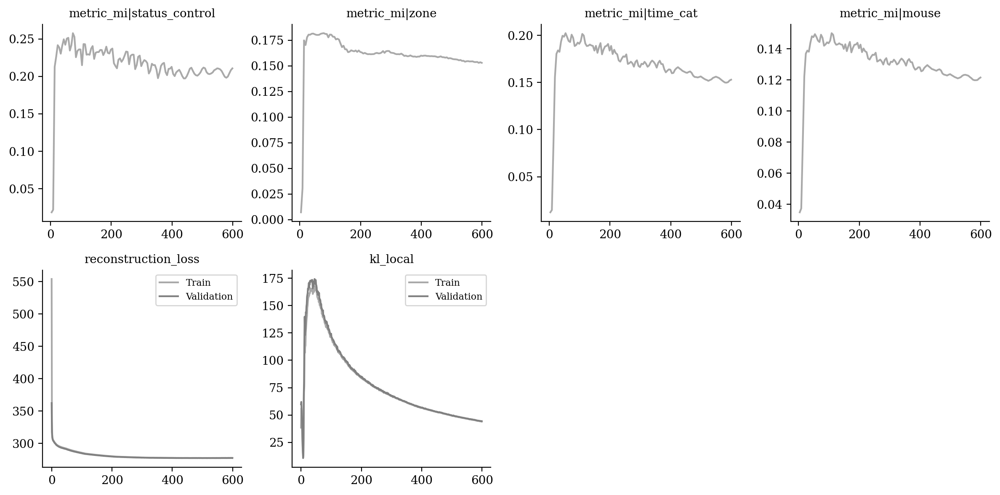

In [15]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [16]:
from tardis._disentanglementmanager import DisentanglementManager as DM

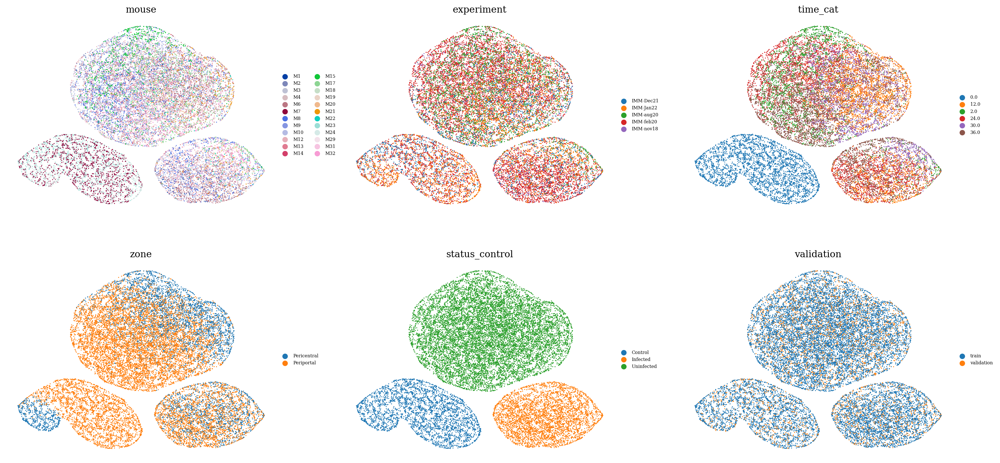

In [17]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

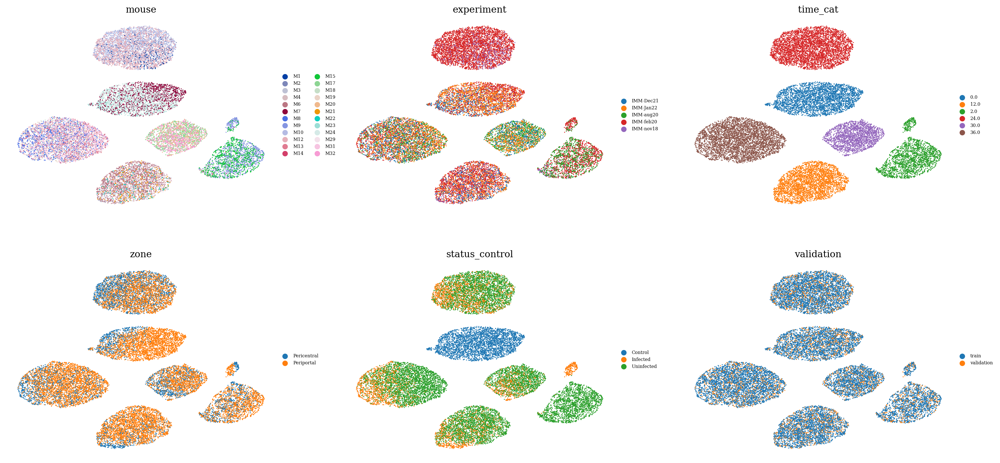

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

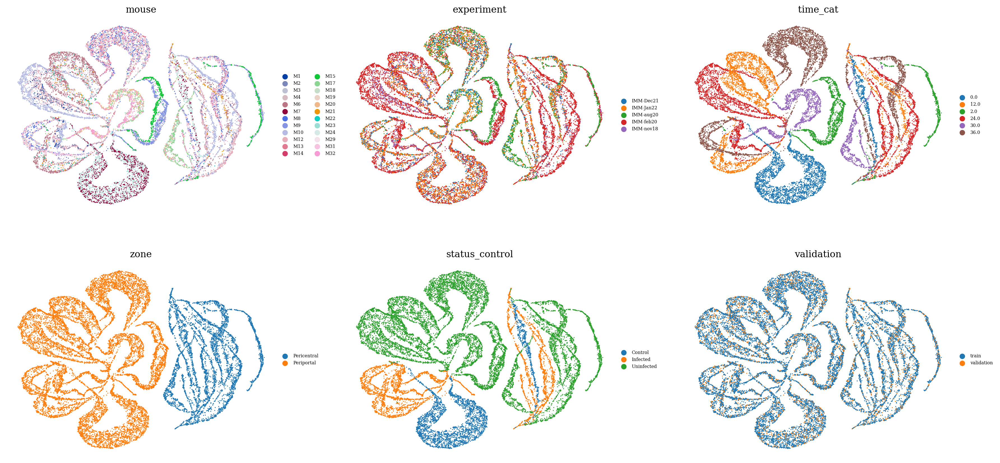

In [19]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

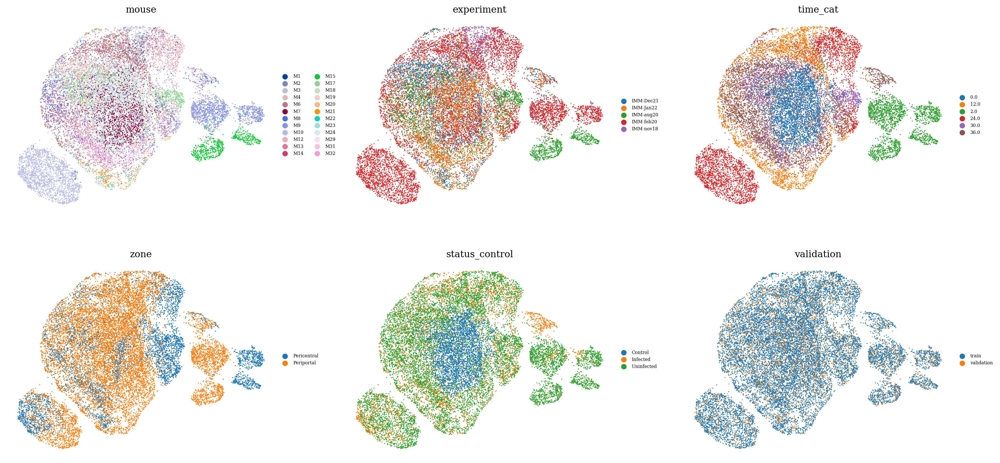

In [20]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

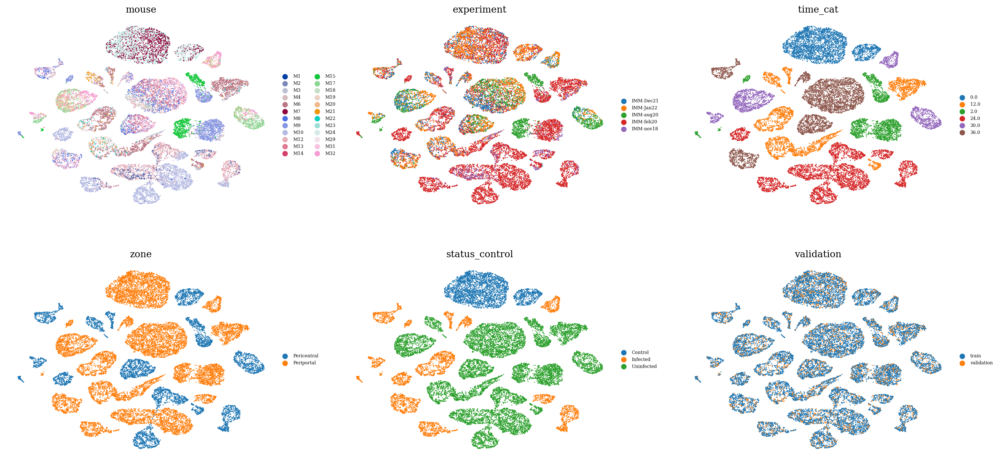

In [21]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8558266640336836

In [23]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8006088416999337

In [24]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9958253784031506,
 ('validation', 'unreserved'): 0.16292236931838655,
 ('train', 'reserved'): 0.995841774314163,
 ('train', 'unreserved'): 0.1171590146268044}

In [25]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.9949122277042339,
 ('validation', 'unreserved'): 0.24163714986188972,
 ('train', 'reserved'): 0.9930416524249079,
 ('train', 'unreserved'): 0.18568539014115693}

In [26]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9537587474503864,
 ('validation', 'unreserved'): 0.24104987633070687,
 ('train', 'reserved'): 0.9486237831950318,
 ('train', 'unreserved'): 0.16593244211405794}